In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import requests
import scipy
from scipy.optimize import curve_fit
import random
from scipy.stats.stats import pearsonr 

from sklearn.svm import SVR

## Indicator: SP.POP.TOTL

In [31]:
seed = 'http://api.worldbank.org/v2/country/all/indicator/SP.POP.TOTL?format=json'
#seed = 'http://api.worldbank.org/v2/country/all/indicator/SH.HIV.0014;SH.DYN.MORT?source=2&format=json'
response_seed = requests.get(seed).json()
df = pd.DataFrame.from_dict(response_seed[1])

In [32]:
# response_seed

In [33]:
%%time
for page in range(2, response_seed[0]['pages']+1): 
#for page in range(2, 50): 
    url = 'http://api.worldbank.org/v2/country/all/indicator/SP.POP.TOTL?page='+str(page)+'&format=json'
    response = requests.get(url).json()
    df = df.append(pd.DataFrame.from_dict(response[1]), ignore_index=True)
    print(page)

2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
27

In [34]:
df.to_csv('data/df.csv', index=False)

In [10]:
df['date'] = df['date'].astype(float)

In [11]:
df.shape

(16200, 8)

In [35]:
# Countries
df_group = df.groupby(['countryiso3code', 'date'])['value'].sum().copy()

countries = df_group.index.get_level_values(0).unique()
print('No. Total countries: ', len(countries))

print('Min. date: ', df['date'].min(), ' year')

No. Total countries:  261
Min. date:  1960  year


In [36]:
df_group.to_csv('data/df_group.csv', index=True)

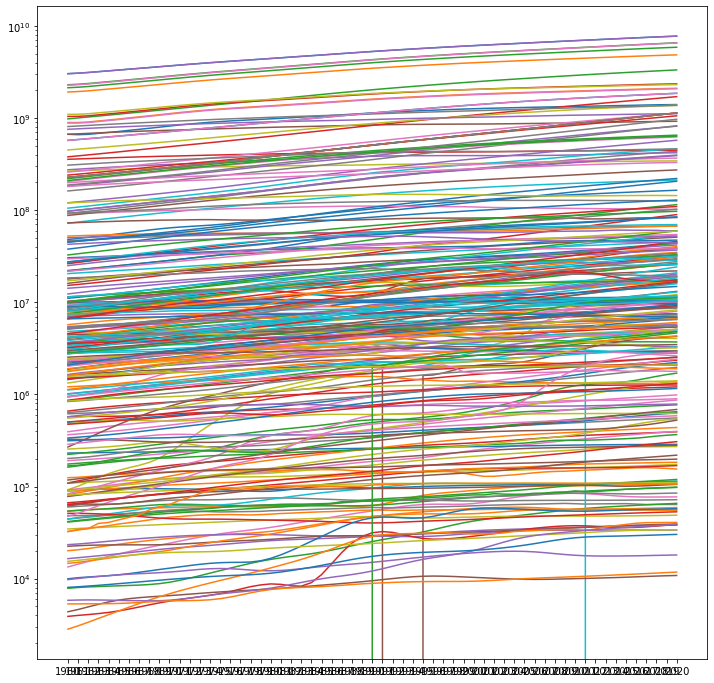

In [9]:
plt.figure(figsize=(12, 12))
for country in countries:
    plt.plot(df_group[country])
plt.yscale("log")
plt.show()

In this basis analysis and log plot, there is a lot of lines: almost all is a exponential behaviour. 

So, we going to model almost all using exp(t) using 
1. all the avialable data
2. last 10 years 
and explore the R2: how good to the model it is. 

It is possible:

3. normalize the data using «total area» per country 
4. Correlations in time with «money», «fertiluty» and «migrations»

## 1. Explore the Exp(t) model

[0.04661726]


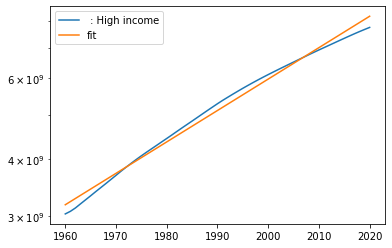

[0.37095472]


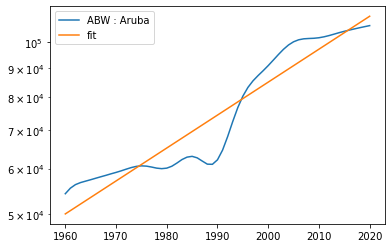

[0.00247299]


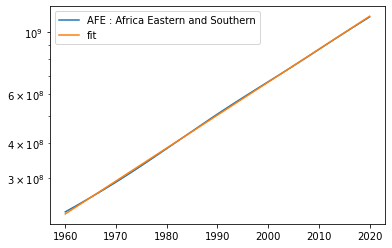

[0.96171307]


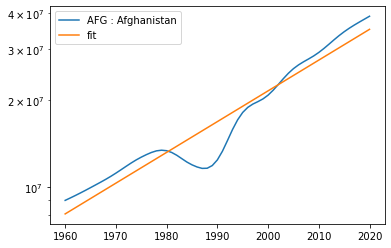

[0.17027351]


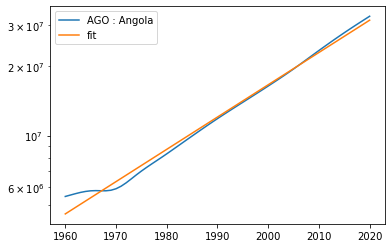

[0.96479898]


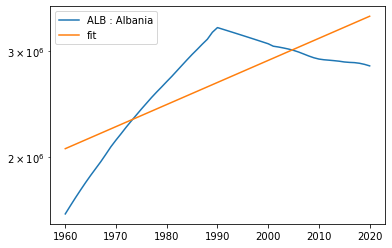

[1.48974578]


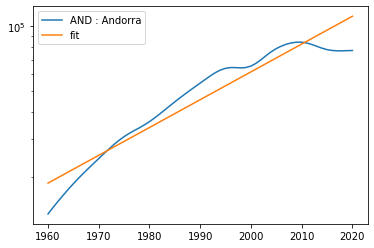

[0.06197127]


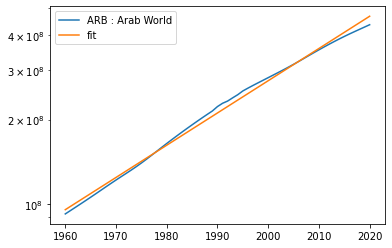

[3.93302948]


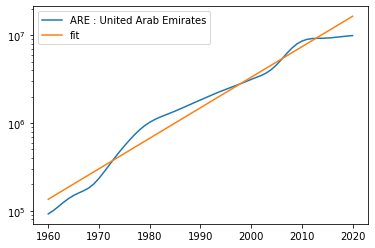

[0.02777758]


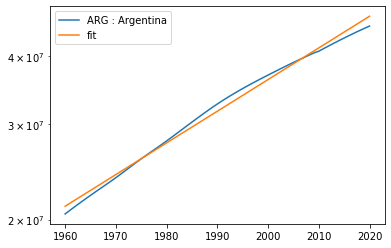

[0.95072126]


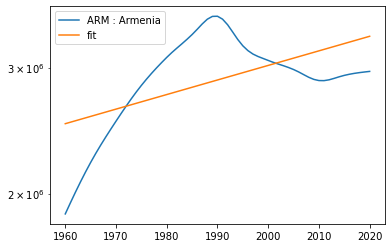

[0.87151937]


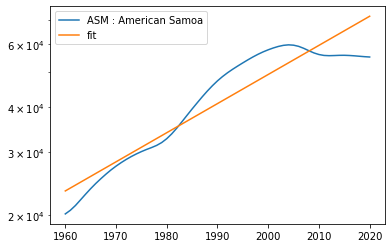

[0.22636062]


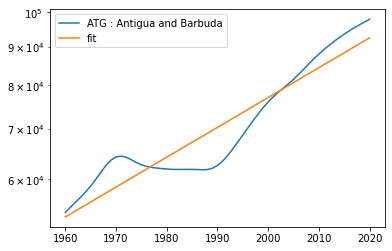

[0.02253195]


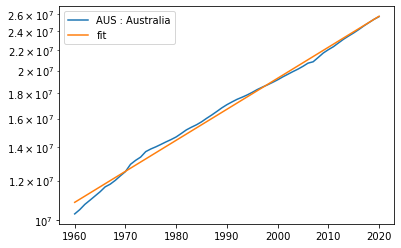

[0.01216451]


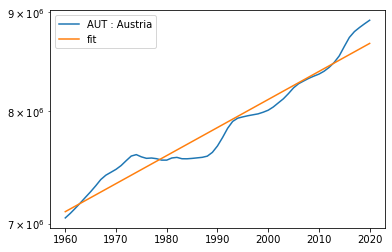

[0.09888712]


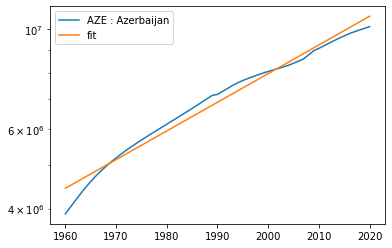

[0.08377232]


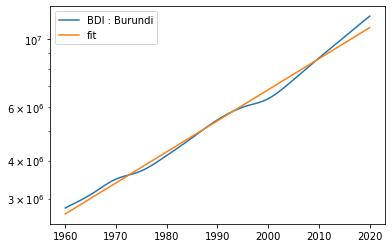

[0.01677384]


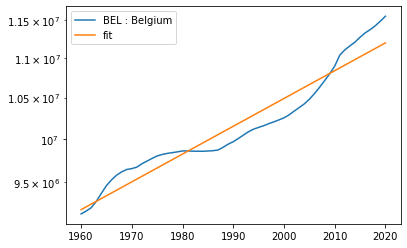

[0.06226763]


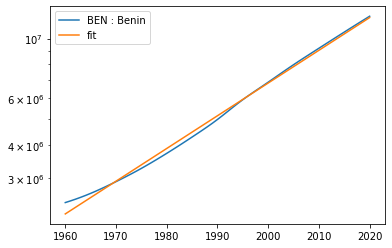

[0.11590332]


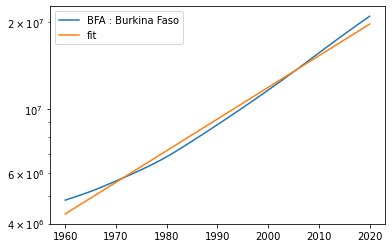

[0.13366621]


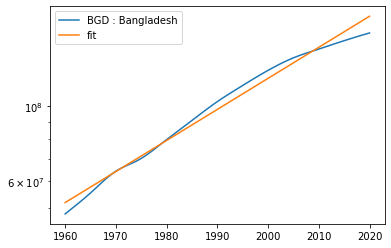

[0.19278223]


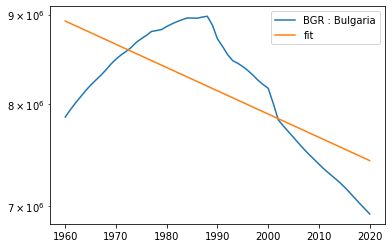

[0.21961402]


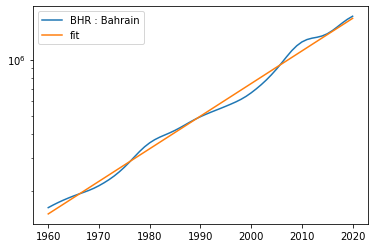

[0.24234687]


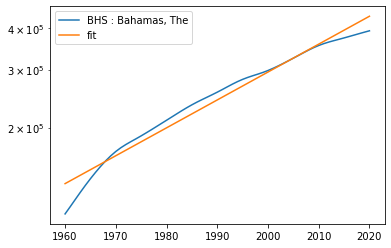

[0.48242217]


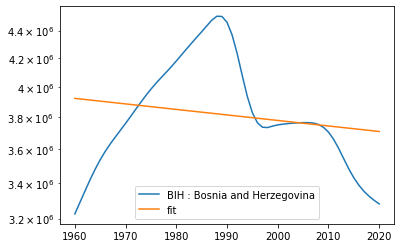

[0.13958475]


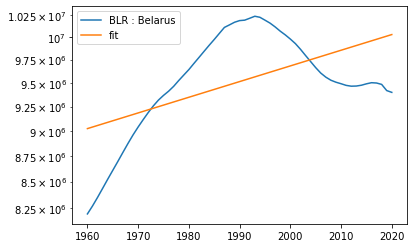

[0.04338783]


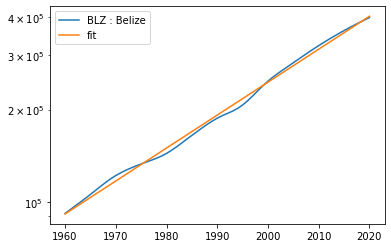

[0.05582654]


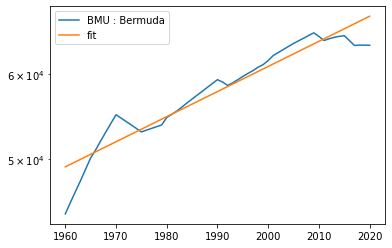

[0.01925727]


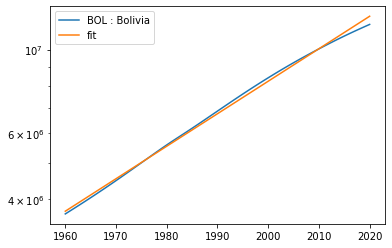

[0.19830012]


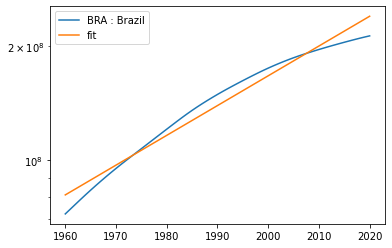

[0.00182103]


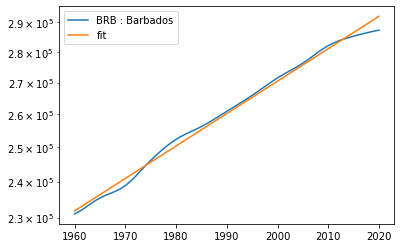

[0.65110952]


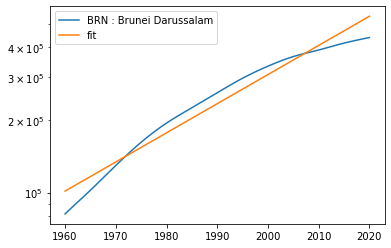

[0.32059975]


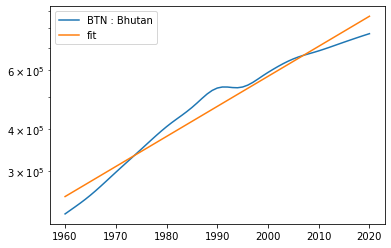

[0.25865272]


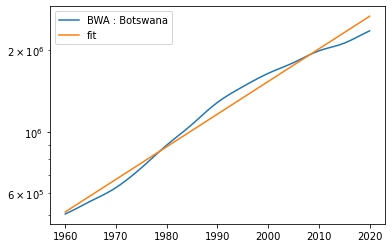

[0.08565046]


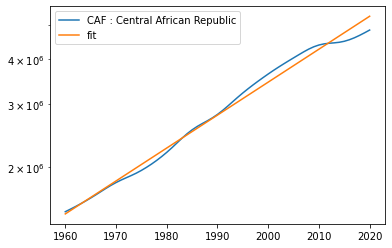

[0.02342861]


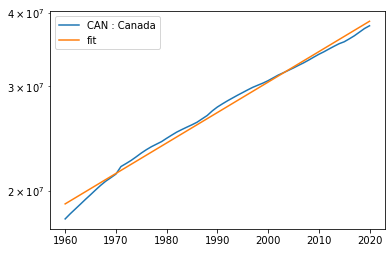

[0.11501144]


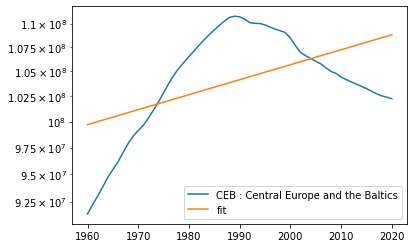

[0.02610755]


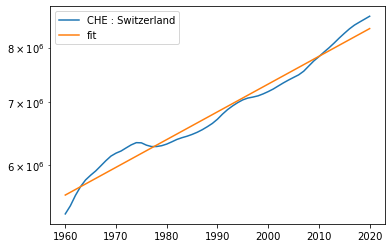

[0.0058519]


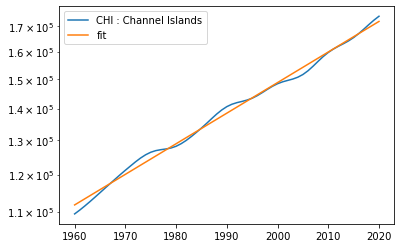

[0.02589498]


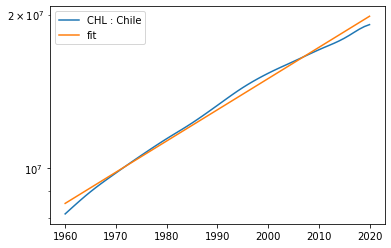

[0.19994968]


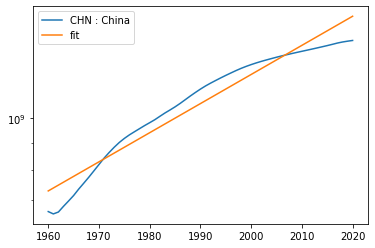

[0.36422547]


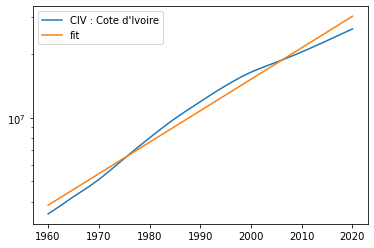

[0.01150266]


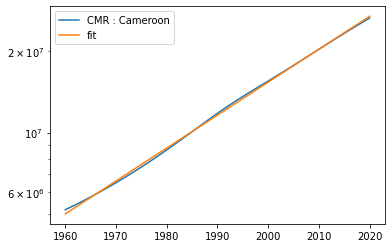

[0.02250006]


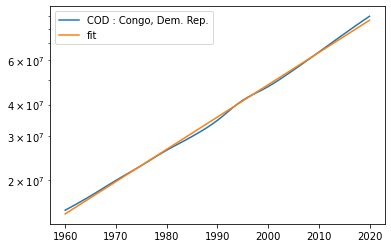

[0.00330587]


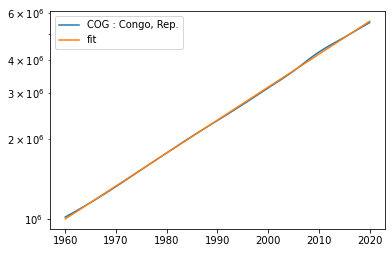

[0.13085651]


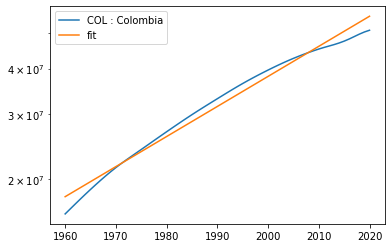

[0.03701371]


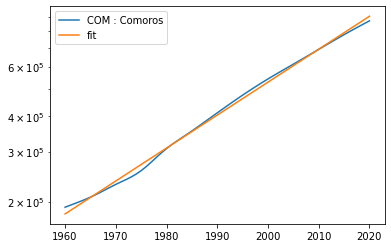

[0.06563324]


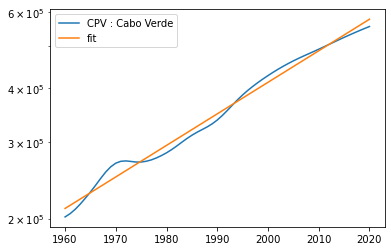

[0.19657256]


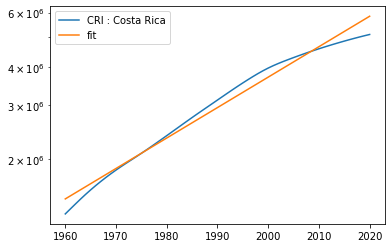

[0.03259131]


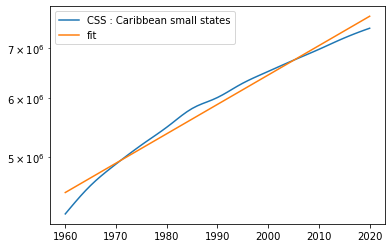

[0.16222802]


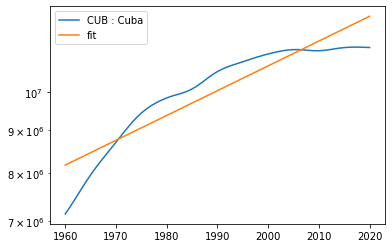

[0.17087874]


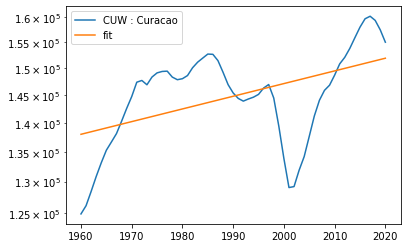

[0.53876009]


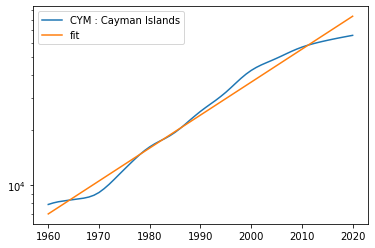

[0.07292708]


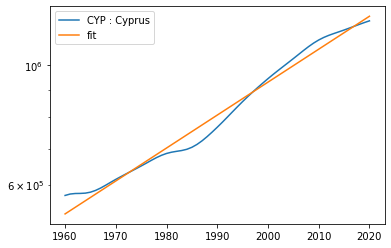

[0.0103987]


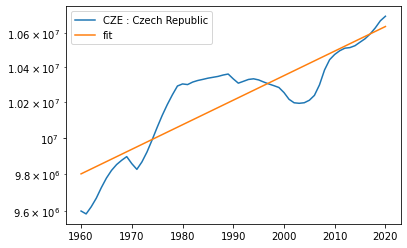

[0.01370843]


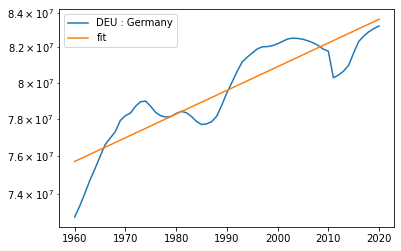

[3.06458735]


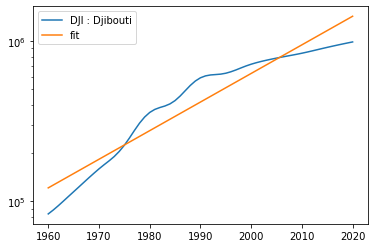

[0.11157721]


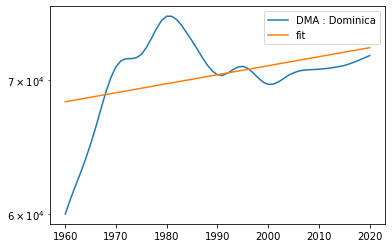

[0.00960896]


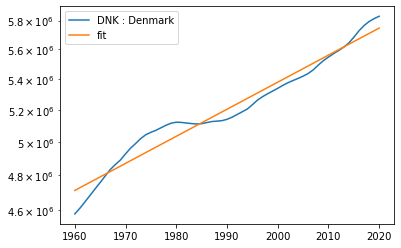

[0.18547055]


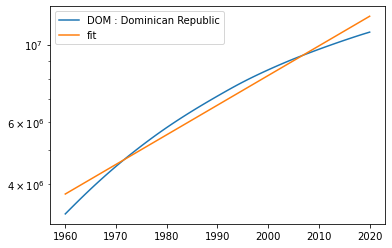

[0.17483545]


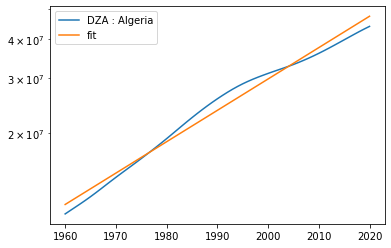

[0.17791263]


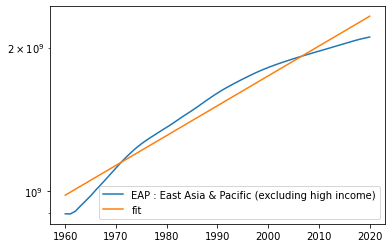

[0.08241653]


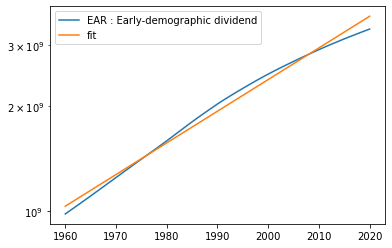

[0.16524498]


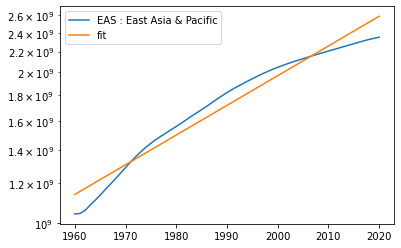

[0.09072317]


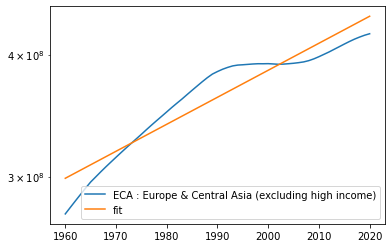

[0.02818914]


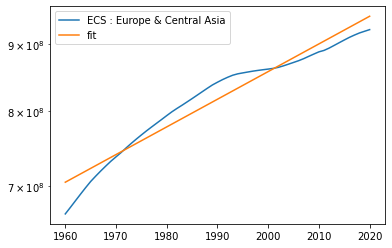

[0.11660332]


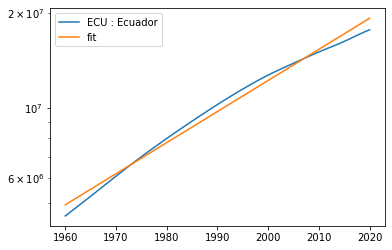

[0.02722901]


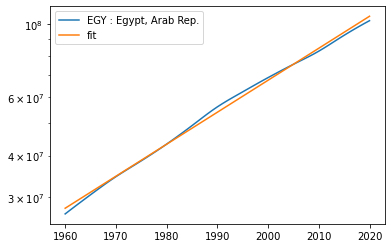

[0.00748612]


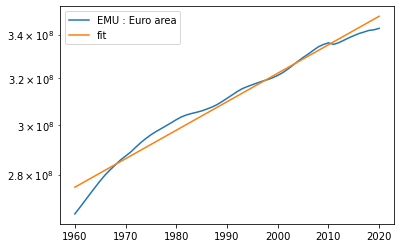

[0.0288574]


<ipython-input-98-8f317125e4ff>:10: RuntimeWarning: divide by zero encountered in log
  parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)


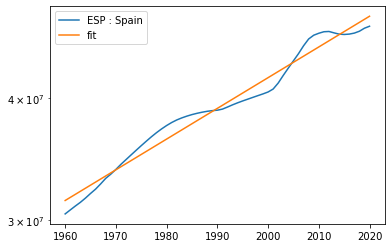

[0.25930004]


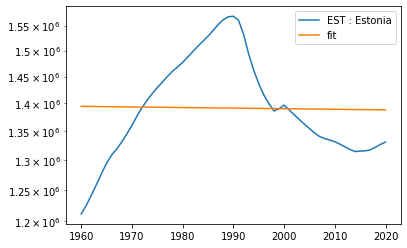

[0.04600147]


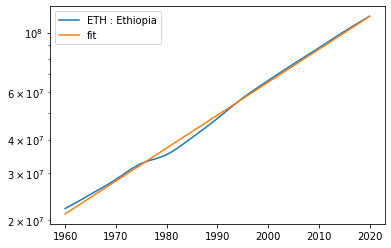

[0.01588333]


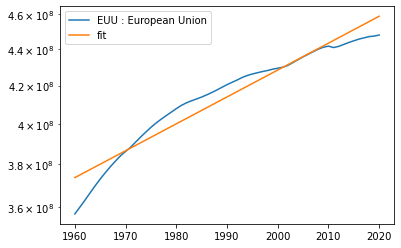

[0.00263186]


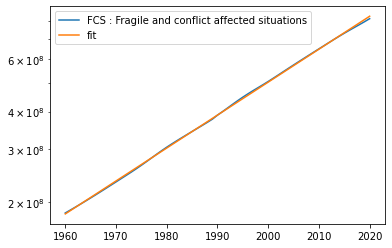

[0.00081225]


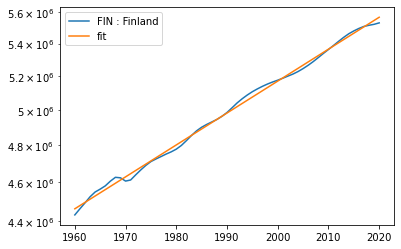

[0.28520482]


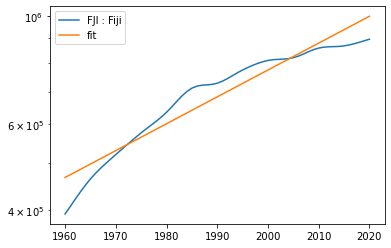

[0.00826445]


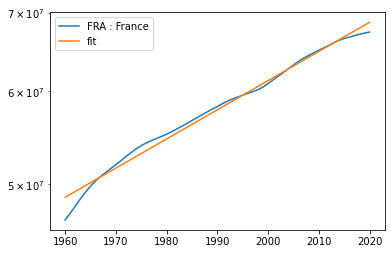

[0.09851403]


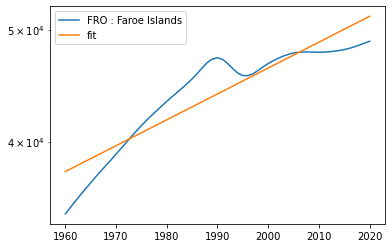

[0.65145775]


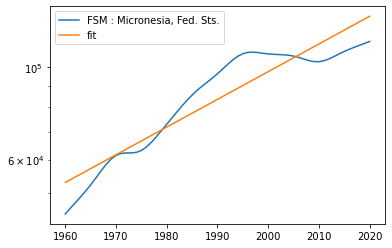

[0.08535309]


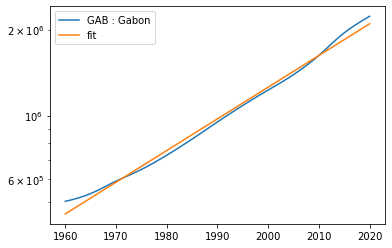

[0.02172531]


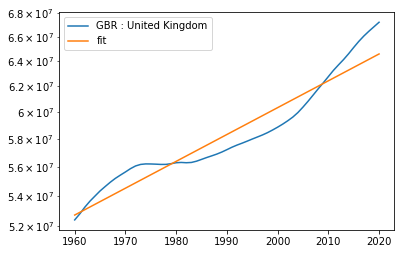

[0.47254721]


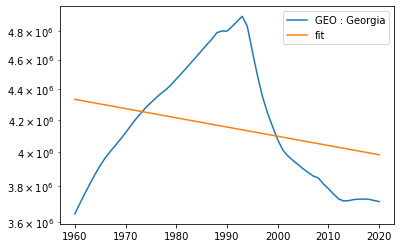

[0.00879802]


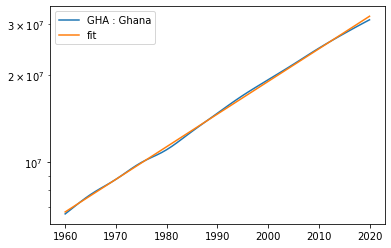

[0.11603785]


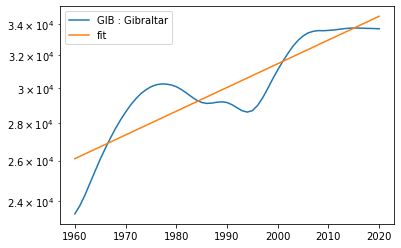

[0.05554003]


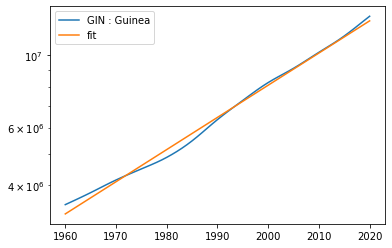

[0.0529667]


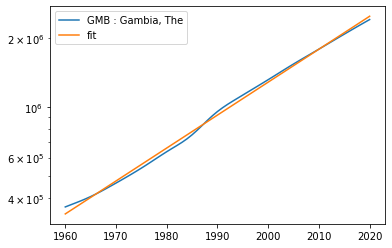

[0.1126452]


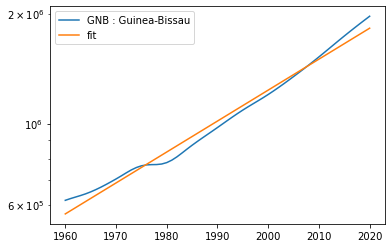

[1.7607314]


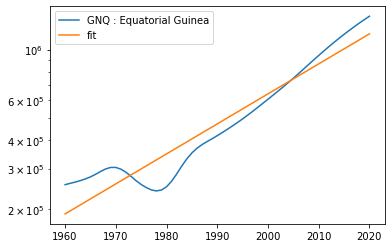

[0.05533575]


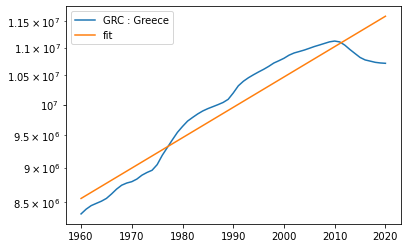

[0.04193064]


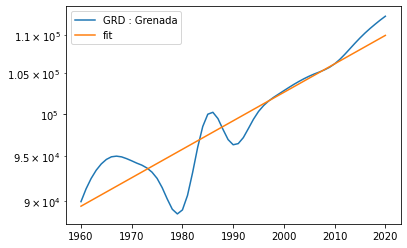

[0.3898065]


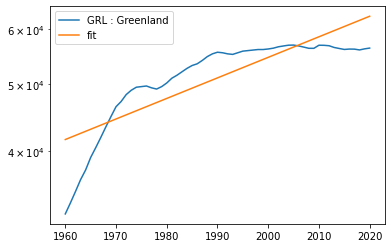

[0.04075558]


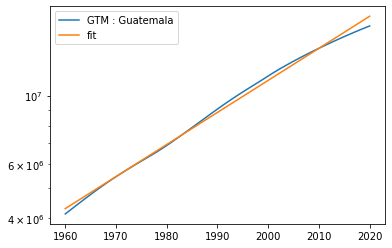

[0.34619007]


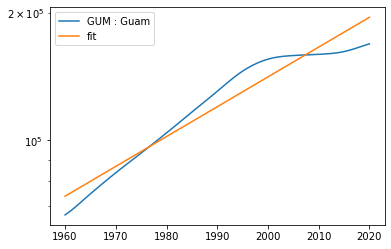

[0.16887061]


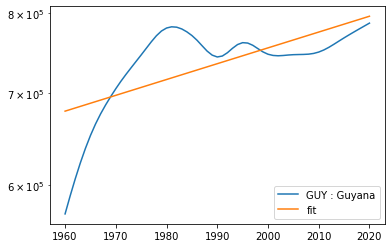

[0.22731101]


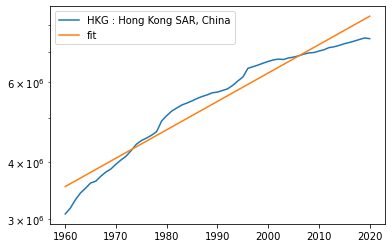

[0.07188723]


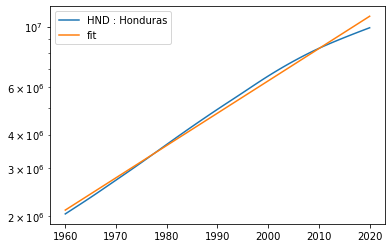

[0.00524794]


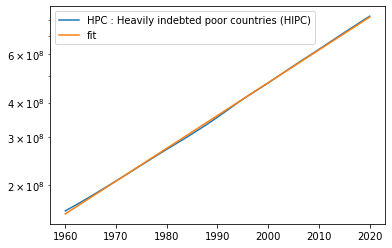

[0.11098681]


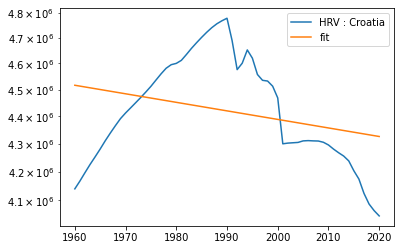

[0.02440039]


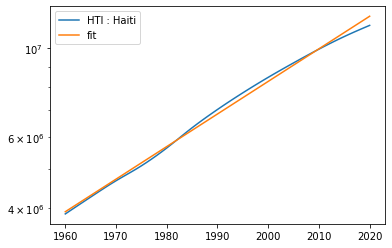

[0.03244313]


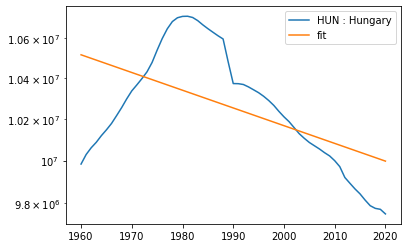

[0.1080879]


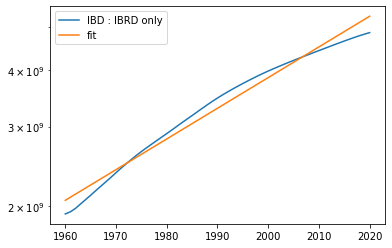

[0.06986221]


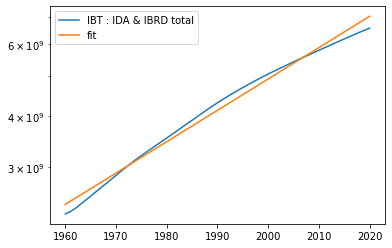

[0.0110335]


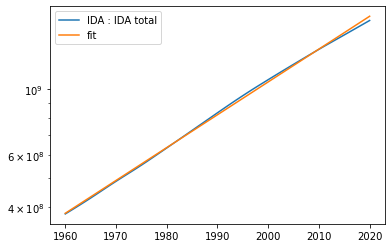

[0.02764405]


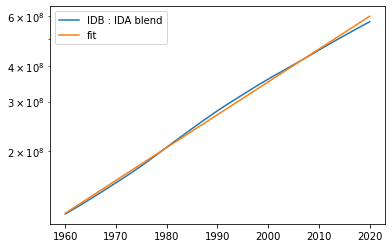

[0.15241228]


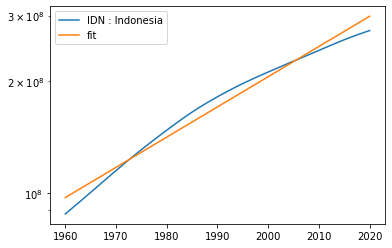

[0.00684599]


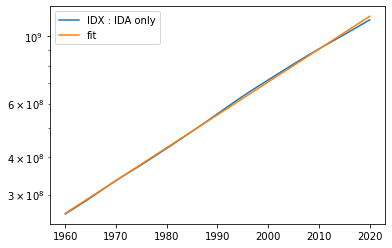

[0.06535023]


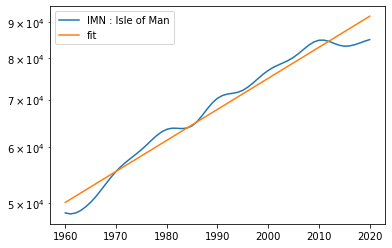

[0.07047772]


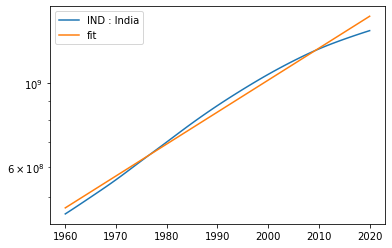

[0.05504603]


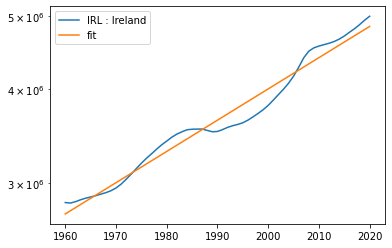

[0.46569678]


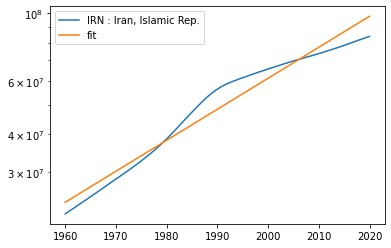

[0.02424077]


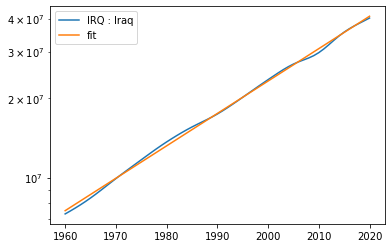

[0.00948482]


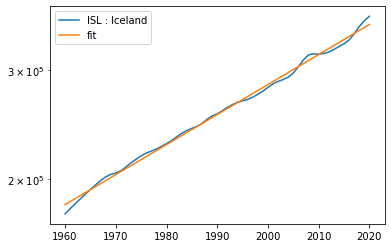

[0.06738663]


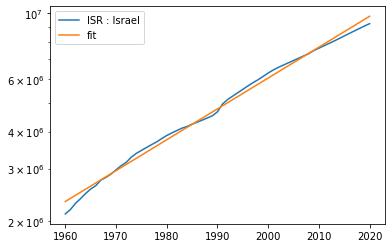

[0.01578032]


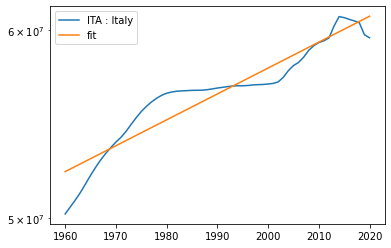

[0.06724354]


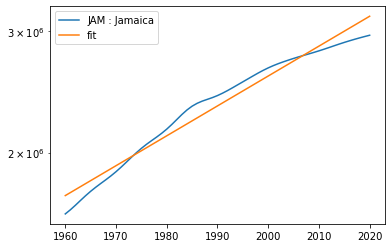

[0.25488256]


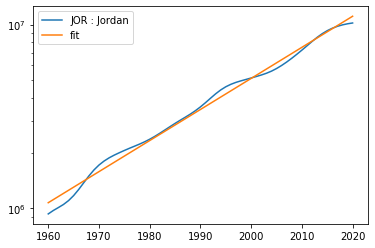

[0.11853633]


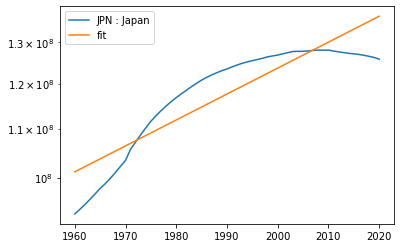

[0.29857807]


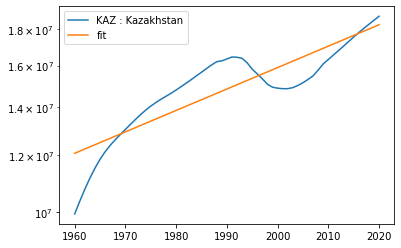

[0.10652149]


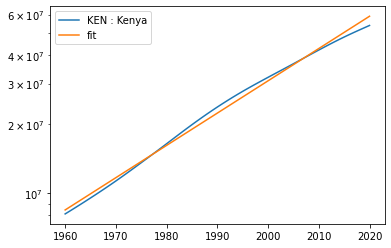

[0.13716959]


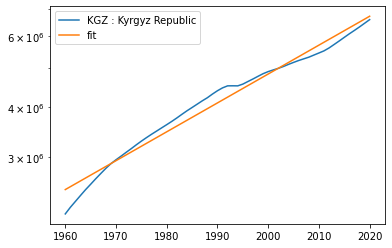

[0.32142839]


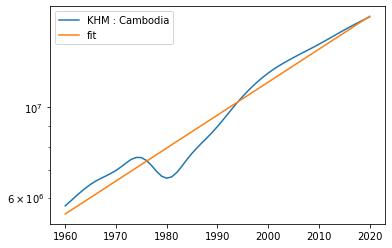

[0.00799635]


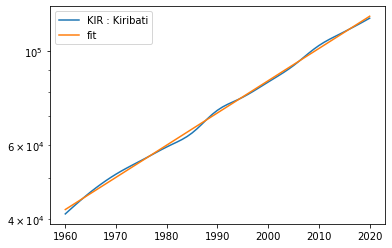

[0.37915071]


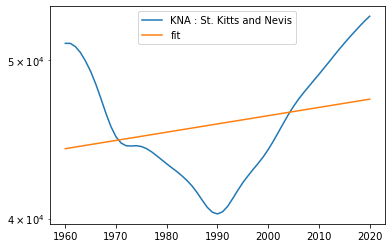

[0.183467]


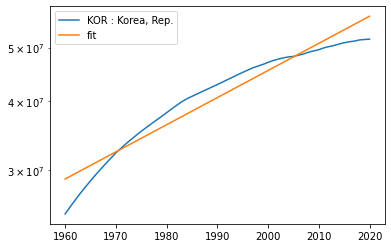

[0.14890888]


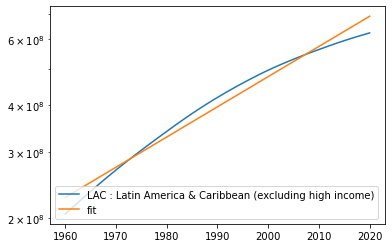

[0.05854383]


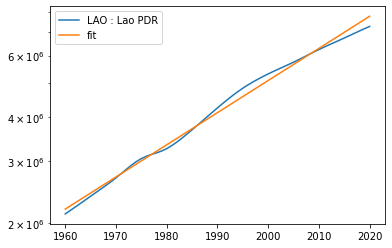

[0.43524963]


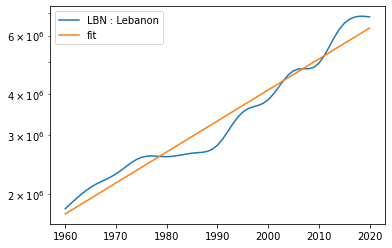

[0.35926988]


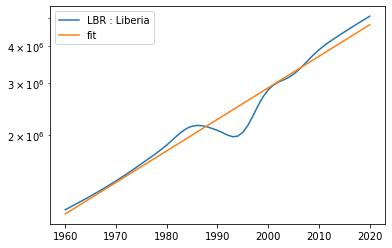

[0.78789668]


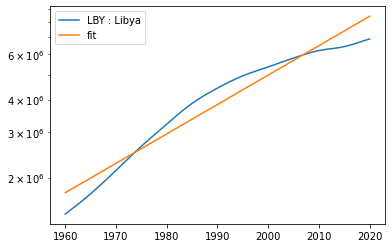

[0.03048661]


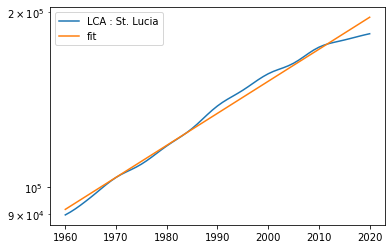

[0.13950872]


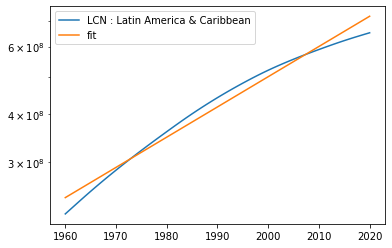

[0.00322584]


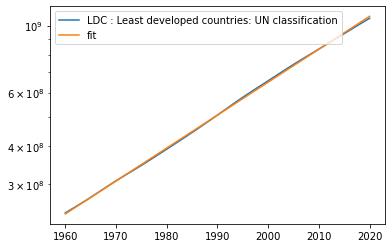

[0.14295195]


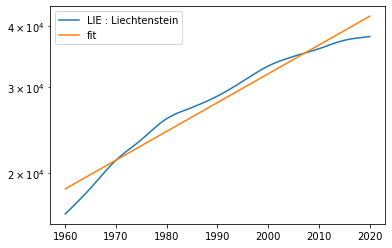

[0.16582594]


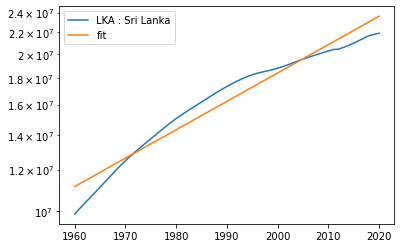

[0.07149482]


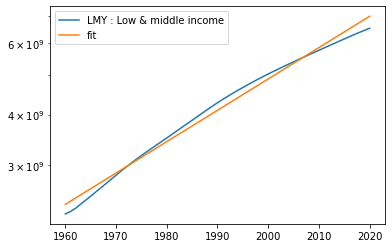

[0.51708897]


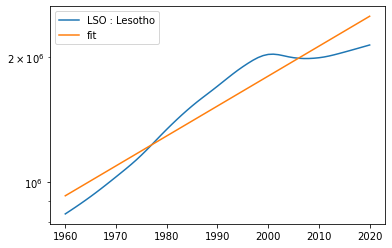

[0.15400272]


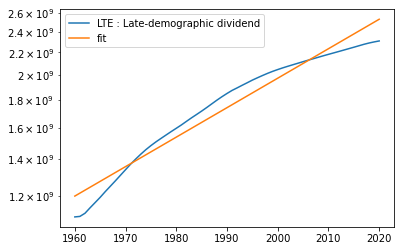

[0.4853689]


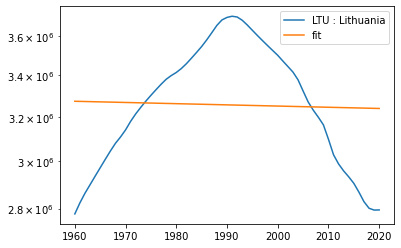

[0.15642119]


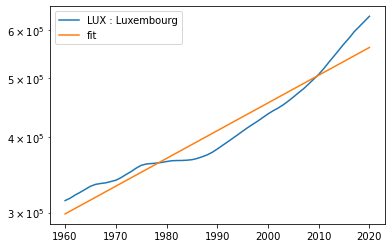

[0.41757322]


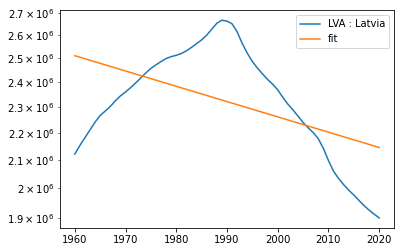

[0.20493773]


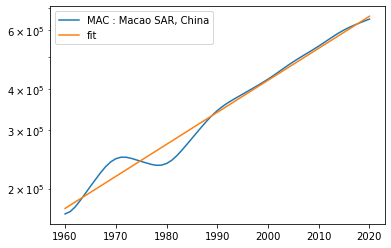

[4.62607259]


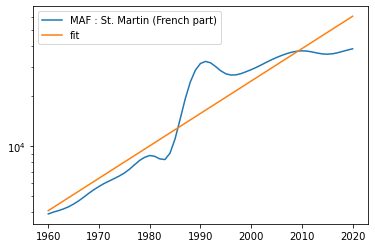

[0.12931292]


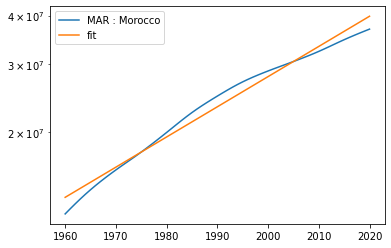

[0.01186411]


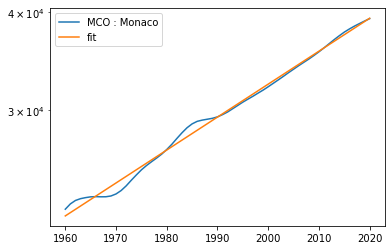

[0.28924586]


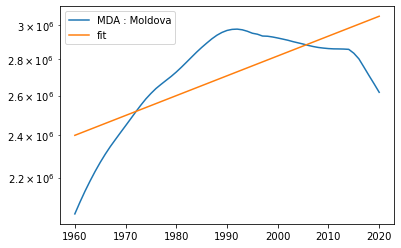

[0.00700897]


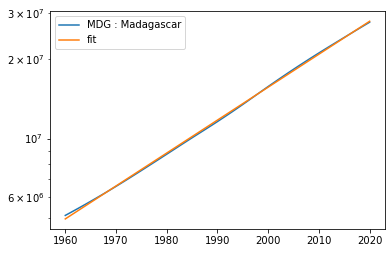

[0.05572591]


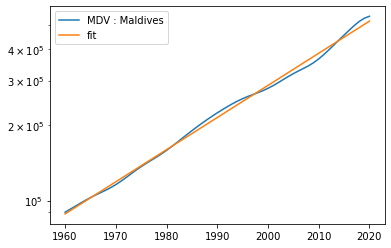

[0.1087557]


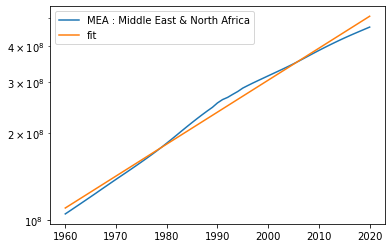

[0.20924795]


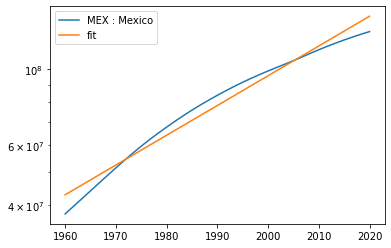

[1.28445714]


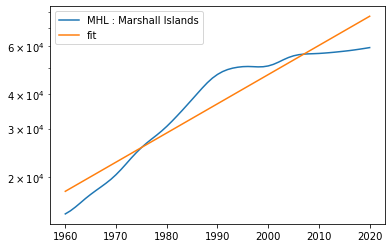

[0.09149752]


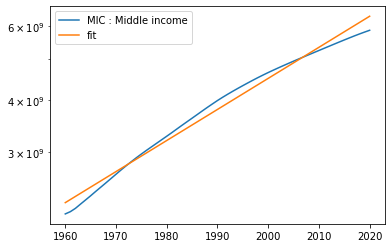

[0.11125866]


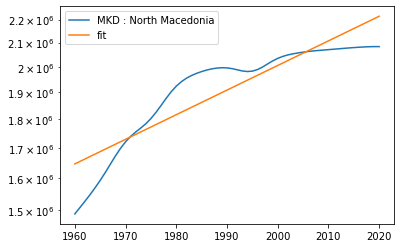

[0.22181676]


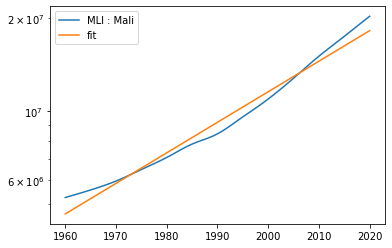

[0.15039746]


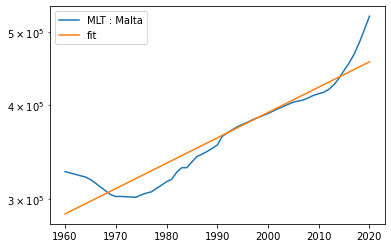

[0.21019871]


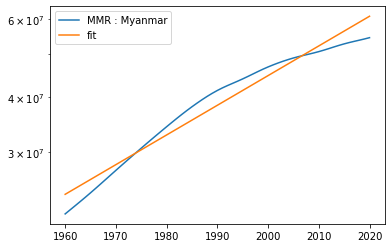

[0.1195767]


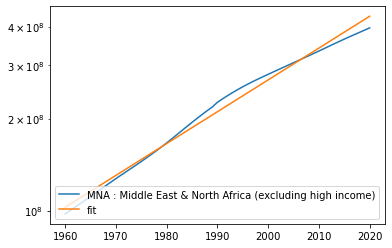

[0.06649849]


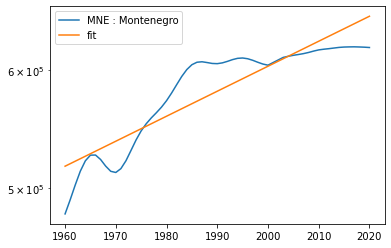

[0.26754464]


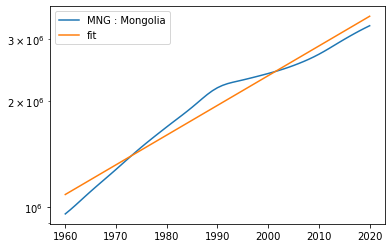

[3.19762947]


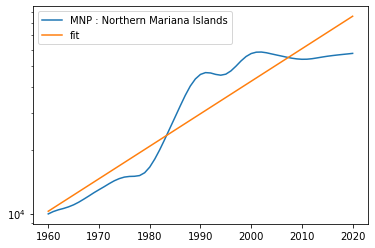

[0.08666348]


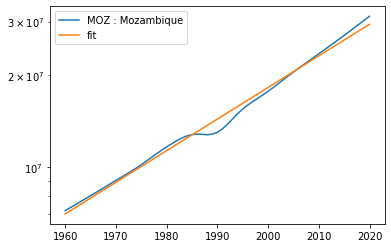

[0.00709884]


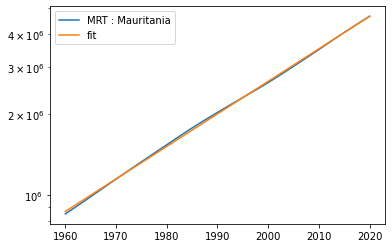

[0.13859594]


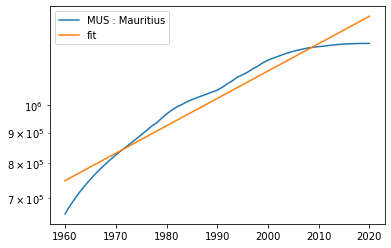

[0.06855669]


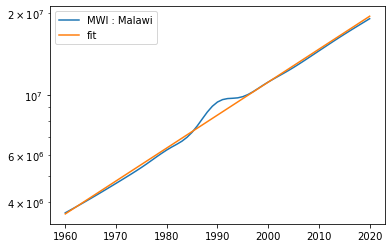

[0.0679473]


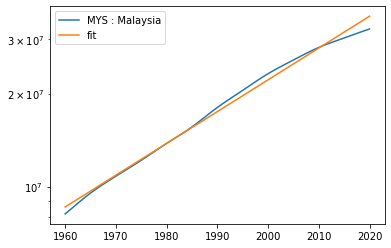

[0.00636509]


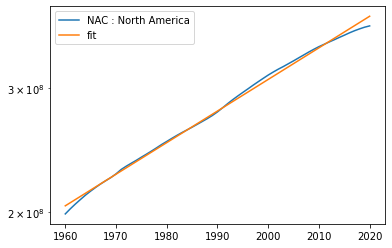

[0.10368518]


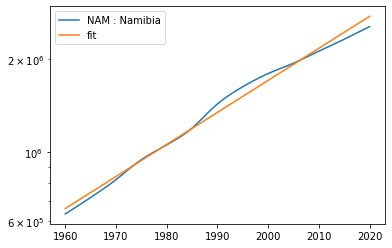

[0.22081979]


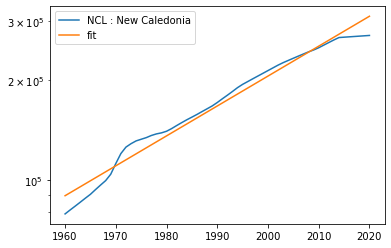

[0.0902204]


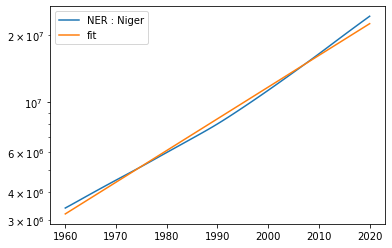

[0.00469992]


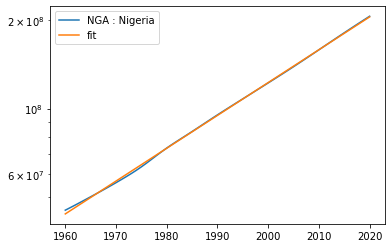

[0.25677895]


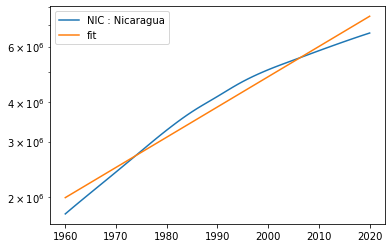

[0.02412244]


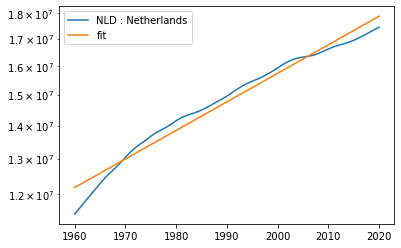

[0.02085216]


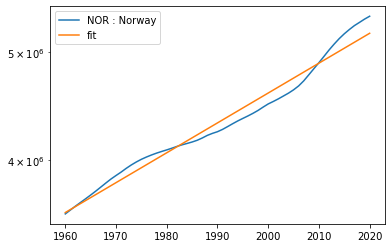

[0.16398885]


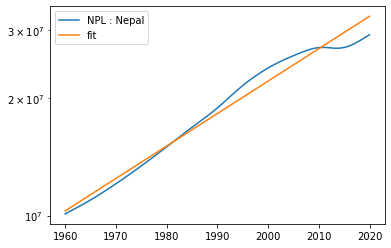

[0.61250891]


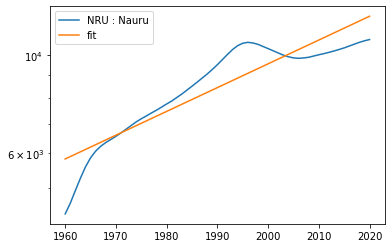

[0.026213]


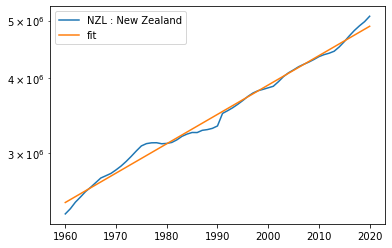

[0.01518599]


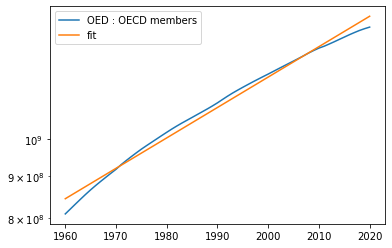

[0.38482228]


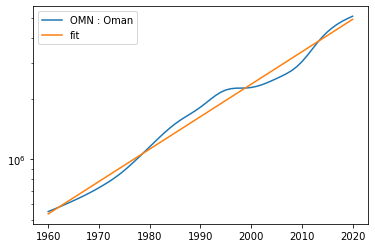

[0.00802826]


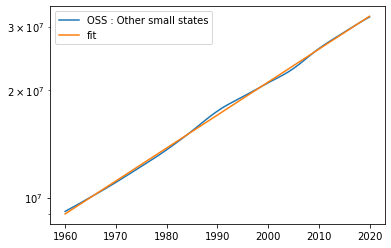

[0.05644976]


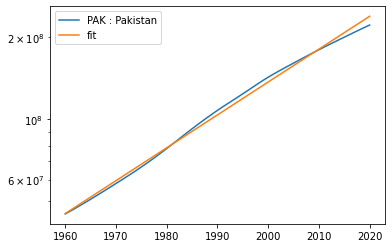

[0.07764213]


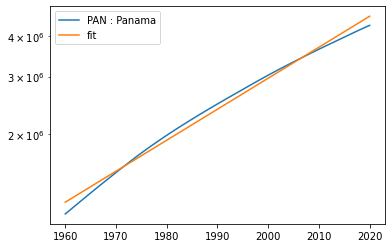

[0.25087451]


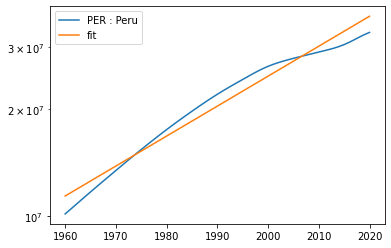

[0.11479208]


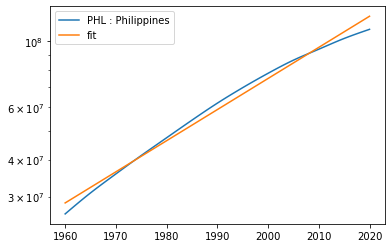

[0.38194308]


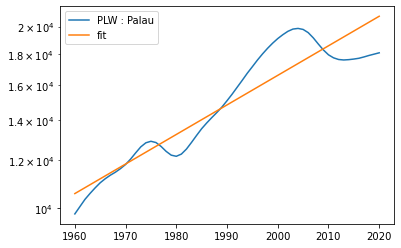

[0.01056737]


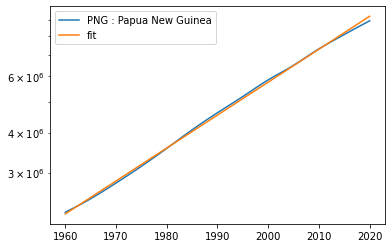

[0.09803204]


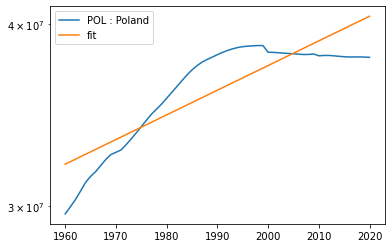

[0.00402216]


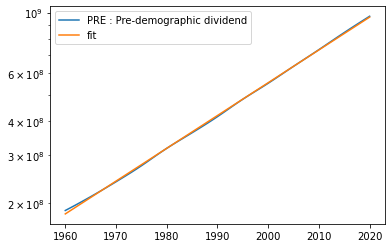

[0.43807269]


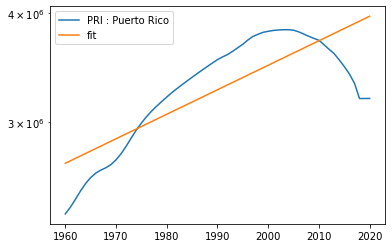

[0.20490219]


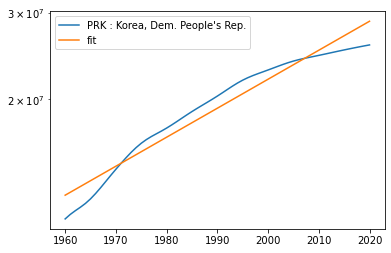

[0.05223872]


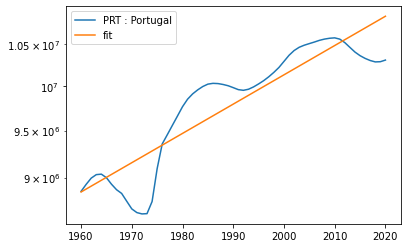

[0.12829906]


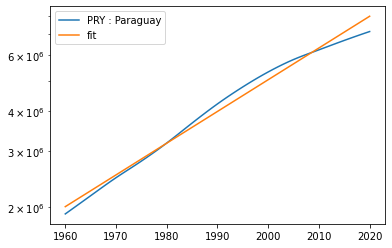

[0.12262891]


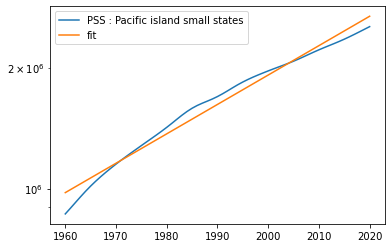

[0.01486008]


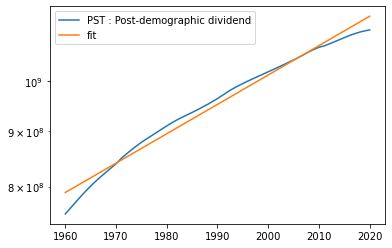

[0.55231462]


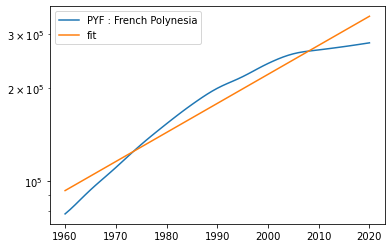

[1.63295534]


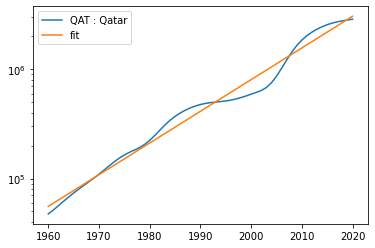

[0.28171879]


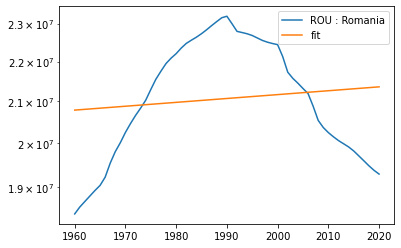

[0.07980814]


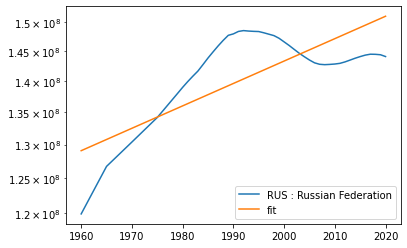

[0.32028269]


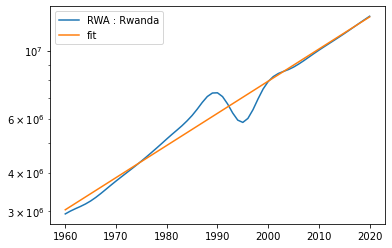

[0.06300497]


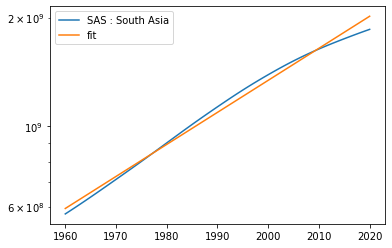

[0.62831076]


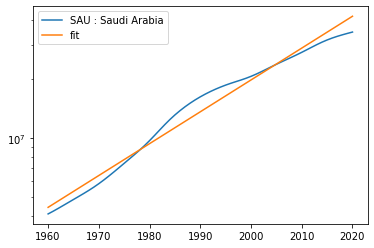

[0.10285589]


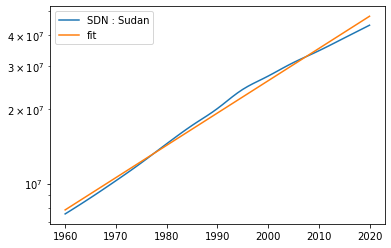

[0.00720032]


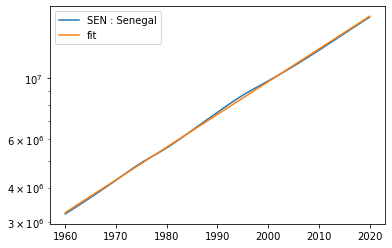

[0.05670066]


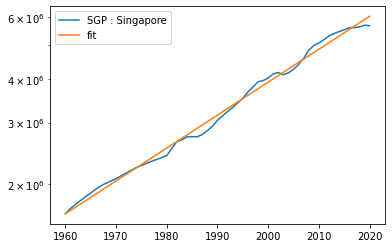

[0.07554021]


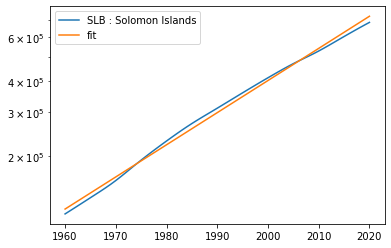

[0.09933544]


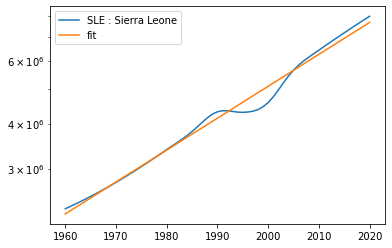

[0.32048103]


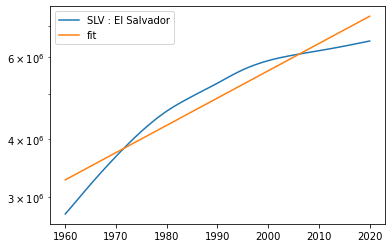

[0.01679596]


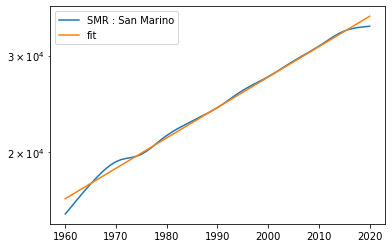

[0.45814504]


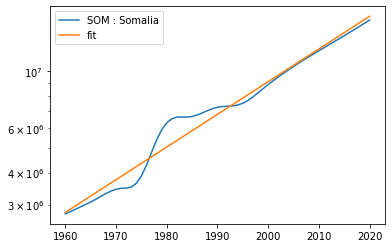

[0.08773742]


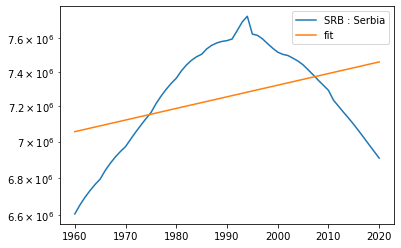

[0.00247633]


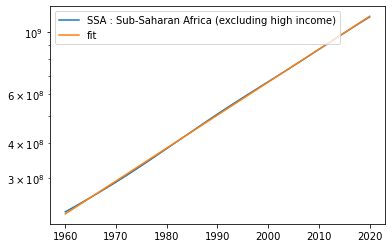

[0.33922669]


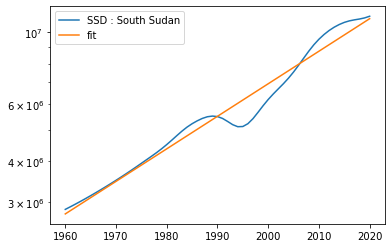

[0.00247299]


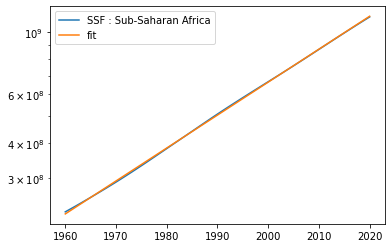

[0.0054219]


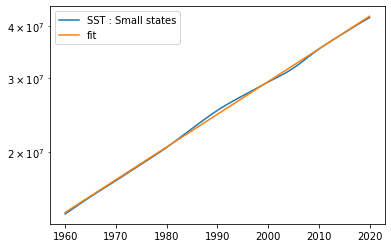

[0.02332484]


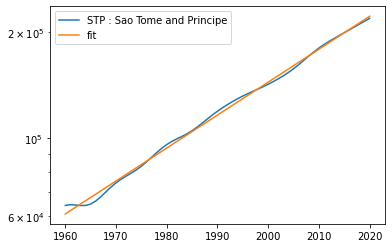

[0.09232126]


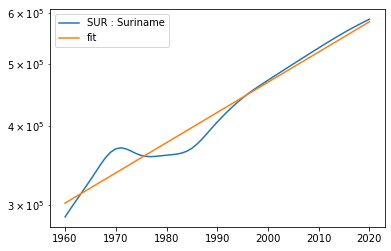

[0.07361289]


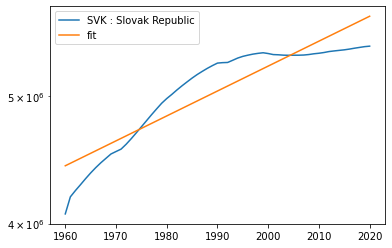

[0.05731385]


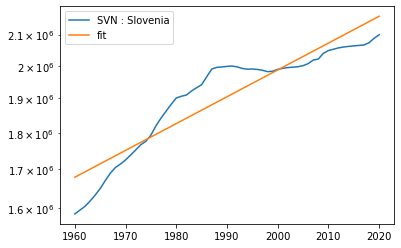

[0.01595844]


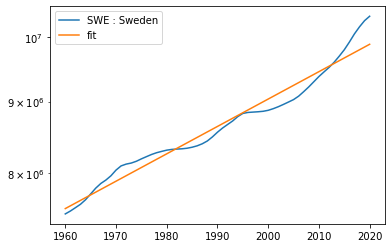

[0.58852859]


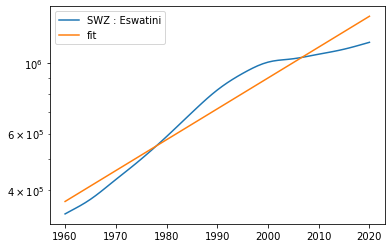

[4.87606364]


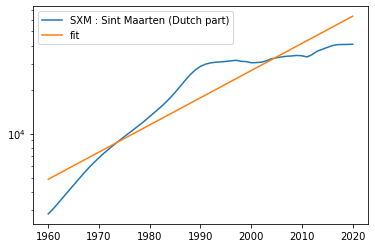

[0.08280754]


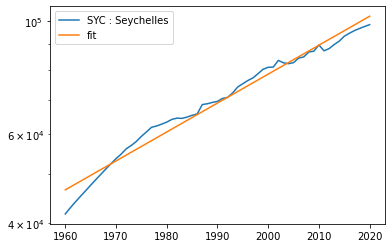

[0.93900412]


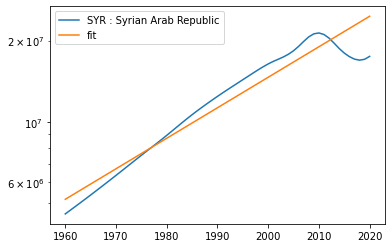

[0.84987796]


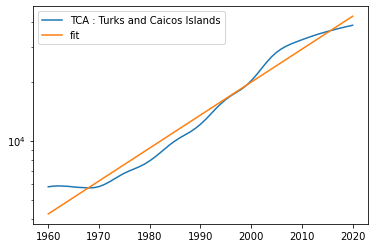

[0.19935753]


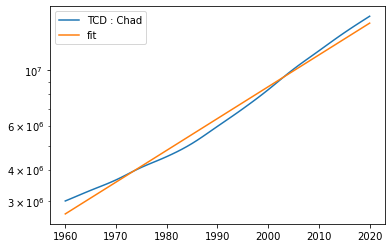

[0.17759555]


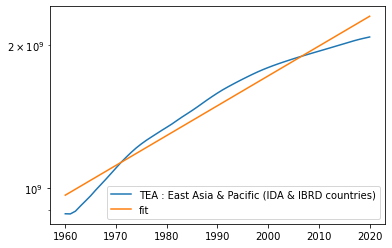

[0.09043762]


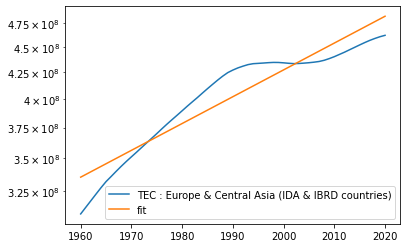

[0.02564621]


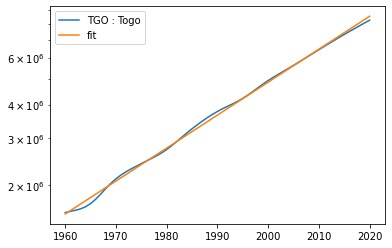

[0.3927471]


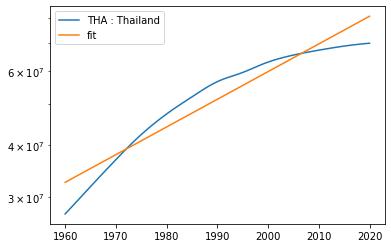

[0.15714497]


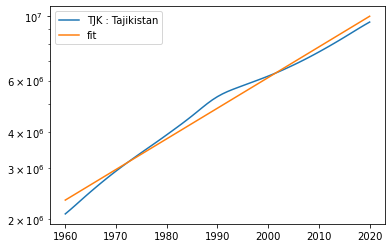

[0.20055447]


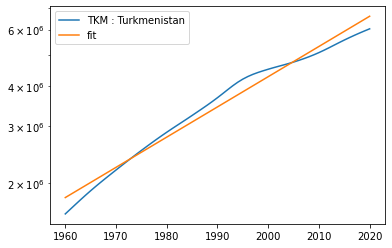

[0.14147163]


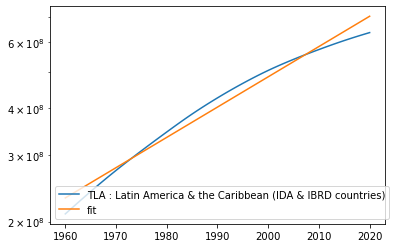

[0.09964143]


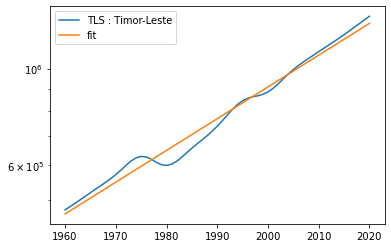

[0.11863359]


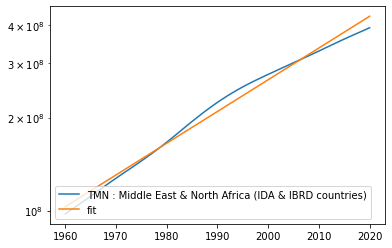

[0.22437727]


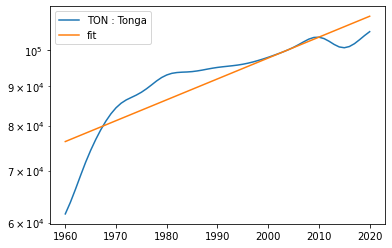

[0.06300497]


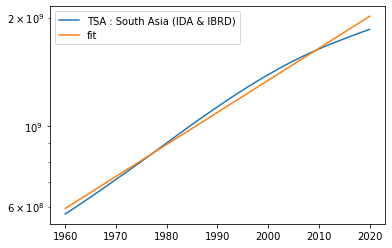

[0.00247299]


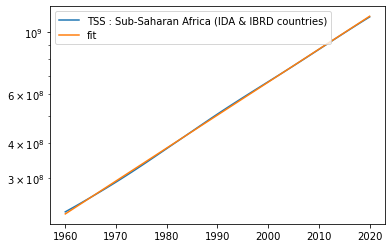

[0.07823379]


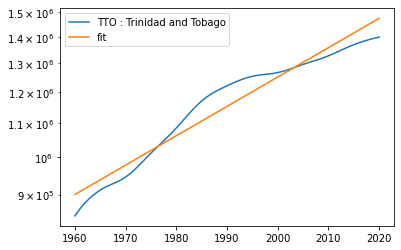

[0.20513775]


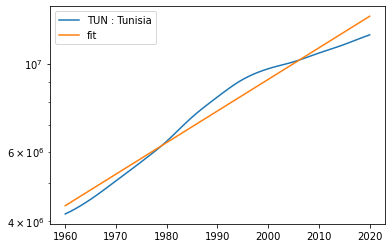

[0.08155961]


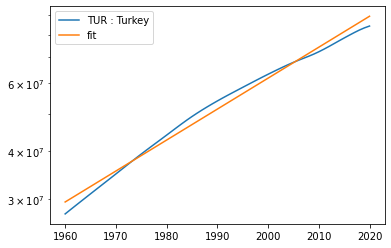

[0.20938054]


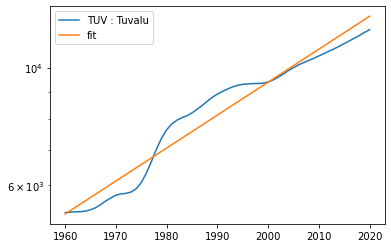

[0.01094691]


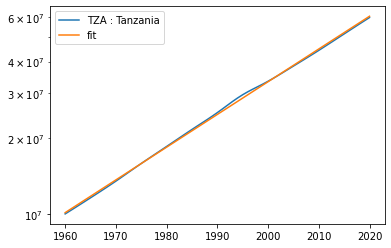

[0.00776437]


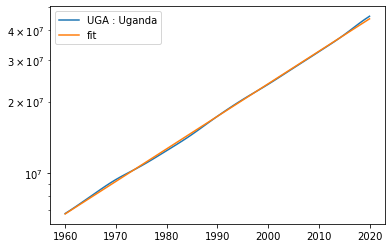

[0.18952542]


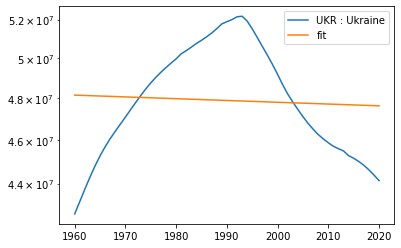

[0.0165193]


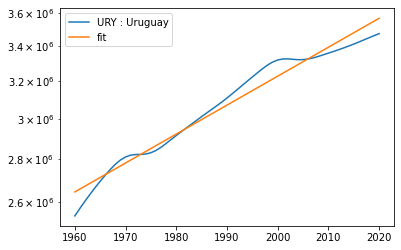

[0.00624405]


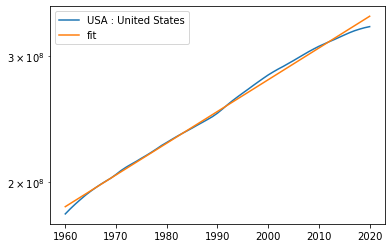

[0.20839124]


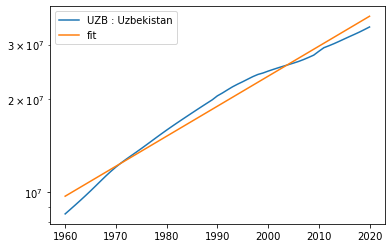

[0.1003529]


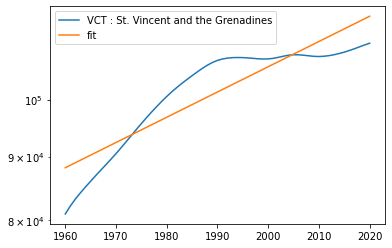

[0.33014441]


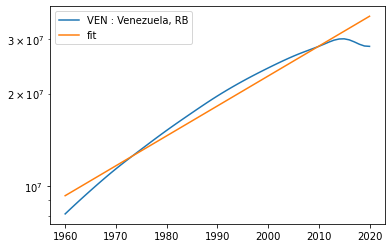

[0.150456]


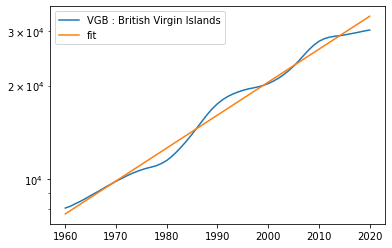

[2.91395136]


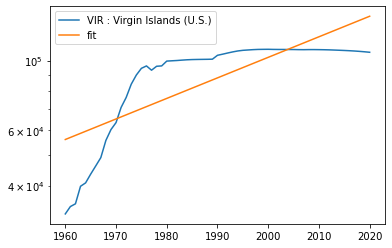

[0.20852809]


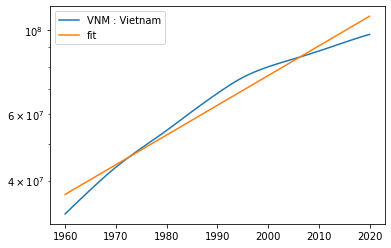

[0.02759129]


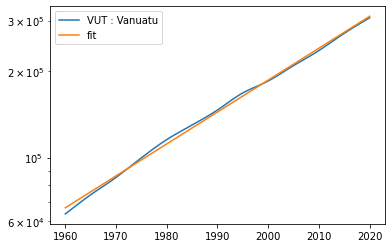

[0.04661726]


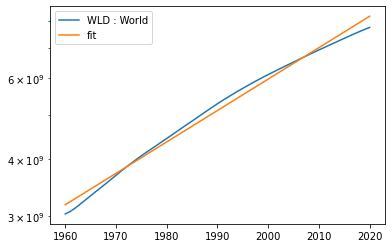

[0.11167779]


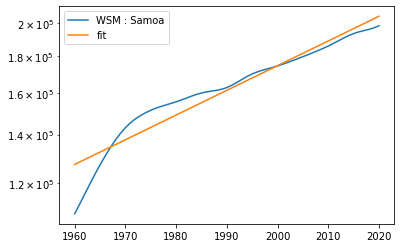

[0.88298507]


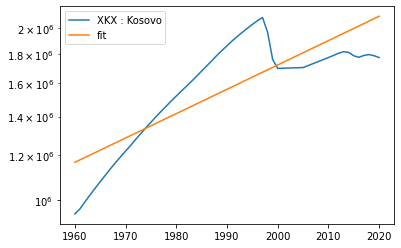

[0.22524918]


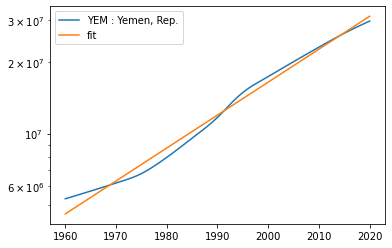

[0.1495937]


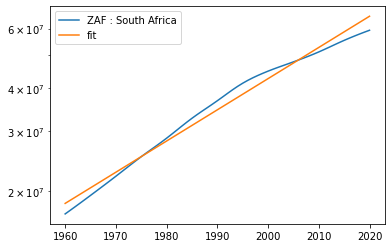

[0.03632367]


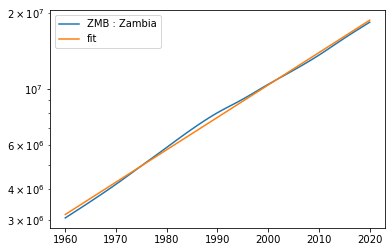

[0.02509985]


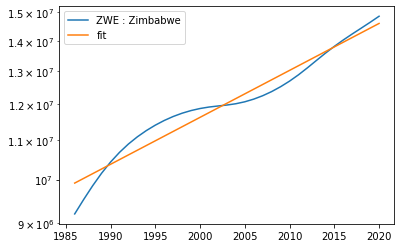

Pass_count total:  258


In [98]:
def fit_funtion(x, parameters):
    return np.exp(parameters[1])*np.exp(x*parameters[0])

pass_count = 0 
for country in countries[0:261]: 
    full_name_country = df[df['countryiso3code']==country]['country'].values[0]['value']
    x = df_group.loc[country].index.tolist()
    y = df_group.loc[country].values.tolist()
    
    parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)
    if res > 0: # 0.1, < 0 to plot all of them
        y_fit = [fit_funtion(x_i, parameters) for x_i in x] #https://stackoverflow.com/questions/3433486/how-to-do-exponential-and-logarithmic-curve-fitting-in-python-i-found-only-poly
        print(res)
        plt.plot(x,y, label = country + ' : ' + full_name_country)
        plt.plot(x, y_fit, label = 'fit')
        plt.yscale("log")
        plt.legend()
        plt.show()
        pass_count += 1
    
    # https://stackoverflow.com/questions/19189362/getting-the-r-squared-value-using-curve-fit
print('Pass_count total: ', pass_count)
print('Pass_count total (%): ', pass_count*100/len(countries))

## 2. Explore the Exp(t) model last 20 years

In [45]:
# Countries
df_group = df[df['date']>=2000].groupby(['countryiso3code', 'date'])['value'].sum().copy()

countries = df_group.index.get_level_values(0).unique()
print('No. Total countries: ', len(countries))

print('Min. date: ', df['date'].min(), ' year')

No. Total countries:  261
Min. date:  1960.0  year


[5.70039826e-05]


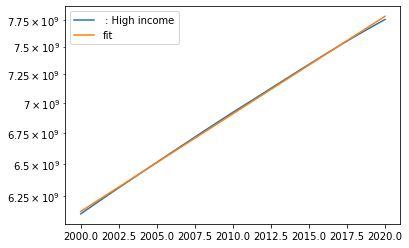

[0.00485602]


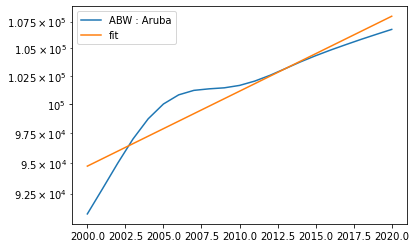

[1.70045617e-05]


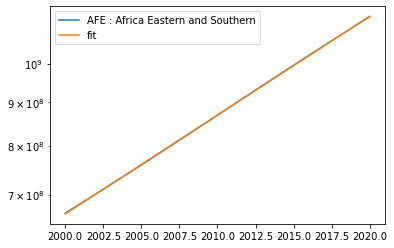

[0.00453174]


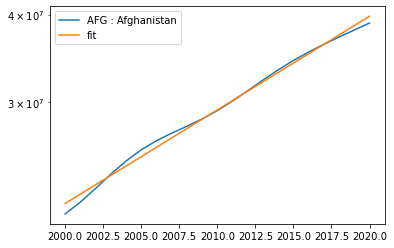

[0.00029462]


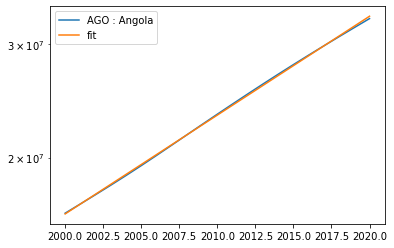

[0.00061621]


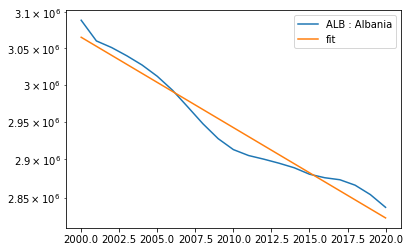

[0.08264769]


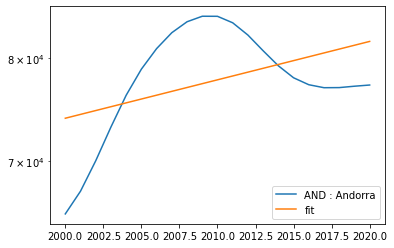

[0.00045948]


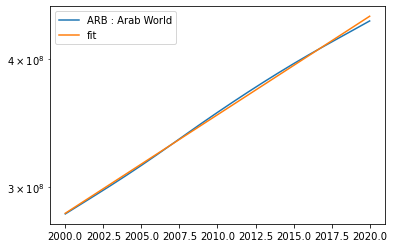

[0.48803304]


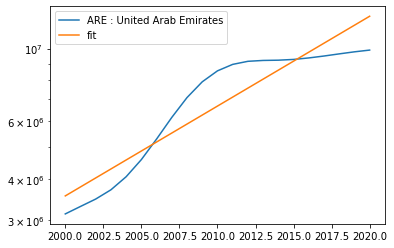

[2.38025447e-05]


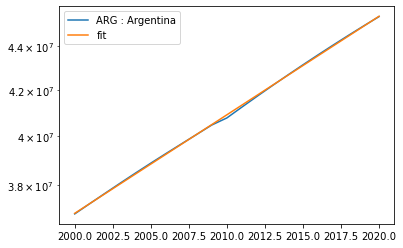

[0.0050652]


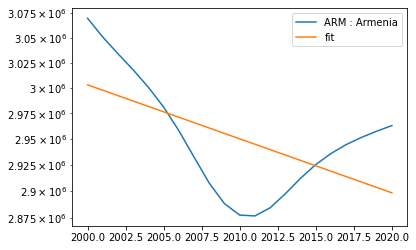

[0.00380859]


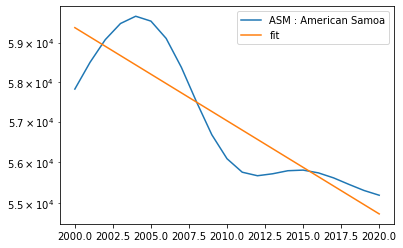

[0.00099192]


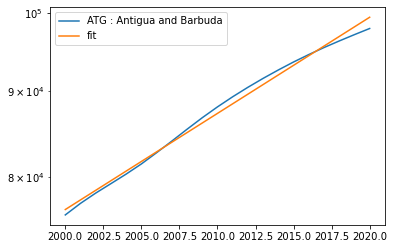

[0.00046929]


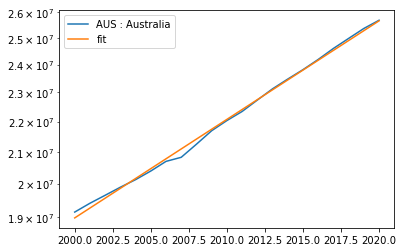

[0.00054548]


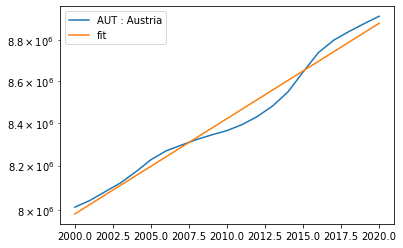

[0.00096071]


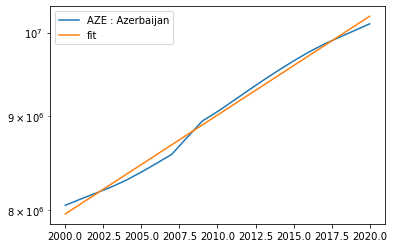

[0.00021021]


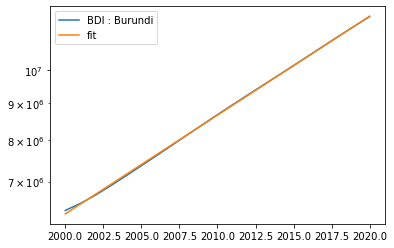

[0.00036571]


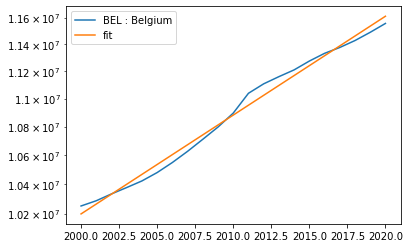

[0.00017613]


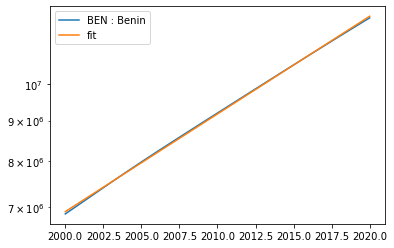

[4.1676247e-05]


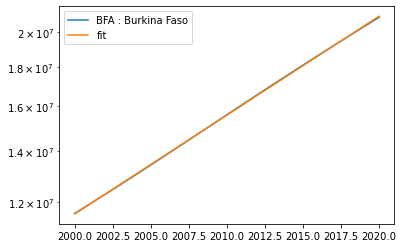

[0.00089049]


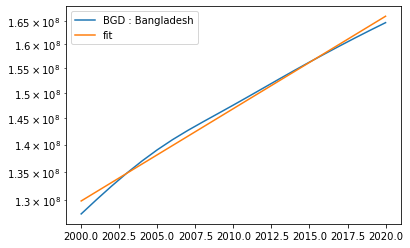

[0.00092242]


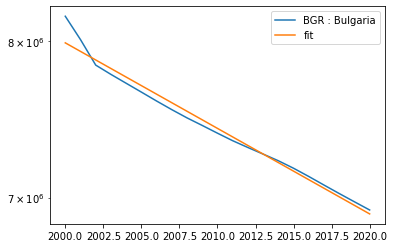

[0.06298625]


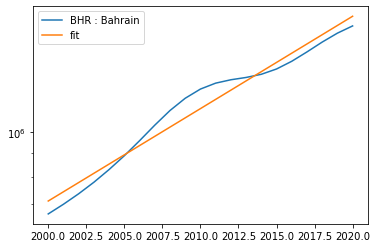

[0.00310311]


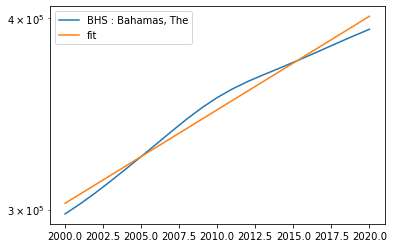

[0.00798402]


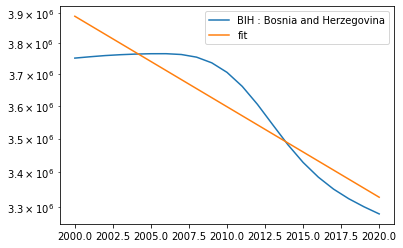

[0.00143613]


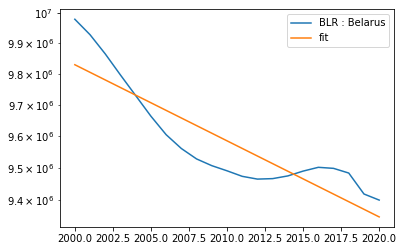

[0.00165254]


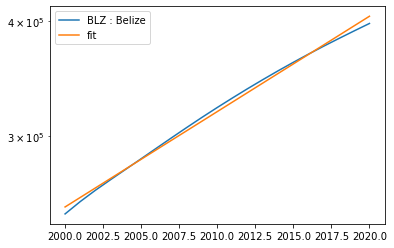

[0.00371298]


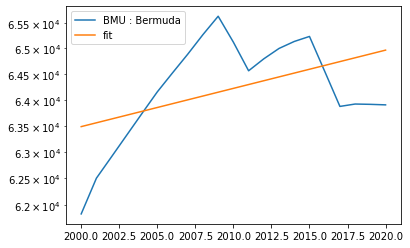

[0.00042083]


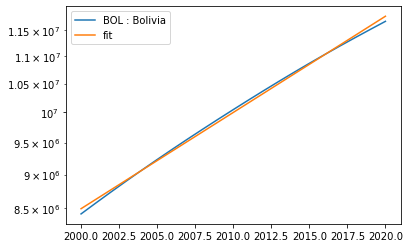

[0.00053443]


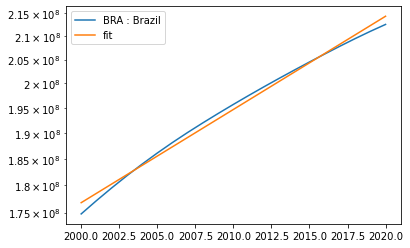

[0.00023485]


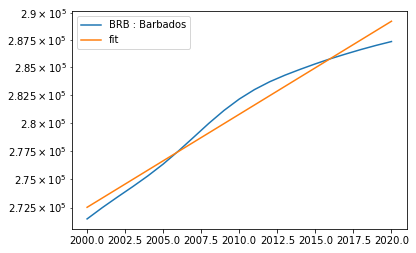

[0.00095766]


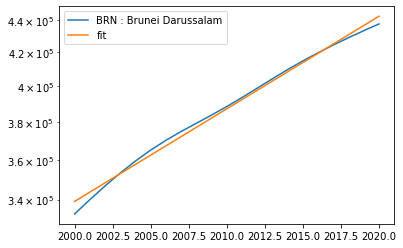

[0.00105099]


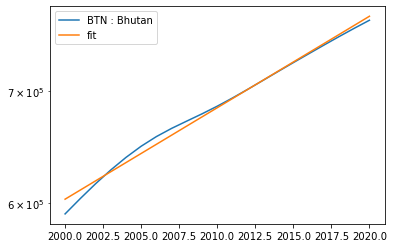

[0.00088918]


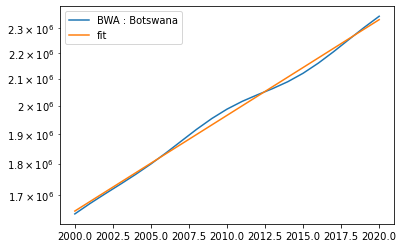

[0.00633423]


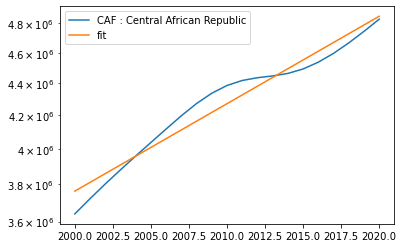

[0.00013217]


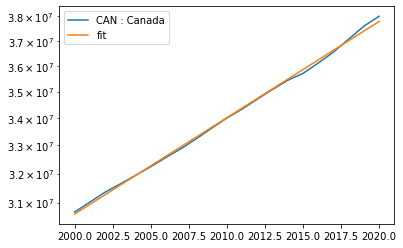

[0.00012569]


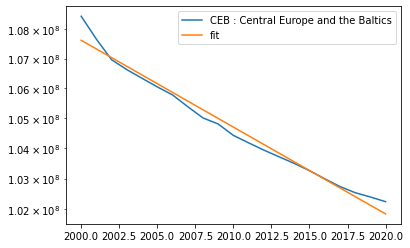

[0.0005041]


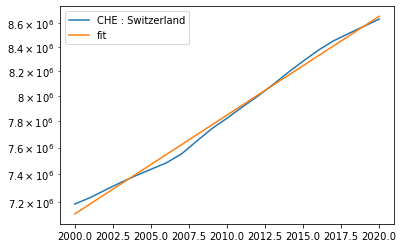

[0.00048747]


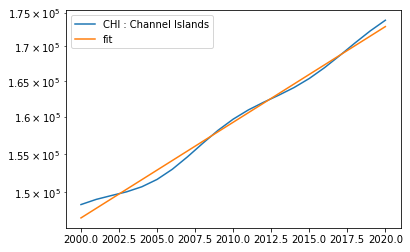

[0.00016186]


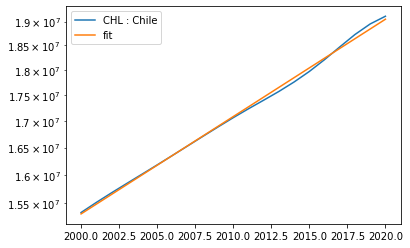

[6.30294934e-05]


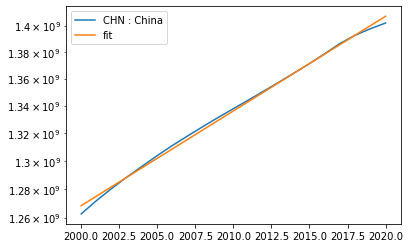

[0.00056416]


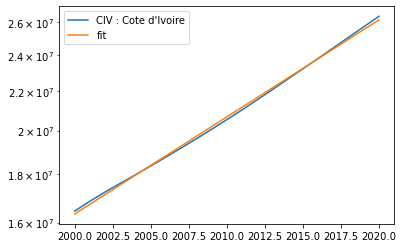

[3.32565751e-05]


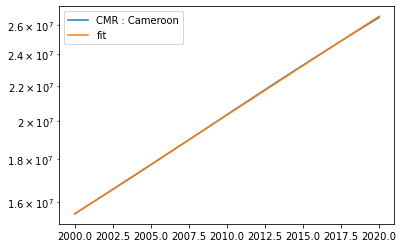

[0.00016763]


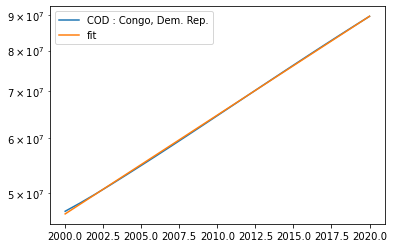

[0.0020253]


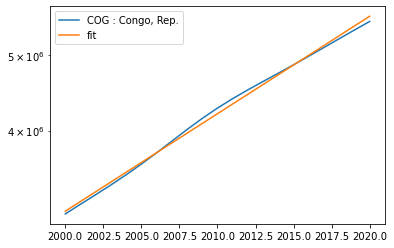

[0.00043632]


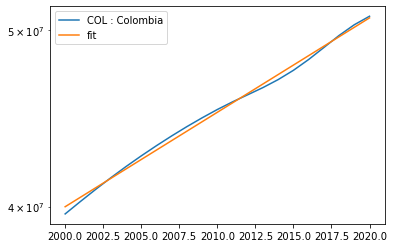

[5.85778436e-05]


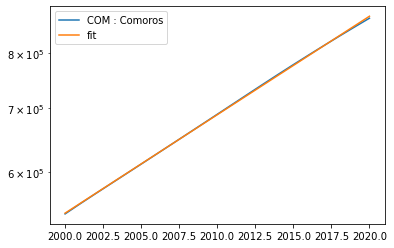

[0.00027288]


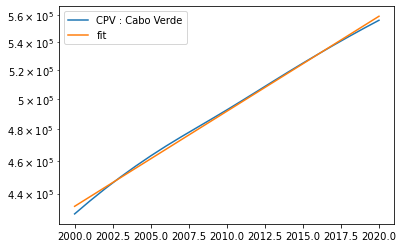

[0.00074444]


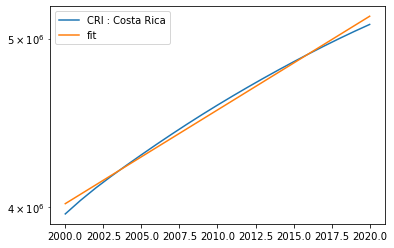

[1.45207004e-05]


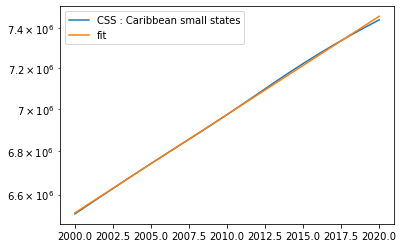

[0.00011064]


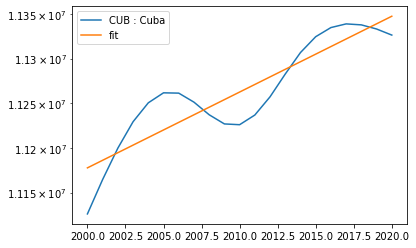

[0.0105623]


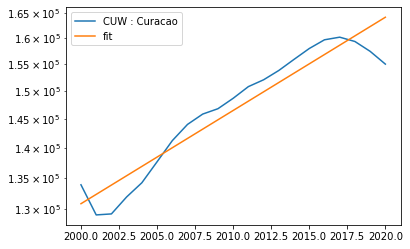

[0.01089811]


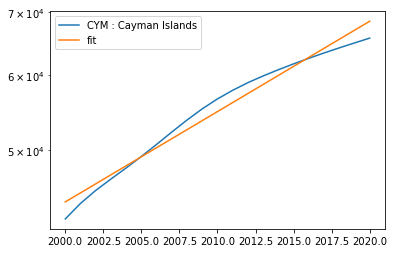

[0.00383863]


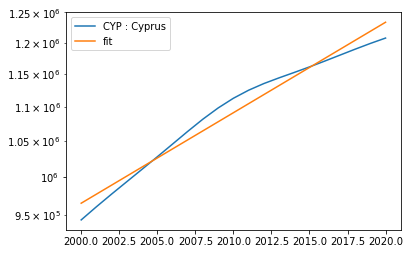

[0.00038086]


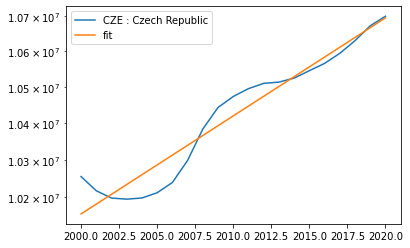

[0.00208533]


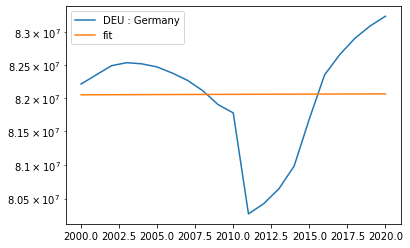

[0.00018586]


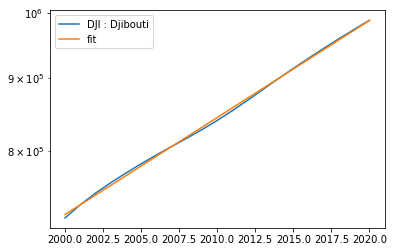

[0.00011047]


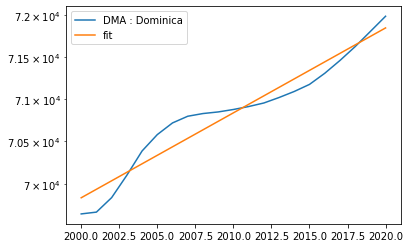

[0.00022141]


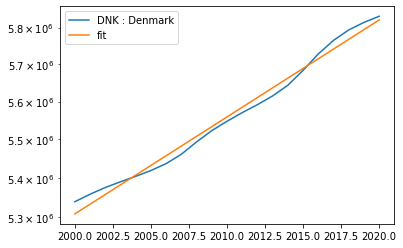

[0.00028447]


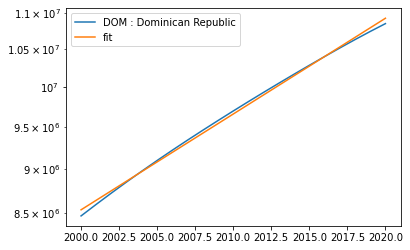

[0.00163499]


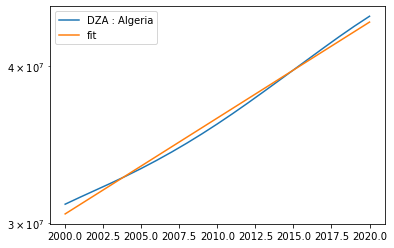

[6.36599545e-05]


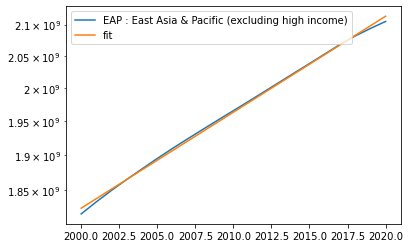

[0.00037069]


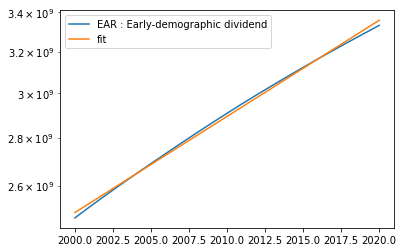

[6.36905214e-05]


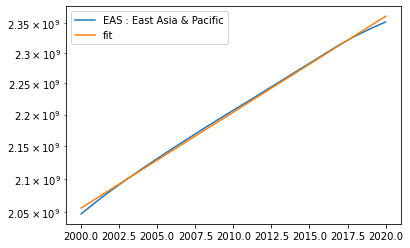

[0.00099283]


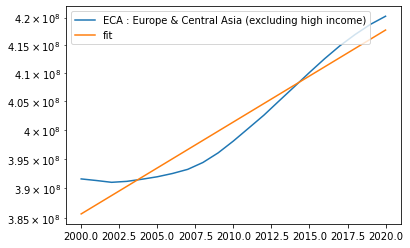

[8.84300802e-05]


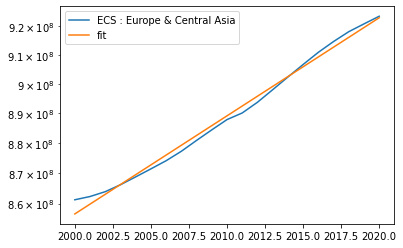

[6.43167926e-05]


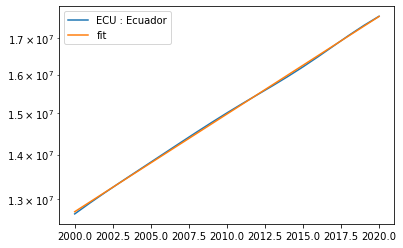

[0.0005353]


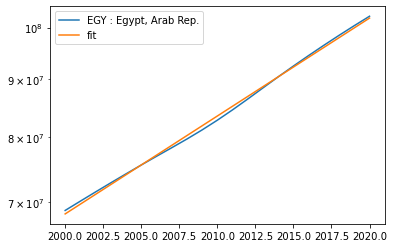

[0.00035605]


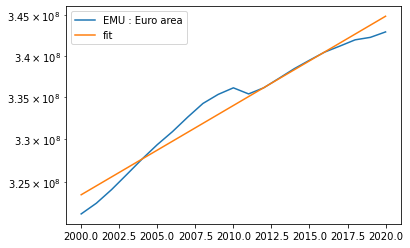

[0.01084169]


<ipython-input-105-a558e993c719>:10: RuntimeWarning: divide by zero encountered in log
  parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)


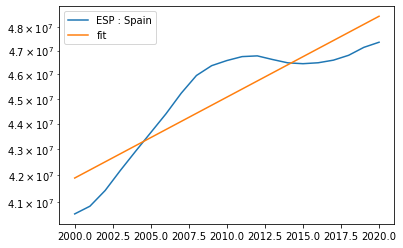

[0.00160433]


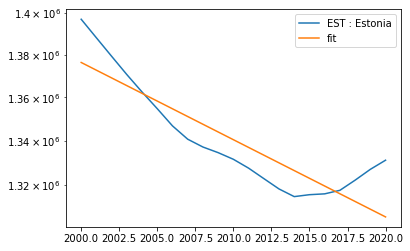

[7.00017939e-05]


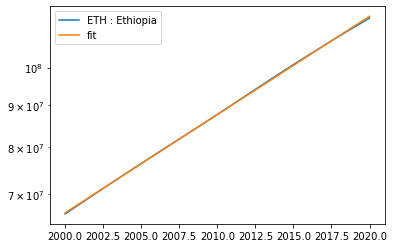

[0.00012944]


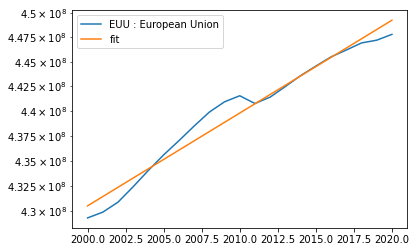

[0.00024785]


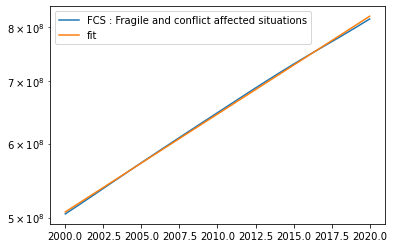

[0.00014486]


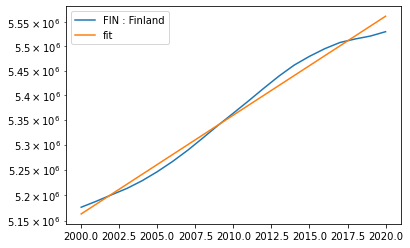

[0.00069273]


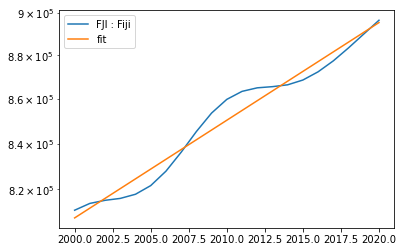

[0.00055822]


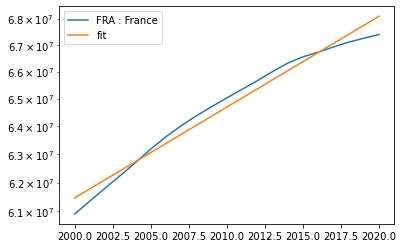

[0.00028213]


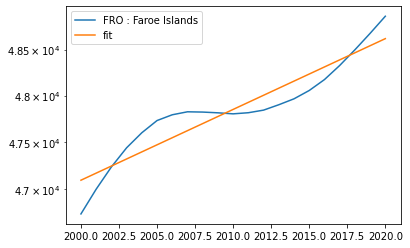

[0.01371714]


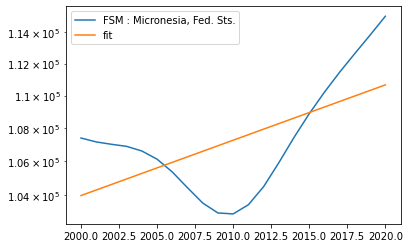

[0.00270944]


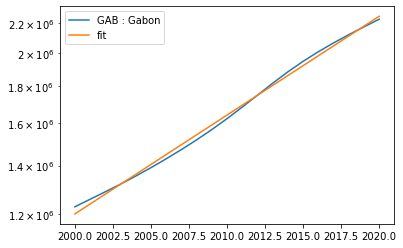

[0.00011146]


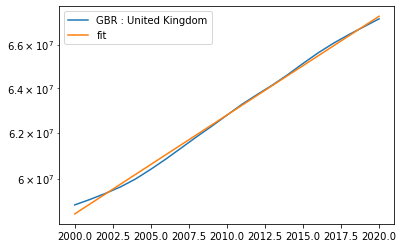

[0.00195142]


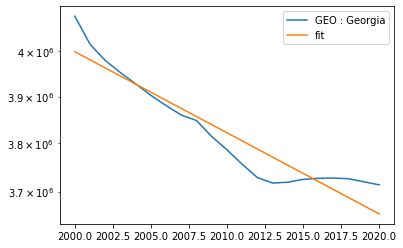

[0.00037161]


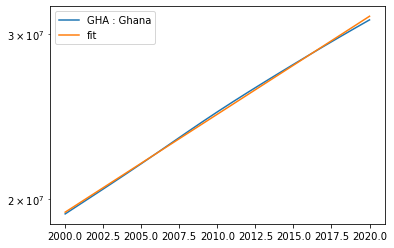

[0.00418843]


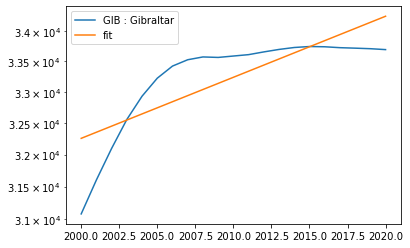

[0.00124761]


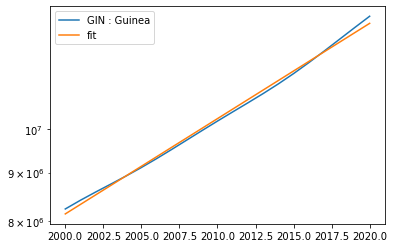

[7.92358789e-05]


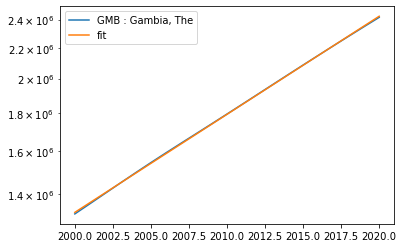

[0.00030115]


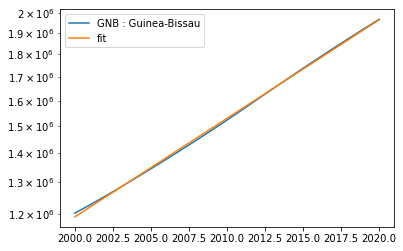

[0.00185419]


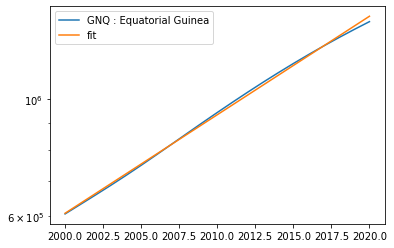

[0.00254156]


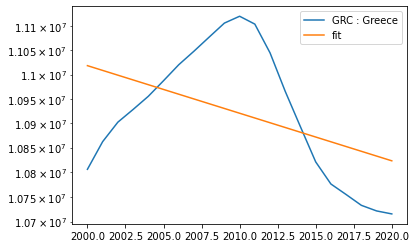

[0.00040139]


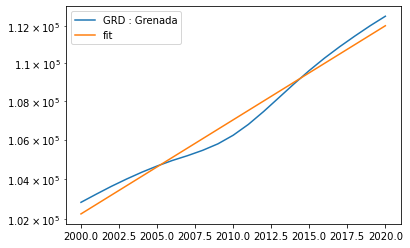

[0.00044671]


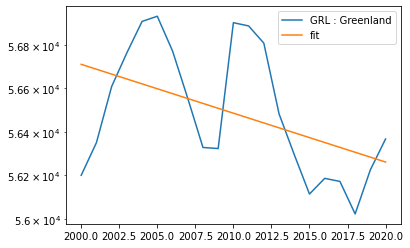

[0.0008868]


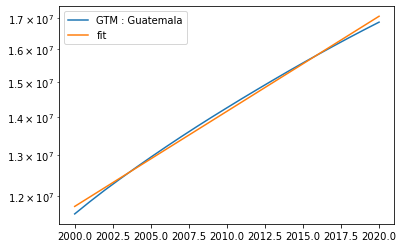

[0.00111885]


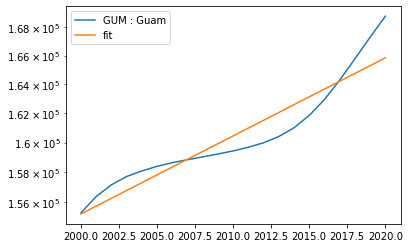

[0.0010634]


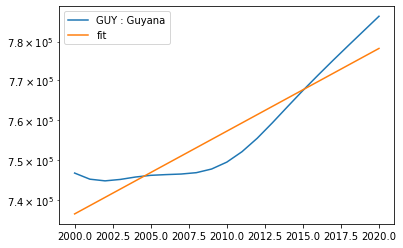

[0.0002949]


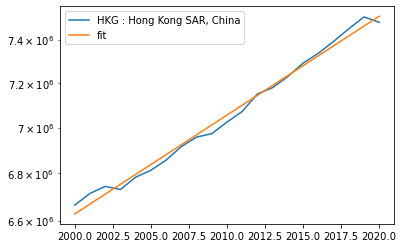

[0.00206715]


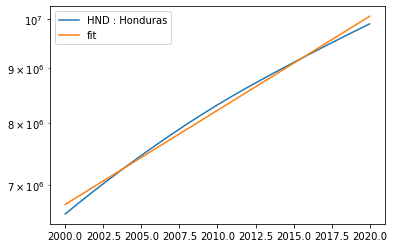

[1.25040063e-05]


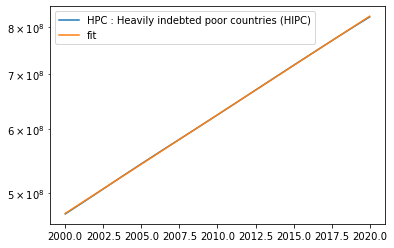

[0.00242126]


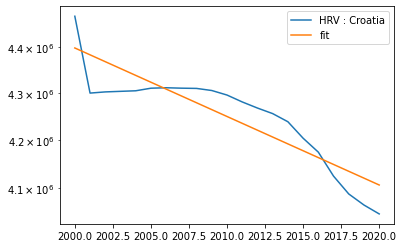

[0.00036852]


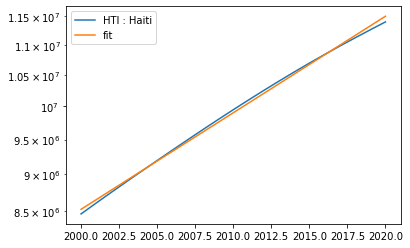

[4.07996987e-05]


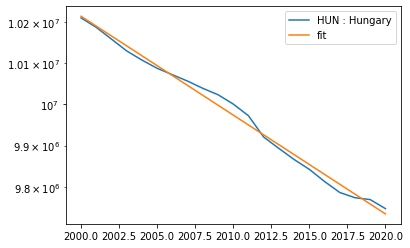

[8.94722074e-05]


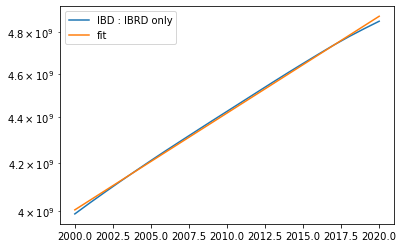

[4.67590927e-05]


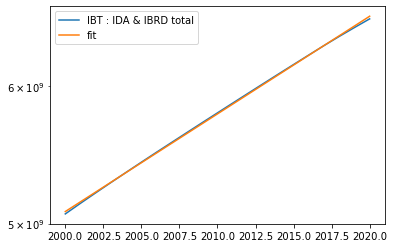

[7.76985706e-05]


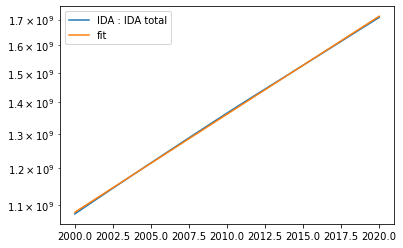

[3.63745971e-05]


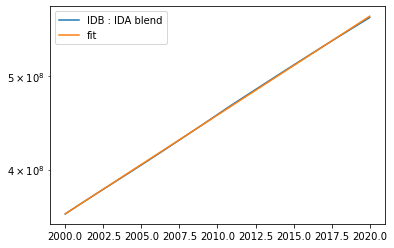

[9.24435548e-05]


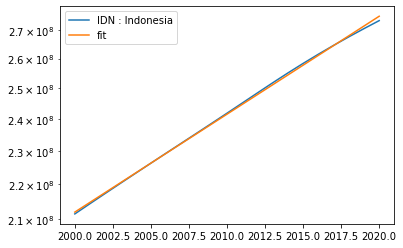

[0.00014757]


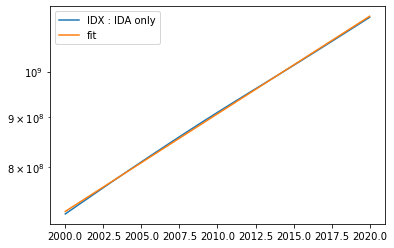

[0.00596587]


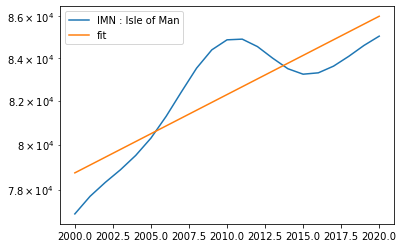

[0.00107626]


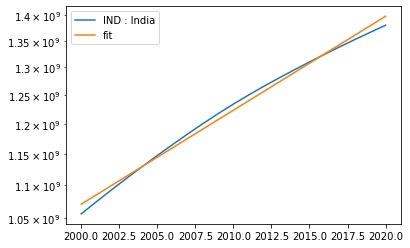

[0.00710014]


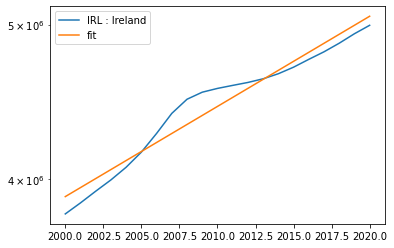

[0.00014843]


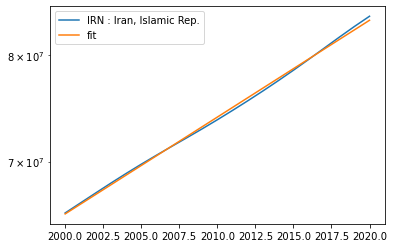

[0.00443024]


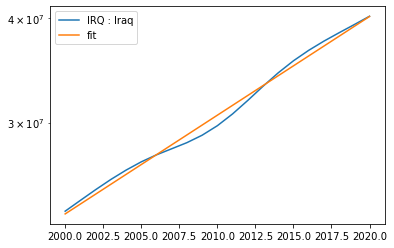

[0.0038206]


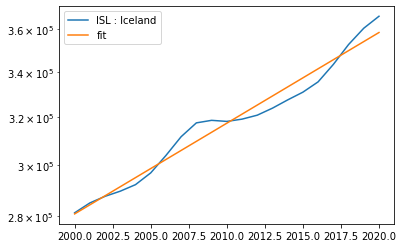

[6.30630681e-05]


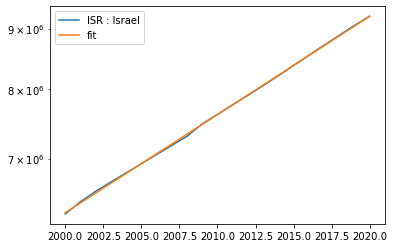

[0.00168465]


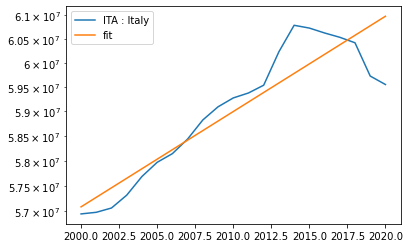

[2.67307877e-05]


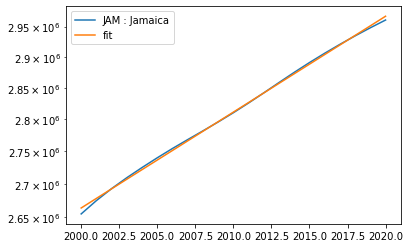

[0.02000305]


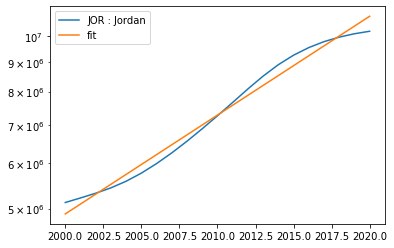

[0.00033037]


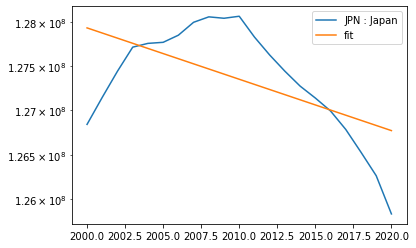

[0.00272777]


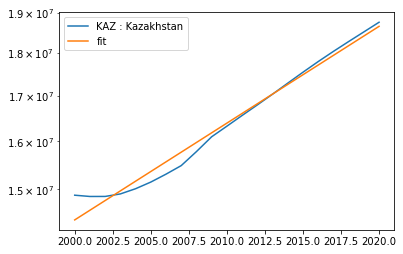

[0.00050215]


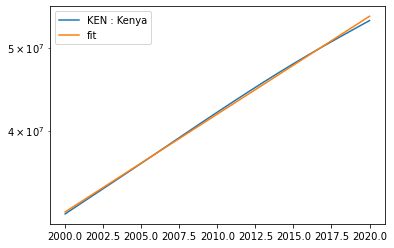

[0.00411583]


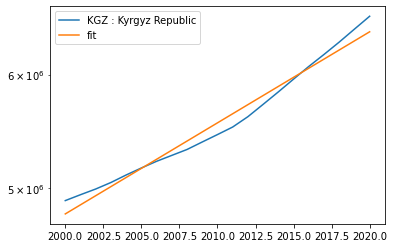

[9.117473e-05]


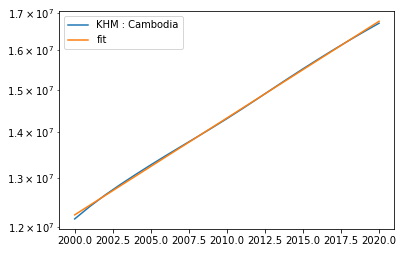

[0.00167908]


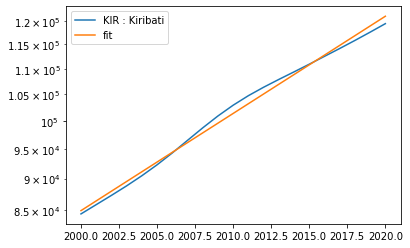

[0.0004276]


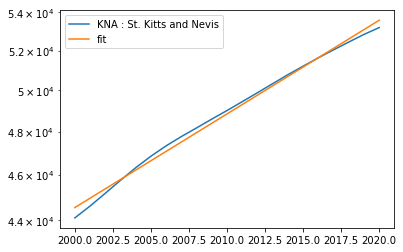

[0.00013536]


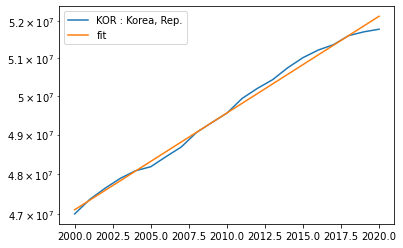

[0.02948392]


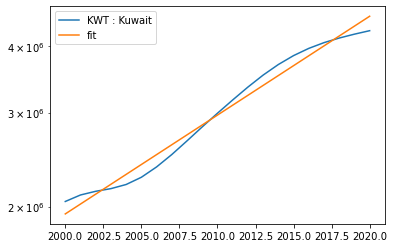

[0.00035634]


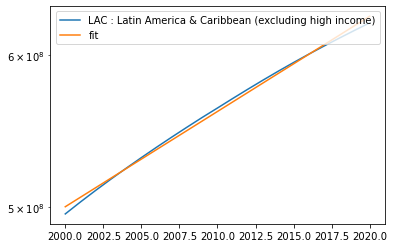

[4.35181202e-05]


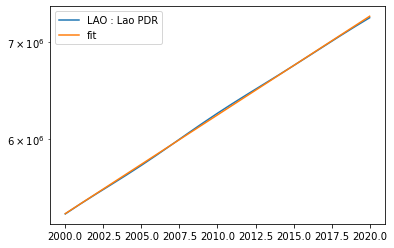

[0.03034484]


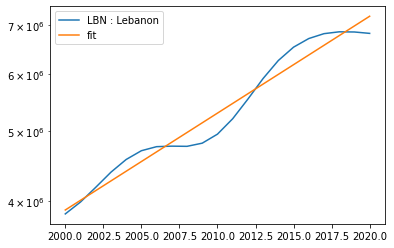

[0.0037931]


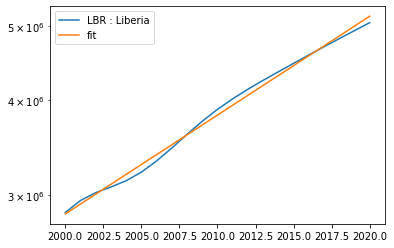

[0.00172926]


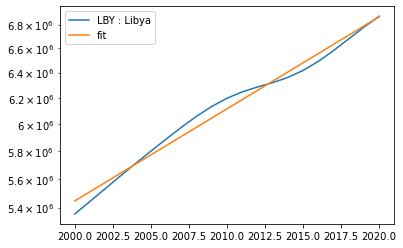

[0.00170038]


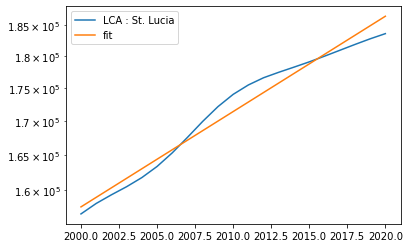

[0.00032939]


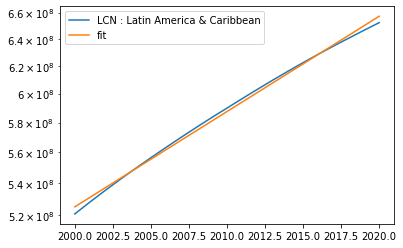

[4.64113835e-05]


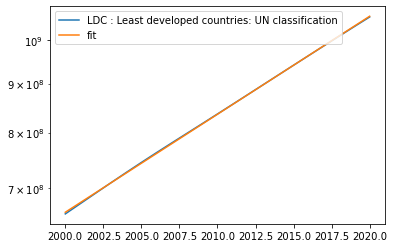

[0.00047995]


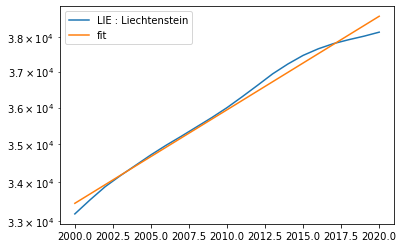

[0.00024095]


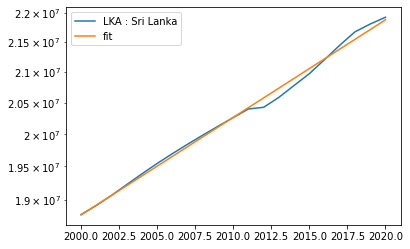

[4.95494708e-05]


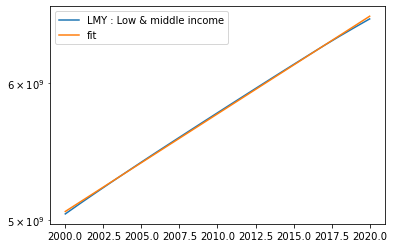

[0.00524764]


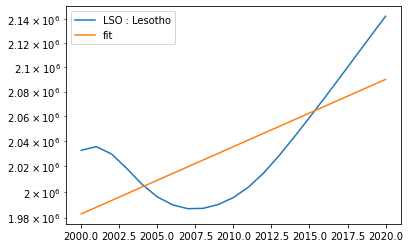

[2.80411061e-05]


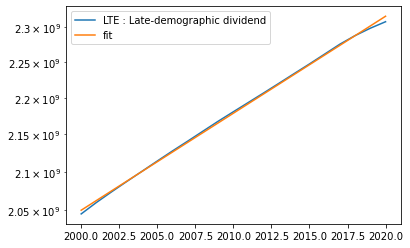

[0.00130255]


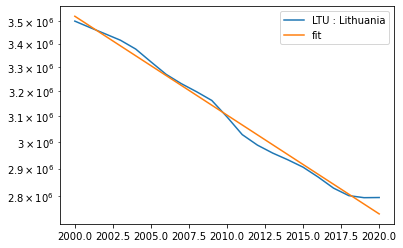

[0.00302138]


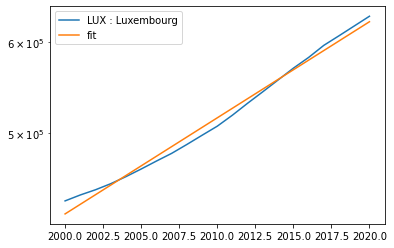

[0.00101014]


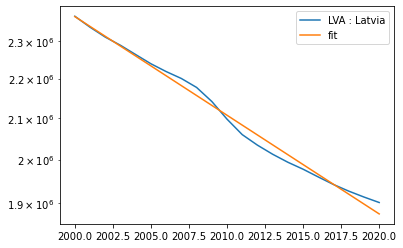

[0.00153243]


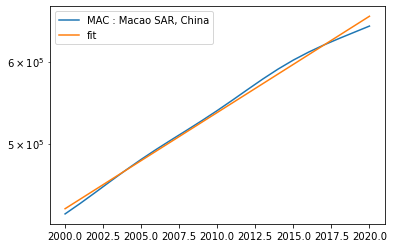

[0.04431701]


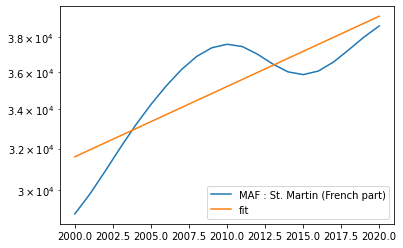

[0.00019308]


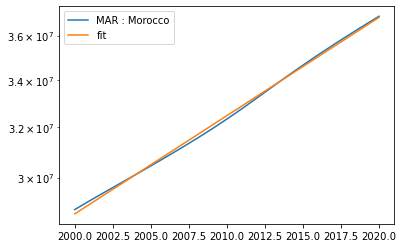

[0.00015499]


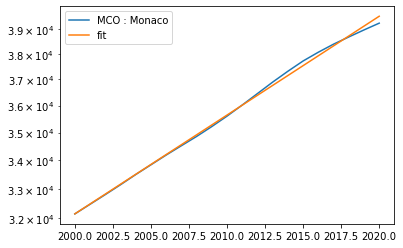

[0.00473822]


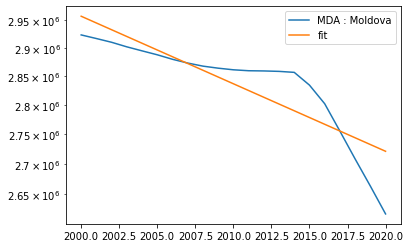

[0.00033936]


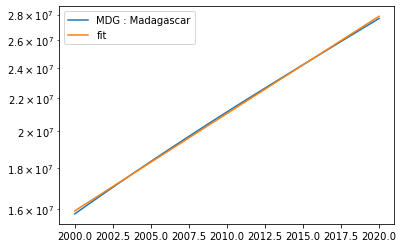

[0.01177558]


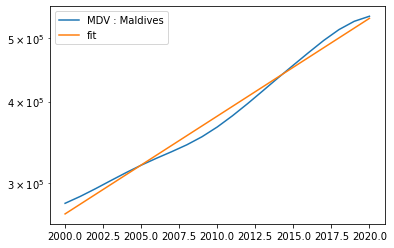

[0.00029321]


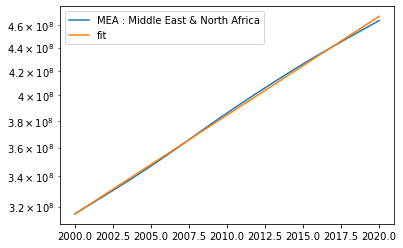

[0.00027922]


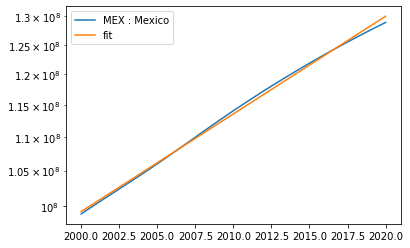

[0.00435931]


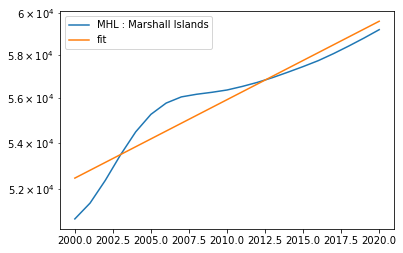

[5.77076547e-05]


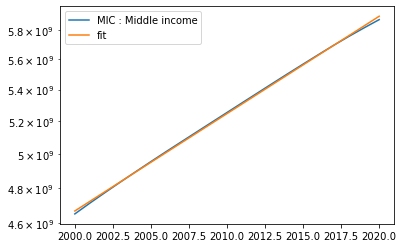

[7.65131205e-05]


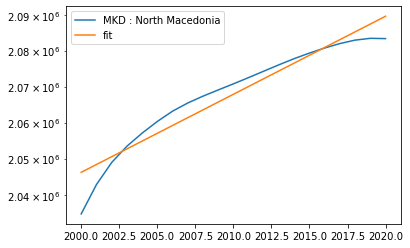

[0.0003359]


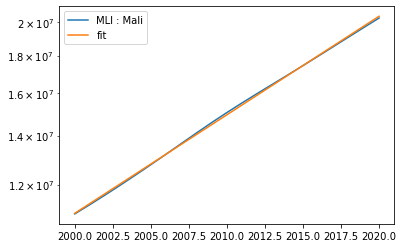

[0.02167978]


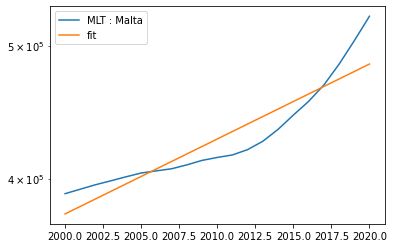

[0.00010579]


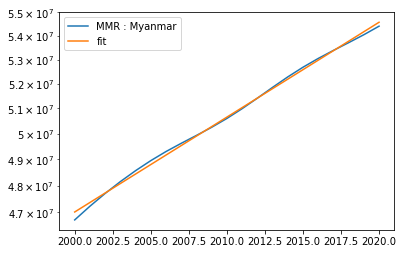

[1.35205482e-05]


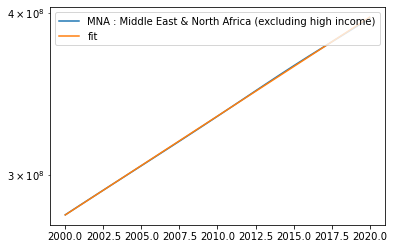

[0.0001973]


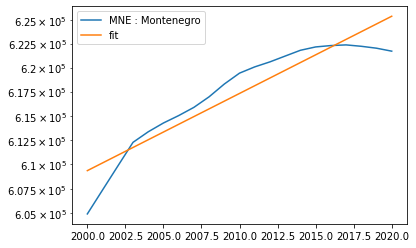

[0.00236571]


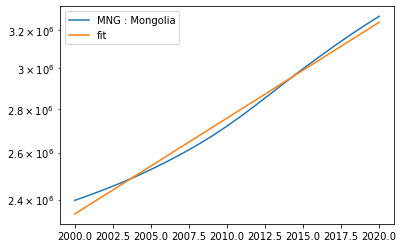

[0.01267577]


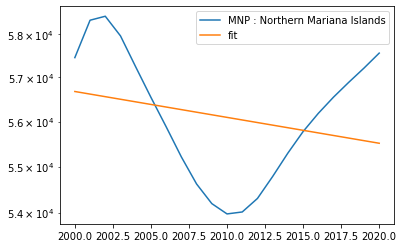

[5.88750055e-05]


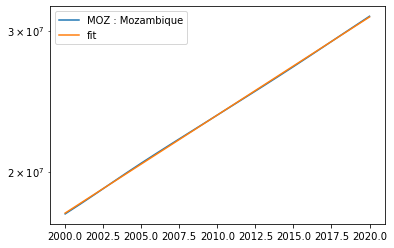

[4.75526597e-05]


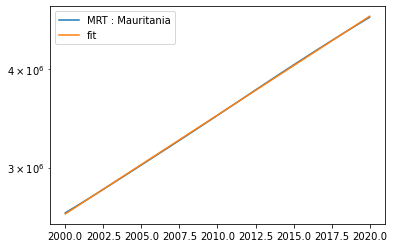

[0.00096196]


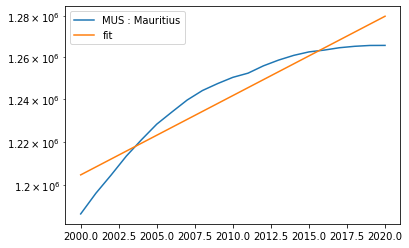

[0.00023898]


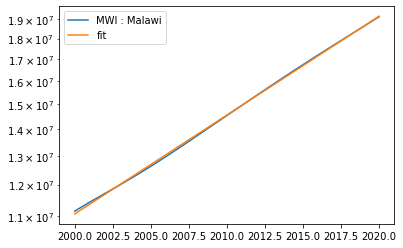

[0.00182526]


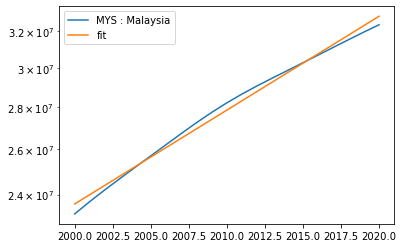

[0.00030086]


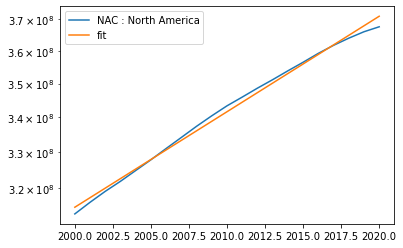

[0.00021445]


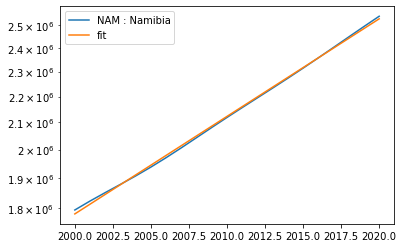

[0.00520082]


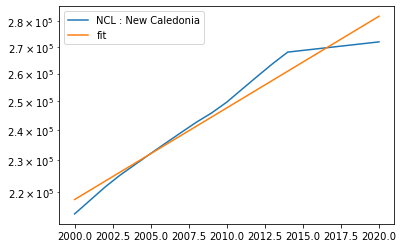

[0.00010193]


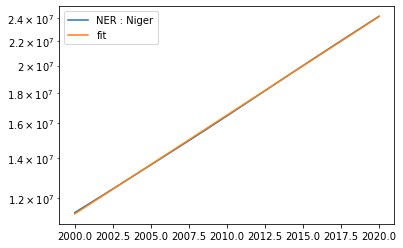

[3.14115792e-05]


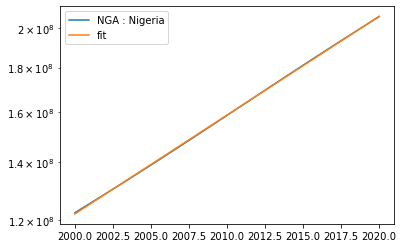

[5.032183e-05]


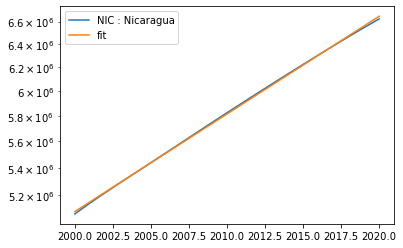

[0.0001561]


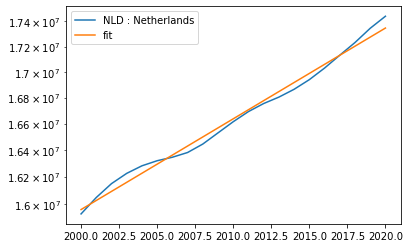

[0.00086533]


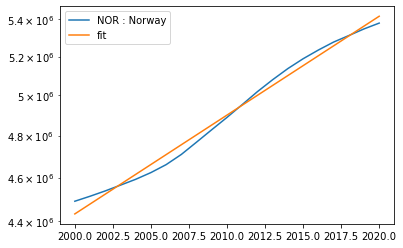

[0.00453105]


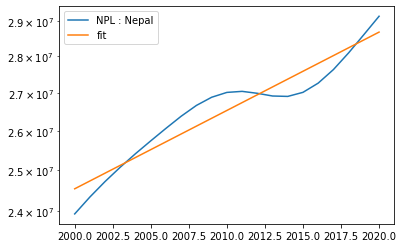

[0.00896105]


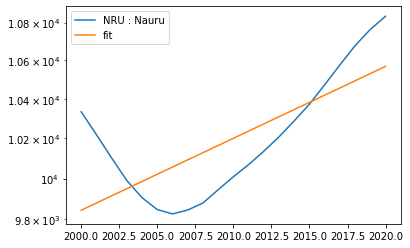

[0.00264545]


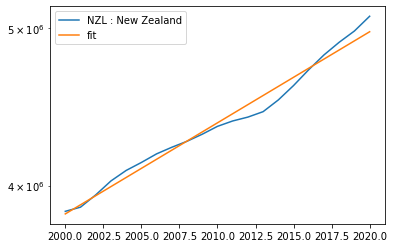

[8.51884826e-05]


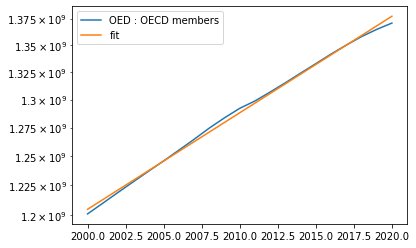

[0.0485604]


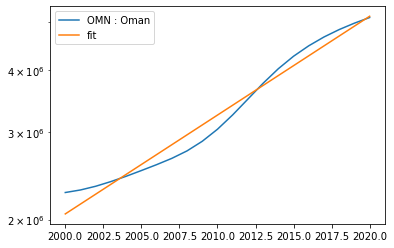

[0.00078184]


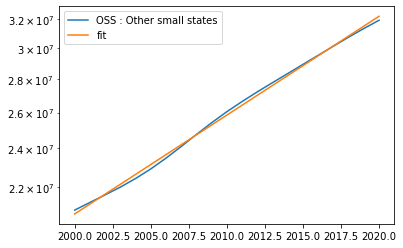

[0.00028072]


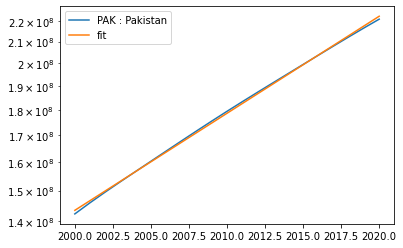

[0.00011235]


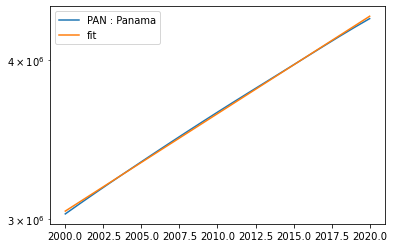

[0.00144352]


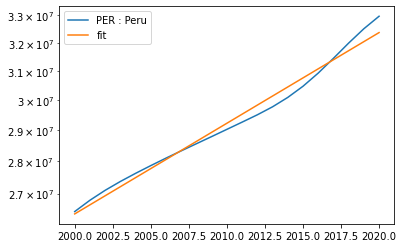

[0.00068329]


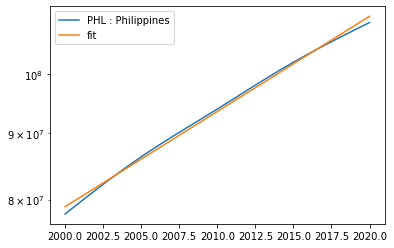

[0.01354575]


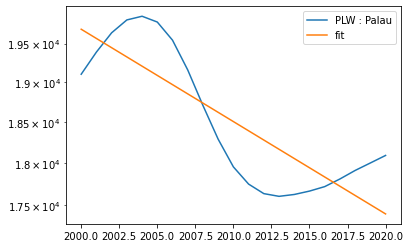

[0.00034941]


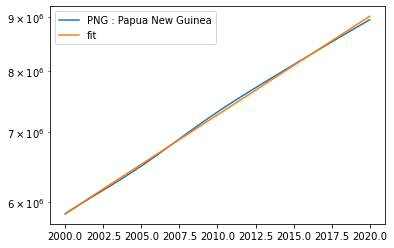

[5.27992101e-06]


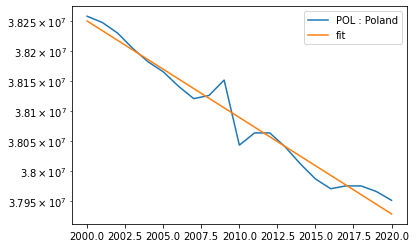

[2.1504354e-05]


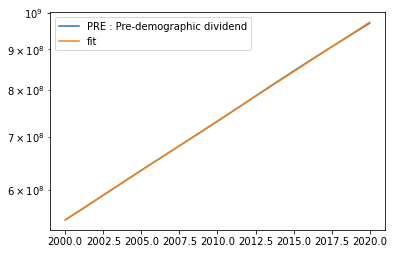

[0.01256376]


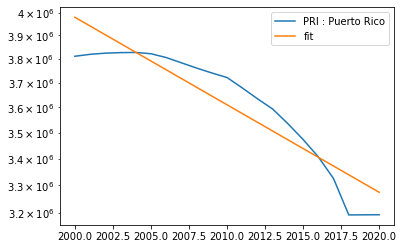

[0.00028947]


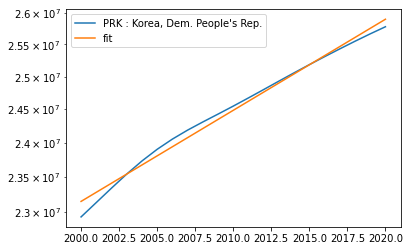

[0.00174985]


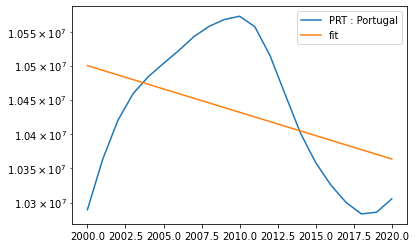

[0.00053422]


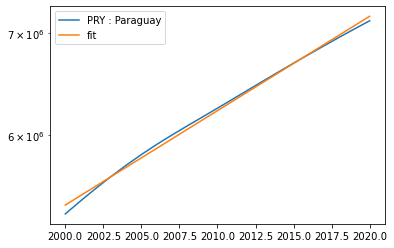

[0.00034566]


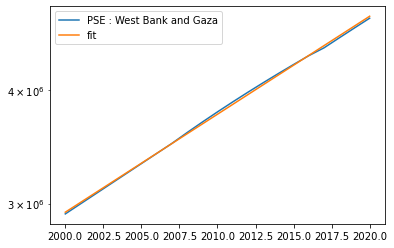

[0.00014505]


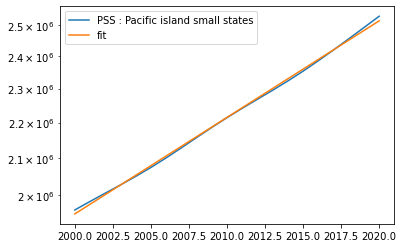

[0.00010439]


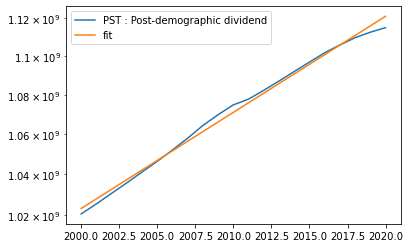

[0.0020766]


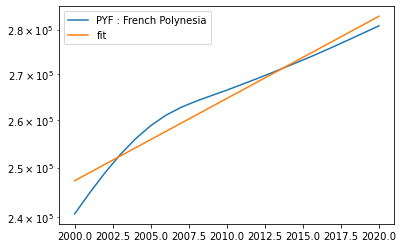

[0.42827527]


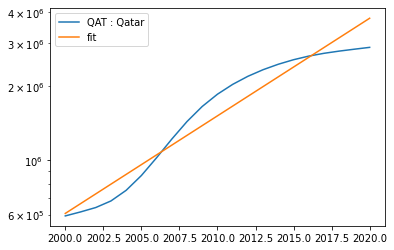

[0.00145716]


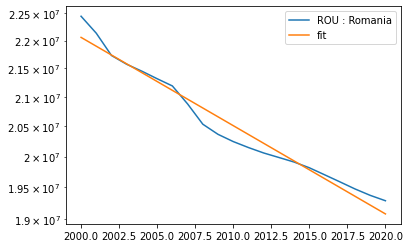

[0.00099969]


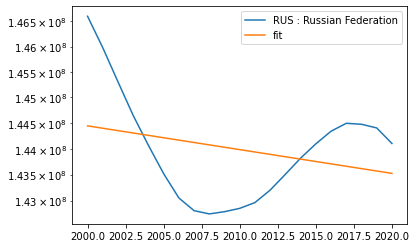

[0.00117244]


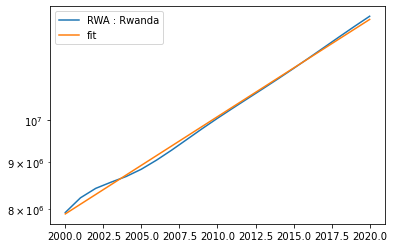

[0.00086245]


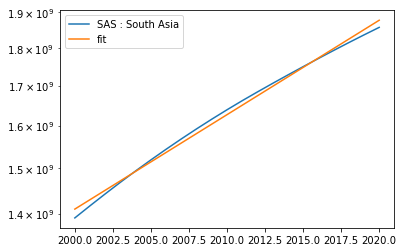

[0.00232904]


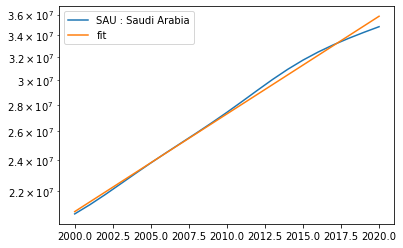

[0.00013192]


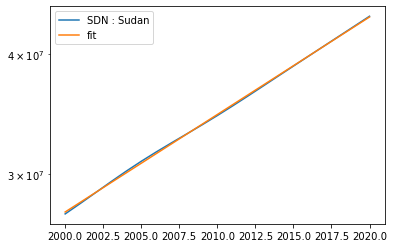

[0.00027997]


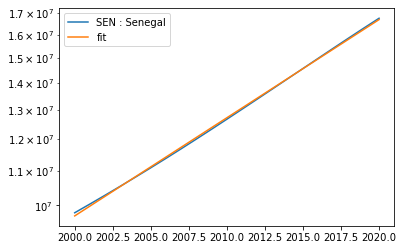

[0.01845135]


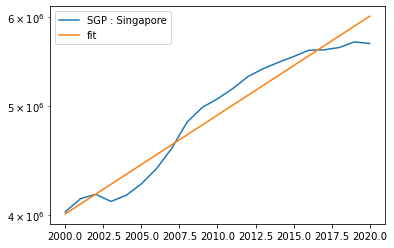

[0.00028779]


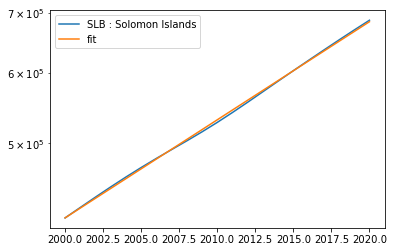

[0.01139933]


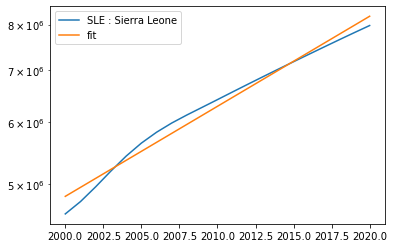

[2.30125985e-05]


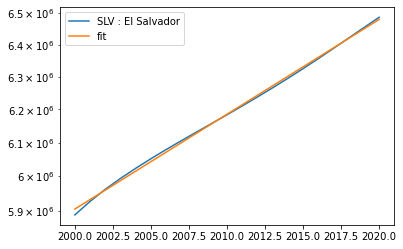

[0.00190281]


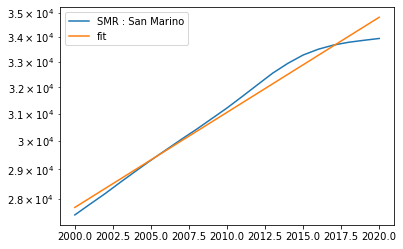

[0.00064254]


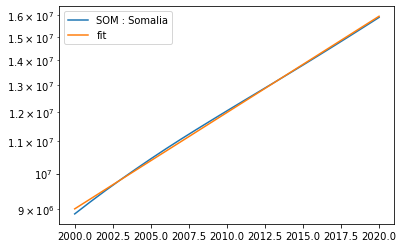

[0.00028297]


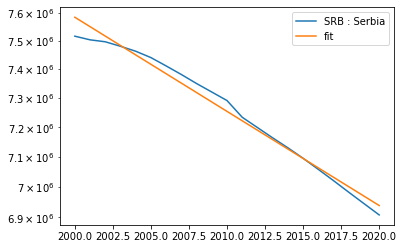

[1.69914241e-05]


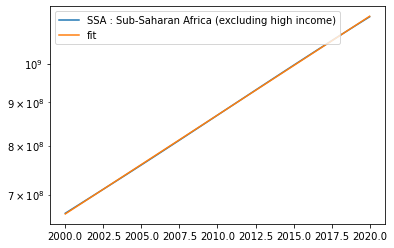

[0.0450283]


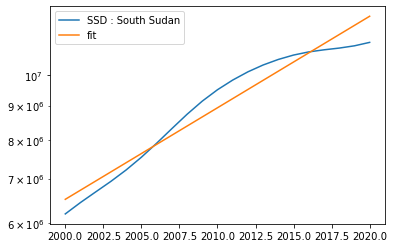

[1.70045617e-05]


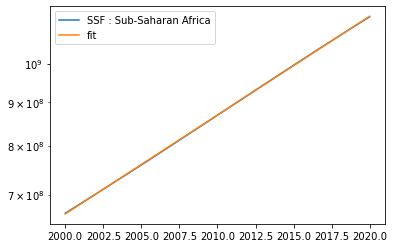

[0.00040472]


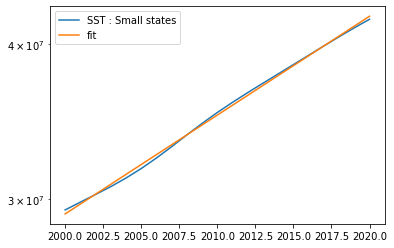

[0.0017783]


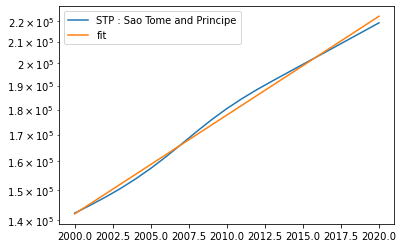

[0.00011148]


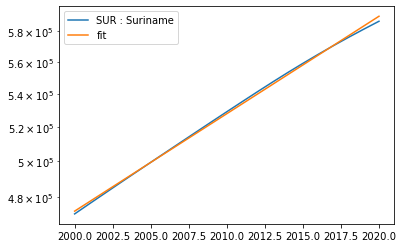

[9.10866849e-05]


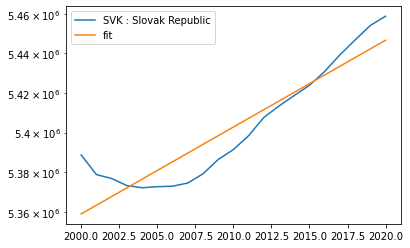

[0.00023189]


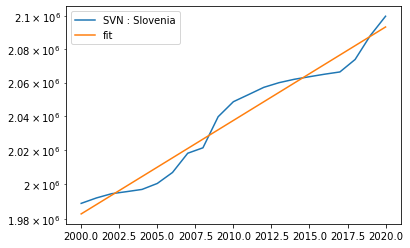

[0.00151234]


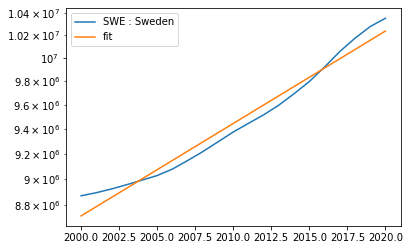

[0.00063773]


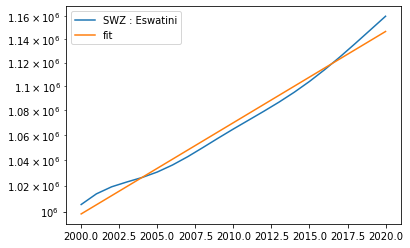

[0.01185647]


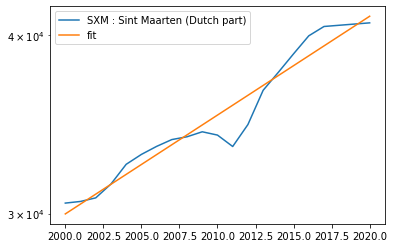

[0.00310493]


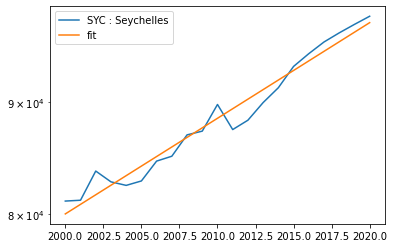

[0.15090033]


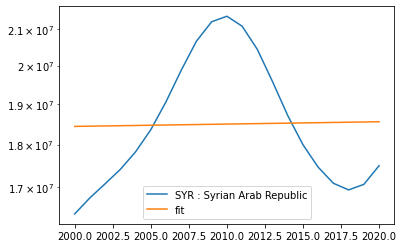

[0.06831574]


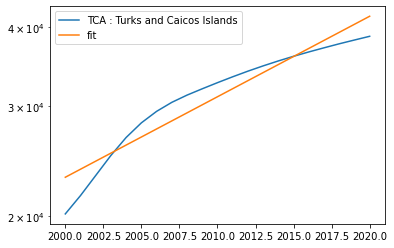

[0.00106972]


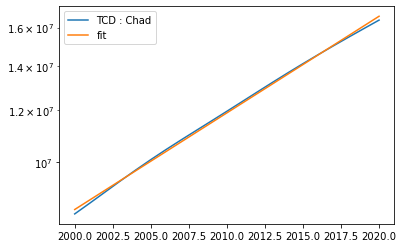

[6.20770465e-05]


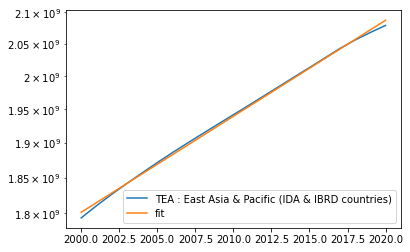

[0.00080861]


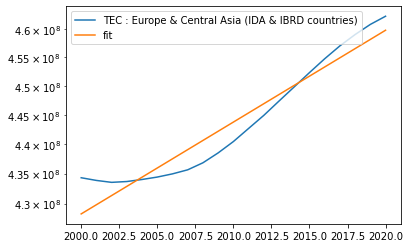

[0.00011171]


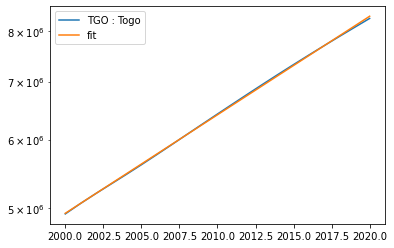

[0.00041513]


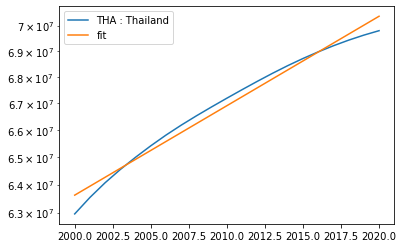

[0.00124848]


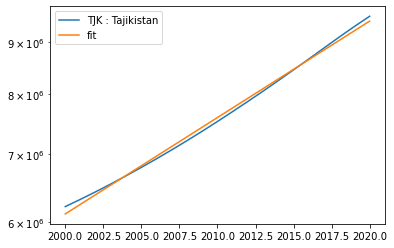

[0.00177214]


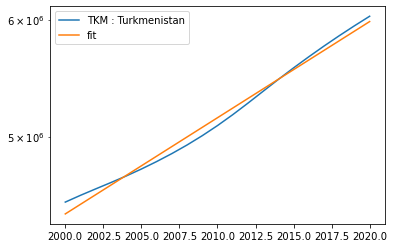

[0.00033194]


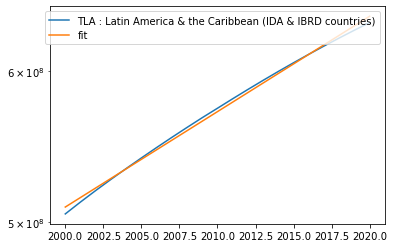

[0.00089105]


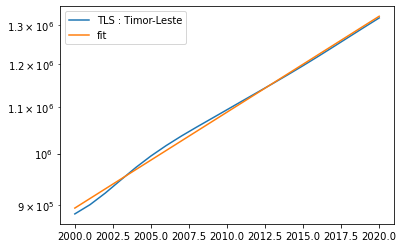

[1.33775468e-05]


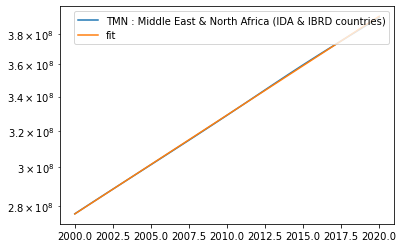

[0.00408624]


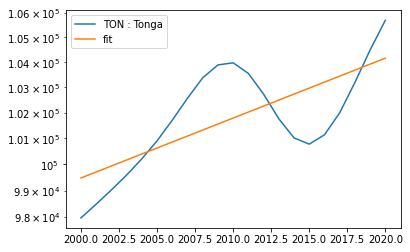

[0.00086245]


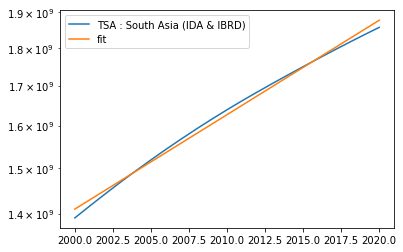

[1.70045617e-05]


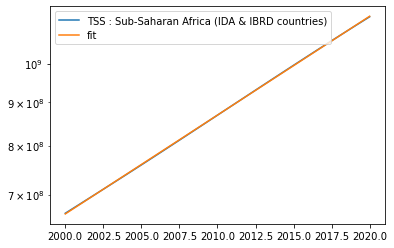

[6.64636682e-05]


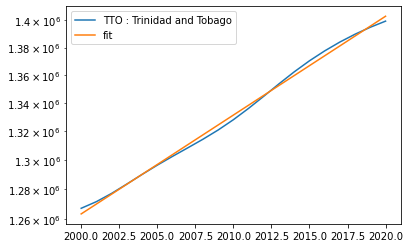

[0.00019187]


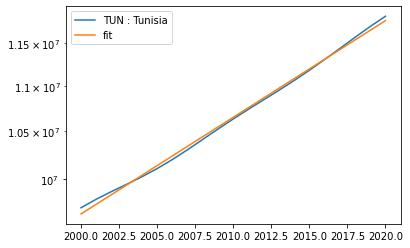

[0.00039539]


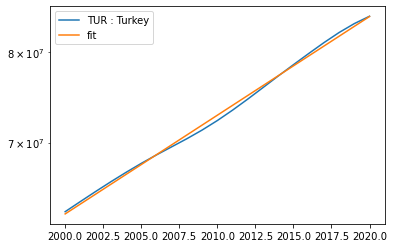

[0.00015435]


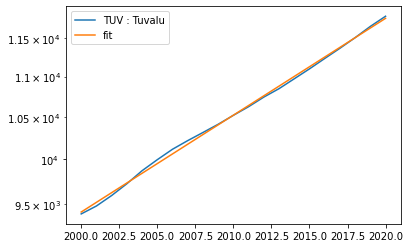

[0.00016455]


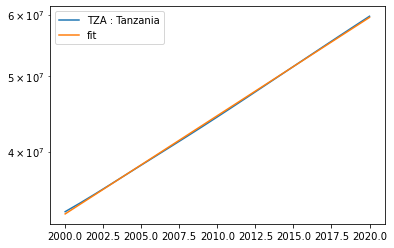

[0.00069271]


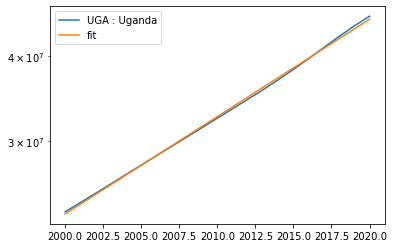

[0.00070391]


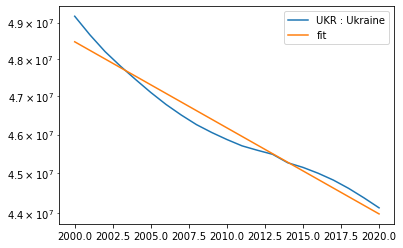

[0.00036444]


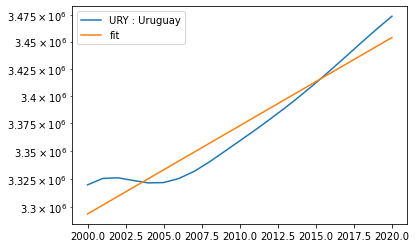

[0.00041415]


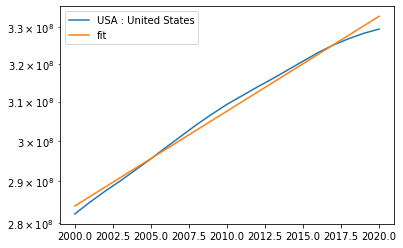

[0.00166428]


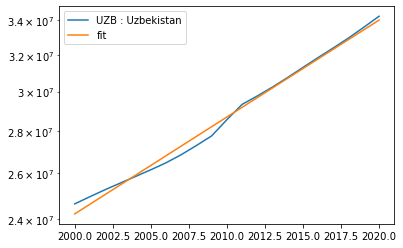

[0.00033621]


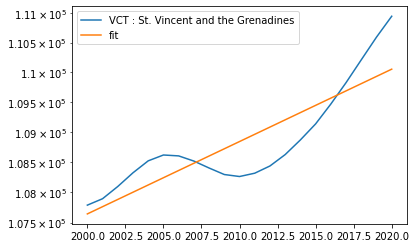

[0.02202797]


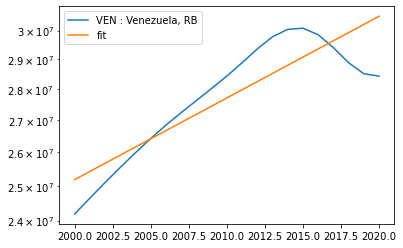

[0.03368894]


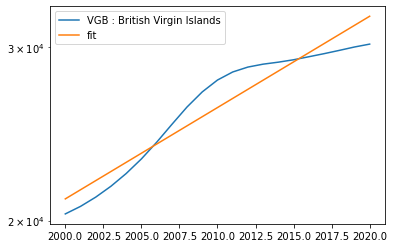

[0.00016801]


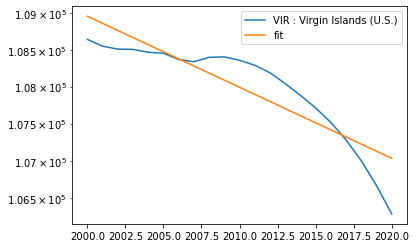

[3.25661358e-05]


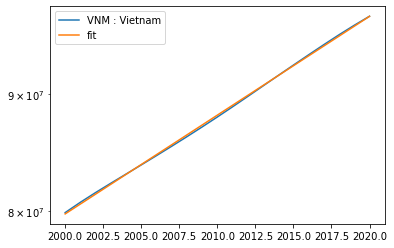

[0.000246]


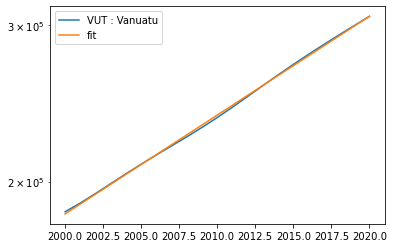

[5.70039826e-05]


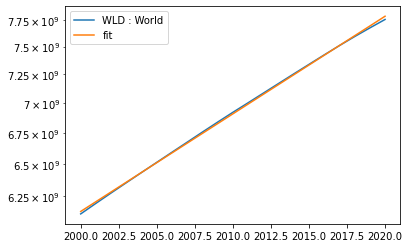

[0.00014245]


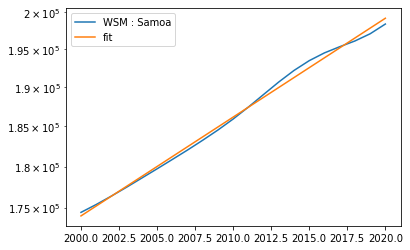

[0.00297872]


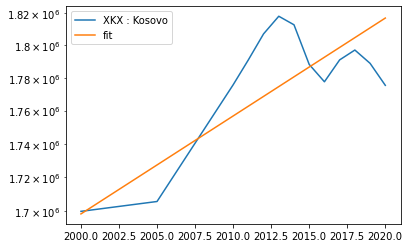

[0.0006518]


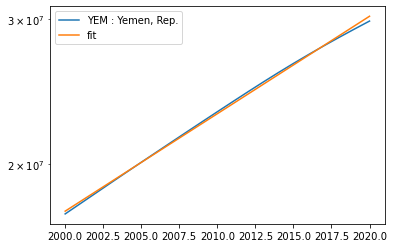

[0.00026058]


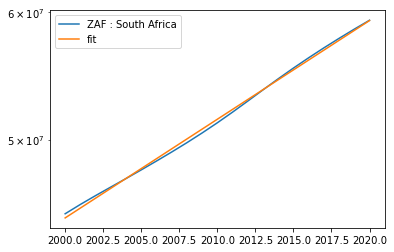

[0.00075236]


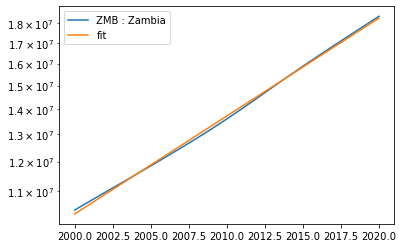

[0.00540345]


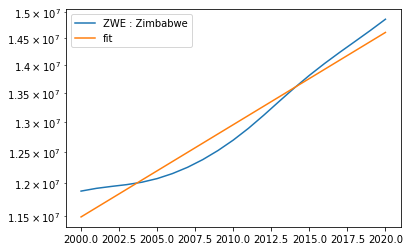

Pass_count total:  260
Pass_count total (%):  99.61685823754789


In [105]:
def fit_funtion(x, parameters):
    return np.exp(parameters[1])*np.exp(x*parameters[0])

pass_count = 0 
for country in countries[0:261]: 
    full_name_country = df[df['countryiso3code']==country]['country'].values[0]['value']
    x = df_group.loc[country].index.tolist()
    y = df_group.loc[country].values.tolist()
    
    parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)
    if res > 0: # 0.1, < 0 to plot all of them
        y_fit = [fit_funtion(x_i, parameters) for x_i in x] #https://stackoverflow.com/questions/3433486/how-to-do-exponential-and-logarithmic-curve-fitting-in-python-i-found-only-poly
        print(res)
        plt.plot(x,y, label = country + ' : ' + full_name_country)
        plt.plot(x, y_fit, label = 'fit')
        plt.yscale("log")
        plt.legend()
        plt.show()
        pass_count += 1
    
    # https://stackoverflow.com/questions/19189362/getting-the-r-squared-value-using-curve-fit
print('Pass_count total: ', pass_count)
print('Pass_count total (%): ', pass_count*100/len(countries))

## 2. Explore the Exp(t) model last 20 years (Monte Carlo)

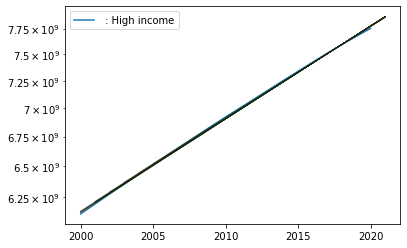

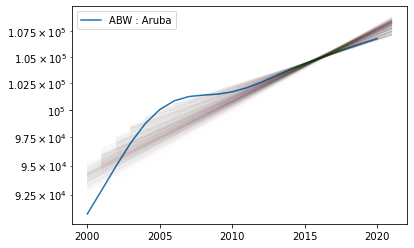

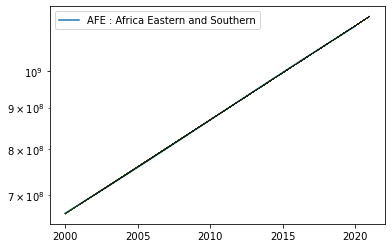

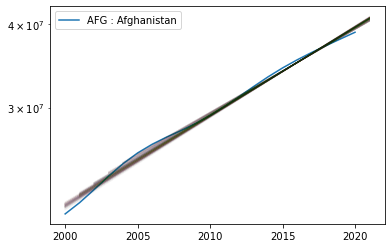

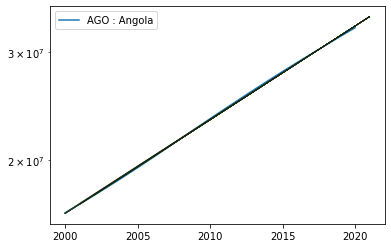

...

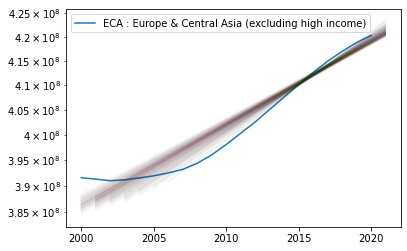

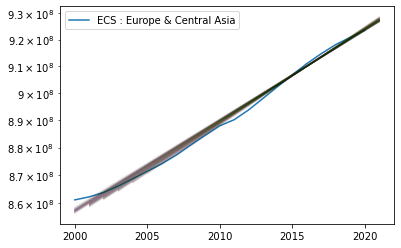

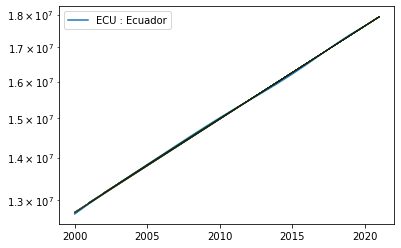

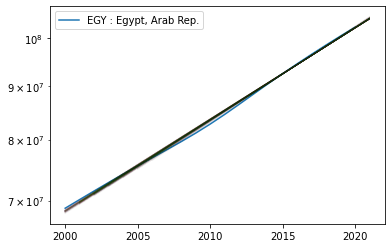

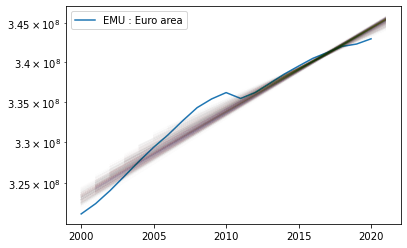

<ipython-input-281-c43d4a5487c4>:21: RuntimeWarning: divide by zero encountered in log
  parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)


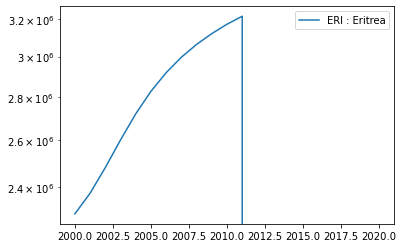

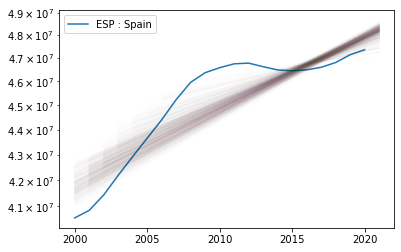

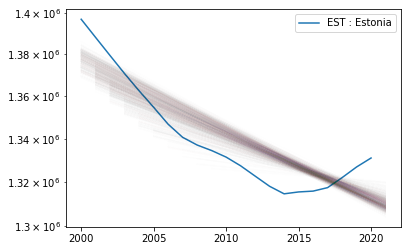

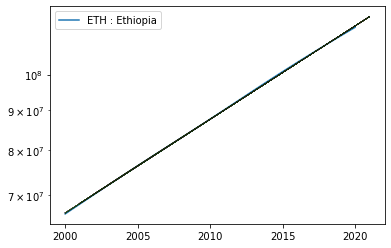

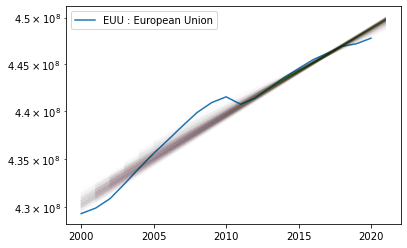

...

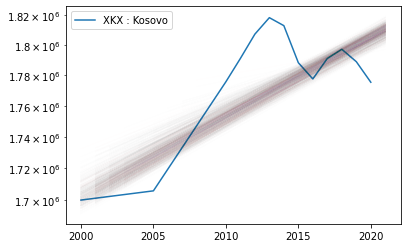

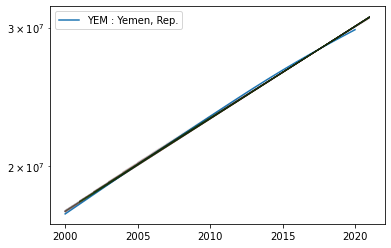

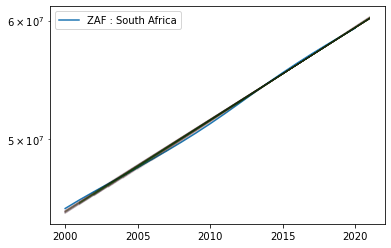

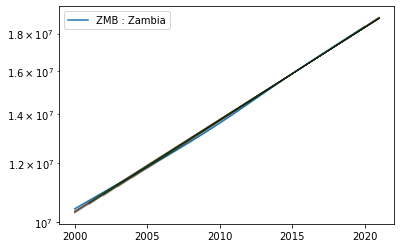

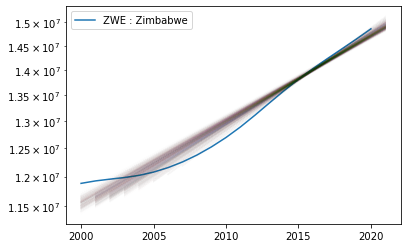

In [281]:
%%time
def fit_funtion(x, parameters):
    return np.exp(parameters[1])*np.exp(x*parameters[0])

for country in countries: 
    full_name_country = df[df['countryiso3code']==country]['country'].values[0]['value']
    x = df_group.loc[country].index.tolist()
    y = df_group.loc[country].values.tolist()
    plt.plot(x,y, label = country + ' : ' + full_name_country)
    
    total_range = [i for i in range(0,20-2)]
    monteCarloValues  = []
    
    for monteCarlo in range(1000): 
        random_index = np.sort(np.unique(random.sample(total_range,7)+[20, 19, 18, 17, 16]))

        x1 = df_group.loc[country].index.tolist()
        y1 = df_group.loc[country].values.tolist()

        x = [x1[i] for i in random_index]
        y = [y1[i] for i in random_index]
        parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)
        
        x_predict = x + [2021]
        y_fit = [fit_funtion(x_i, parameters) for x_i in x_predict] 
        
        monteCarloValues.append(fit_funtion(2021, parameters))

        plt.plot(x_predict, y_fit, alpha=0.005)
        plt.yscale("log")
    plt.legend()
    plt.show()
        

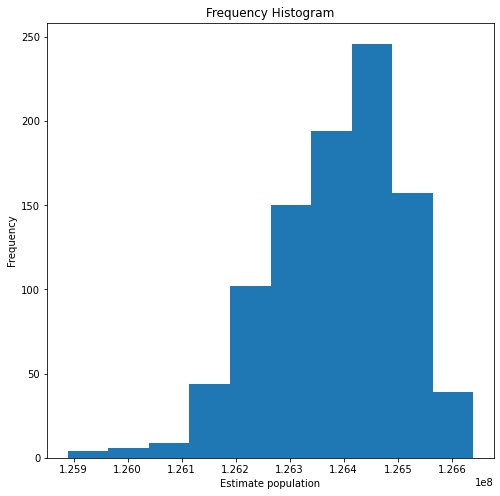

In [280]:
plt.figure(figsize=(8, 8))
plt.hist(monteCarloValues)
plt.gca().set(title='Frequency Histogram', ylabel='Frequency', xlabel = 'Estimate population');

Método simple, seguir con el mismo método para predicir 1 o 4 años no se realizará porque están relacionados. 
Las edades presentan un error y una estimación que se puede calcular utilizando 
np.percentile(monteCarloValues, 25)
np.percentile(monteCarloValues, 75)
tomando los rangos como los porcentiles 25 y 75. 


Se procederá con el cálculo de errores + montecarlo: ¿Cómo cambia los errores con el tiempo? La idea es predecir el error. 

## 3. Método smoth data + adjustment

Predecir por segmentos para calcular la posible corrección: predecir corrección 

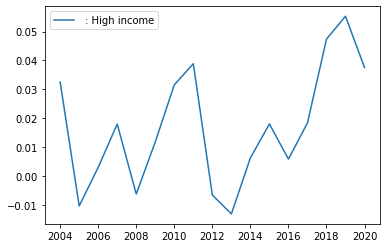

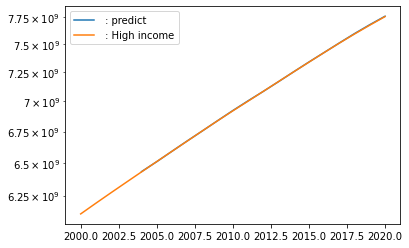

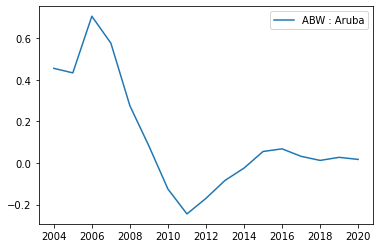

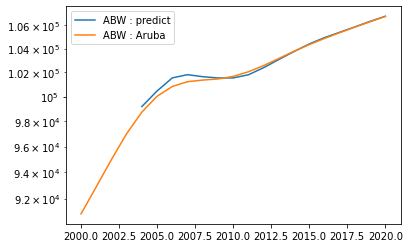

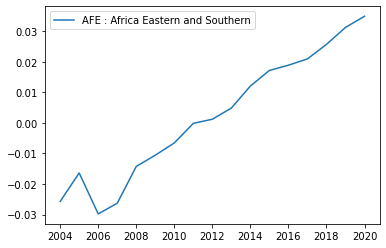

...

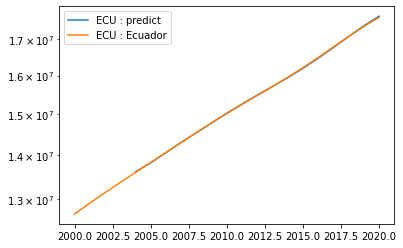

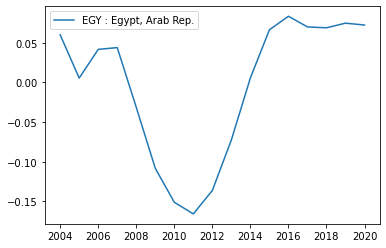

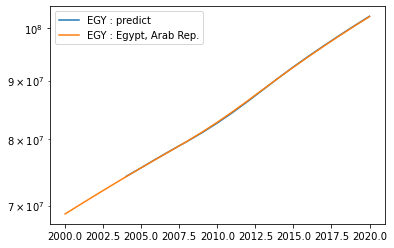

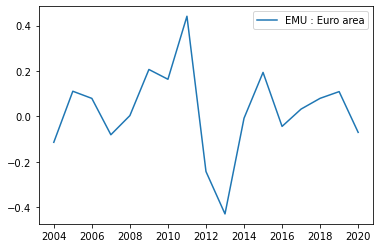

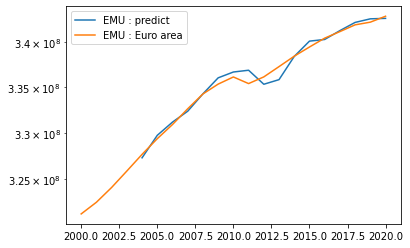

<ipython-input-352-e866f4679cf9>:34: RuntimeWarning: divide by zero encountered in double_scalars
  delta_y_adjustment_normal.append((y_predict-y[j+4])*100/y[j+4])
<ipython-input-352-e866f4679cf9>:17: RuntimeWarning: divide by zero encountered in log
  parameters, res, _, _, _  = np.polyfit(x1, np.log(y1), 1, full=True)


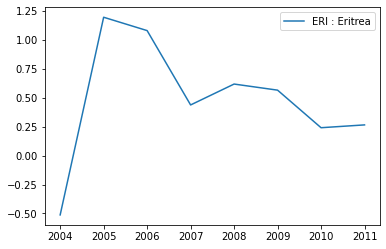

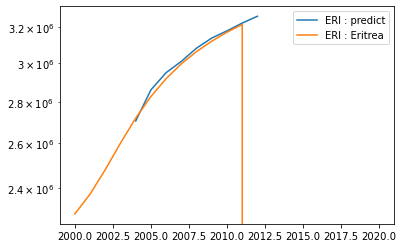

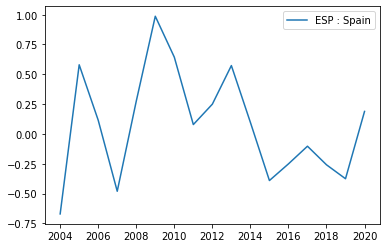

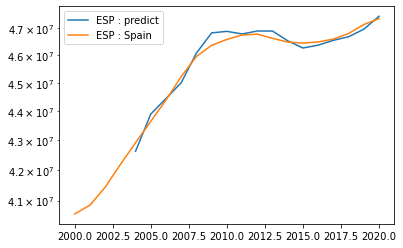

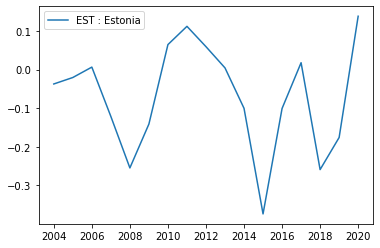

...

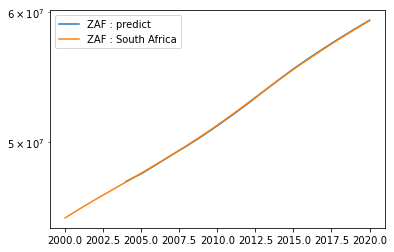

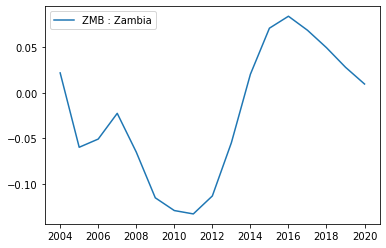

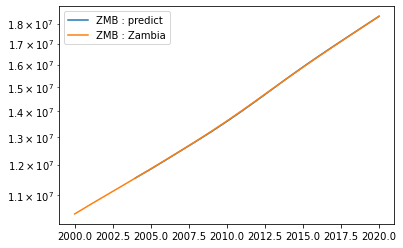

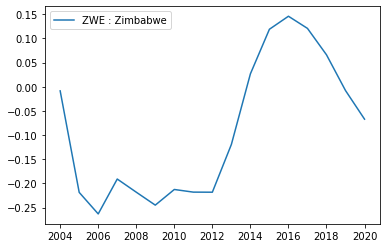

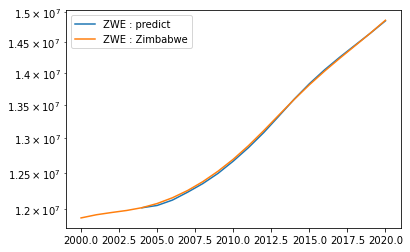

In [352]:
def fit_funtion(x, parameters):
    return np.exp(parameters[1])*np.exp(x*parameters[0])

for country in countries: 
    full_name_country = df[df['countryiso3code']==country]['country'].values[0]['value']
    x = df_group.loc[country].index.tolist()
    y = df_group.loc[country].values.tolist()
    
    x_adjustment = []
    y_adjustment = []
    delta_y_adjustment = []
    delta_y_adjustment_normal = []
    for j in range(len(x)-4):
        
        x1 = [x[i] for i in range(j,j+4)]
        y1 = [y[i] for i in range(j,j+4)]
        parameters, res, _, _, _  = np.polyfit(x1, np.log(y1), 1, full=True)
        
        if len(delta_y_adjustment) >= 2: 
            adjustment = np.mean(delta_y_adjustment[-2:])
        elif len(delta_y_adjustment) == 1: 
            adjustment = delta_y_adjustment[0]
        else: 
            adjustment = 0.1
       
        y_predict = fit_funtion(x[j+4], parameters) - adjustment
        
        # print('x1 values: ', x1)
        # print('ano: ', x[j+4], 'predict: ', y_predict, 'real: ', y[j+4], 'diff: ', y_predict - y[j+4])
        
        x_adjustment.append(x[j+4])
        y_adjustment.append(y_predict)
        delta_y_adjustment.append(y_predict-y[j+4])
        delta_y_adjustment_normal.append((y_predict-y[j+4])*100/y[j+4])
    #print(delta_y_adjustment)
    plt.plot(x_adjustment, delta_y_adjustment_normal, label = country + ' : ' + full_name_country)
    #plt.plot(x, y, label = country + ' : ' + full_name_country)
    #plt.yscale("log")
    plt.legend()
    plt.show()
    
    plt.plot(x_adjustment, y_adjustment, label = country + ' : predict')
    plt.plot(x, y, label = country + ' : ' + full_name_country)
    plt.yscale("log")
    plt.legend()
    plt.show()

## Machine Learning: Inclusion of other variables

In [37]:
# Net migration
# SM.POP.NETM	Net migration
seed = 'http://api.worldbank.org/v2/country/all/indicator/SM.POP.NETM?format=json'
#seed = 'http://api.worldbank.org/v2/country/all/indicator/SH.HIV.0014;SH.DYN.MORT?source=2&format=json'
response_seed = requests.get(seed).json()
df_1 = pd.DataFrame.from_dict(response_seed[1])

In [38]:
%%time
for page in range(2, response_seed[0]['pages']+1): 
#for page in range(2, 50): 
    url = 'http://api.worldbank.org/v2/country/all/indicator/SM.POP.NETM?page='+str(page)+'&format=json'
    response = requests.get(url).json()
    df_1 = df_1.append(pd.DataFrame.from_dict(response[1]), ignore_index=True)
    print(page)

2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
27

In [39]:
df_1.to_csv('data/df_1.csv', index=False)

In [40]:
%%time
# SP.DYN.AMRT.MA	Mortality rate, adult, male (per 1,000 male adults): SÍ
seed = 'http://api.worldbank.org/v2/country/all/indicator/SP.DYN.AMRT.MA?format=json'
#seed = 'http://api.worldbank.org/v2/country/all/indicator/SH.HIV.0014;SH.DYN.MORT?source=2&format=json'
response_seed = requests.get(seed).json()
df_2 = pd.DataFrame.from_dict(response_seed[1])

CPU times: user 29 ms, sys: 18.1 ms, total: 47 ms
Wall time: 363 ms


In [41]:
%%time
for page in range(2, response_seed[0]['pages']+1): 
#for page in range(2, 50): 
    url = 'http://api.worldbank.org/v2/country/all/indicator/SP.DYN.AMRT.MA?page='+str(page)+'&format=json'
    response = requests.get(url).json()
    df_2 = df_2.append(pd.DataFrame.from_dict(response[1]), ignore_index=True)
    print(page)

2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
27

In [42]:
df_2.to_csv('data/df_2.csv', index=False)

In [43]:
%%time
# SP.DYN.AMRT.FE	Mortality rate, adult, female (per 1,000 female adults)
seed = 'http://api.worldbank.org/v2/country/all/indicator/SP.DYN.AMRT.FE?format=json'
#seed = 'http://api.worldbank.org/v2/country/all/indicator/SH.HIV.0014;SH.DYN.MORT?source=2&format=json'
response_seed = requests.get(seed).json()
df_3 = pd.DataFrame.from_dict(response_seed[1])

CPU times: user 30.4 ms, sys: 18.9 ms, total: 49.3 ms
Wall time: 497 ms


In [44]:
%%time
for page in range(2, response_seed[0]['pages']+1): 
#for page in range(2, 50): 
    url = 'http://api.worldbank.org/v2/country/all/indicator/SP.DYN.AMRT.FE?page='+str(page)+'&format=json'
    response = requests.get(url).json()
    df_3 = df_3.append(pd.DataFrame.from_dict(response[1]), ignore_index=True)
    print(page)

2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
27

In [45]:
df_3.to_csv('data/df_3.csv', index=False)

In [28]:
%%time
# SP.DYN.TFRT.IN	Fertility rate, total (births per woman)
seed = 'http://api.worldbank.org/v2/country/all/indicator/SP.DYN.TFRT.IN?format=json'
#seed = 'http://api.worldbank.org/v2/country/all/indicator/SH.HIV.0014;SH.DYN.MORT?source=2&format=json'
response_seed = requests.get(seed).json()
df_4 = pd.DataFrame.from_dict(response_seed[1])

CPU times: user 18.6 ms, sys: 2.71 ms, total: 21.3 ms
Wall time: 426 ms


In [29]:
%%time
for page in range(2, response_seed[0]['pages']+1): 
#for page in range(2, 50): 
    url = 'http://api.worldbank.org/v2/country/all/indicator/SP.DYN.TFRT.IN?page='+str(page)+'&format=json'
    response = requests.get(url).json()
    df_4 = df_4.append(pd.DataFrame.from_dict(response[1]), ignore_index=True)
    print(page)

2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
27

In [46]:
df_4.to_csv('data/df_4.csv', index=False)

In [66]:
df['date'] = df['date'].astype(float)
df_1['date'] = df_1['date'].astype(float)
df_2['date'] = df_2['date'].astype(float)
df_3['date'] = df_3['date'].astype(float)
df_4['date'] = df_4['date'].astype(float)

df_group = df[df['date']>=1990].groupby(['countryiso3code', 'date'])['value'].sum().copy()
df_group_1 = df_1[df_1['date']>=1990].groupby(['countryiso3code', 'date'])['value'].sum().copy()
df_group_2 = df_2[df_2['date']>=1990].groupby(['countryiso3code', 'date'])['value'].sum().copy()
df_group_3 = df_3[df_3['date']>=1990].groupby(['countryiso3code', 'date'])['value'].sum().copy()
df_group_4 = df_4[df_4['date']>=1990].groupby(['countryiso3code', 'date'])['value'].sum().copy()


In [67]:
df_group.to_csv('data/df_group.csv', index=True)
df_group_1.to_csv('data/df_group_1.csv', index=True)
df_group_2.to_csv('data/df_group_2.csv', index=True)
df_group_3.to_csv('data/df_group_3.csv', index=True)
df_group_4.to_csv('data/df_group_4.csv', index=True)

### Reading files 

In [114]:
df = pd.read_csv('data/df.csv')
df_1 = pd.read_csv('data/df_1.csv')
df_2 = pd.read_csv('data/df_2.csv')
df_3 = pd.read_csv('data/df_3.csv')
df_4 = pd.read_csv('data/df_4.csv')

df_group = pd.read_csv('data/df_group.csv', index_col = ['countryiso3code', 'date'])
df_group_1 = pd.read_csv('data/df_group_1.csv', index_col = ['countryiso3code', 'date'])
df_group_2 = pd.read_csv('data/df_group_2.csv', index_col = ['countryiso3code', 'date'])
df_group_3 = pd.read_csv('data/df_group_3.csv', index_col = ['countryiso3code', 'date'])
df_group_4 = pd.read_csv('data/df_group_4.csv', index_col = ['countryiso3code', 'date'])


In [115]:
df_all = df_group_1.merge(df_group_2, how='outer', 
                            on=['countryiso3code', 'date'], 
                            suffixes=('_1', '_2')
                           ).merge(df_group_3, how='outer', 
                            on=['countryiso3code', 'date']
                                  ).merge(df_group_4, how='outer', 
                                          on=['countryiso3code', 'date'], 
                                          suffixes=('_3', '_4')
                                         ).merge(df_group, how='outer',
                                                 on=['countryiso3code', 'date']
                                                )

df_all.reset_index(level=['date'], inplace=True)

In [116]:
countries = df_all.index.get_level_values(0).unique()
print('No. Total countries: ', len(countries))


No. Total countries:  260


/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


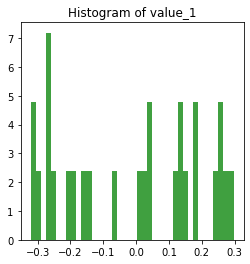

/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


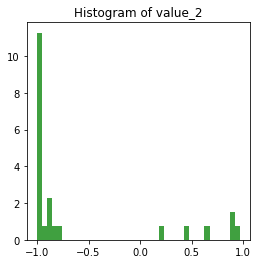

/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


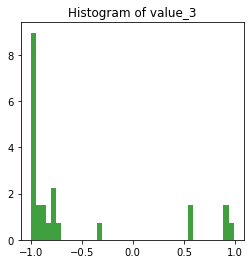

/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


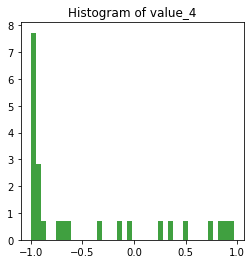

In [117]:
for value_i in ['value_1', 'value_2', 'value_3', 'value_4']:
    value_i_list = []
    
    for country in countries[0:30]:
        y = df_all[df_all['date']!=2020].loc[country][value_i].values
        y2 = np.log(df_all[df_all['date']!=2020].loc[country]['value'].values.tolist())
        value_i_list.append(pearsonr(y,y2)[0])
        
    plt.figure(figsize=(4, 4))
    plt.title('Histogram of '+value_i)
    plt.hist(value_i_list, 40, density=True, facecolor='g', alpha=0.75)
    plt.show()

In [118]:
df_all['value_log'] = np.log(df_all['value'])

/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/pandas/core/arraylike.py:358: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


### I want to predict value_log column using the others one (date, value_1m value_2, vlaue_3 and value_4) using Machine learning algorithms

- K-Nearest Neighbor regression (KNN)
- Support Vector Regression (SVR)

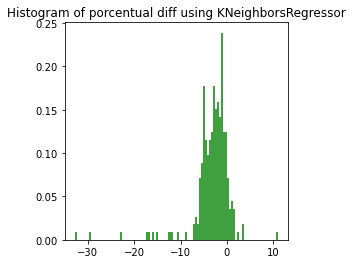

In [6]:
from sklearn.neighbors import KNeighborsRegressor

diff_porcentual = []
for country in countries:
    if country != 'ERI' and country != 'KWT': 
        X = df_all[df_all['date']<2019].loc[country][['date', 'value_1', 'value_2', 'value_3', 'value_4']]
        Y = df_all[df_all['date']<2019].loc[country]['value_log']
        neigh = KNeighborsRegressor(n_neighbors=2)
        neigh.fit(X.values, Y.values)
        X_to_predict = df_all[df_all['date']==2019].loc[country][['date', 'value_1', 'value_2', 'value_3', 'value_4']]
        Y_to_predict_real = df_all[df_all['date']==2019].loc[country]['value_log']
        Y_to_predict_fit = neigh.predict(X_to_predict.values.reshape(1,-1))
        diff_porcentual.append( (np.exp(Y_to_predict_fit[0]) - np.exp(Y_to_predict_real))*100/np.exp(Y_to_predict_real) )
    
plt.figure(figsize=(4, 4))
plt.title('Histogram of porcentual diff using KNeighborsRegressor')
plt.hist(diff_porcentual, 100, density=True, facecolor='g', alpha=0.75)
plt.show()

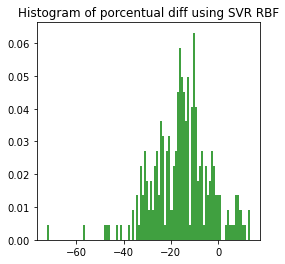

CPU times: user 851 ms, sys: 7.61 ms, total: 859 ms
Wall time: 858 ms


In [44]:
%%time

diff_porcentual = []

for country in countries:
    svr_rbf = SVR(kernel='rbf')
    
    if country != 'ERI' and country != 'KWT': 
        X = df_all[df_all['date']<2019].loc[country][['date', 'value_2', 'value_3', 'value_4']]
        Y = df_all[df_all['date']<2019].loc[country]['value_log']
        
        svr_rbf.fit(X.values, Y.values)
        
        X_to_predict = df_all[df_all['date']==2019].loc[country][['date', 'value_2', 'value_3', 'value_4']]
        Y_to_predict_real = df_all[df_all['date']==2019].loc[country]['value_log']
        
        Y_to_predict_fit = svr_rbf.predict(X_to_predict.values.reshape(1,-1))
        
        diff_porcentual.append( (np.exp(Y_to_predict_fit[0]) - np.exp(Y_to_predict_real))*100/np.exp(Y_to_predict_real) )
    
plt.figure(figsize=(4, 4))
plt.title('Histogram of porcentual diff using SVR RBF')
plt.hist(diff_porcentual, 100, density=True, facecolor='g', alpha=0.75)
plt.show()

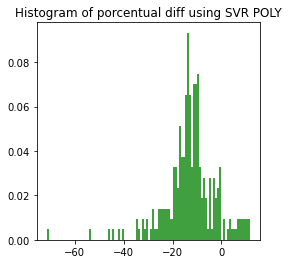

CPU times: user 836 ms, sys: 10.1 ms, total: 846 ms
Wall time: 846 ms


In [55]:
%%time
diff_porcentual = []

for country in countries:
    svr_poly = SVR(kernel='poly')
    
    if country != 'ERI' and country != 'KWT': 
        X = df_all[df_all['date']<2019].loc[country][['date', 'value_2', 'value_3', 'value_4']]
        Y = df_all[df_all['date']<2019].loc[country]['value_log']
        
        svr_poly.fit(X.values, Y.values)
        
        X_to_predict = df_all[df_all['date']==2019].loc[country][['date', 'value_2', 'value_3', 'value_4']]
        Y_to_predict_real = df_all[df_all['date']==2019].loc[country]['value_log']
        Y_to_predict_fit = svr_poly.predict(X_to_predict.values.reshape(1,-1))
        
        diff_porcentual.append( (np.exp(Y_to_predict_fit[0]) - np.exp(Y_to_predict_real))*100/np.exp(Y_to_predict_real) )
    
plt.figure(figsize=(4, 4))
plt.title('Histogram of porcentual diff using SVR POLY')
plt.hist(diff_porcentual, 100, density=True, facecolor='g', alpha=0.75)
plt.show()

## ML: KNeighborsRegressor

Country:  ABW


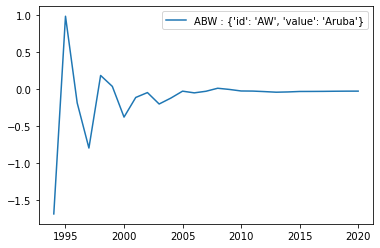

Country:  AFE


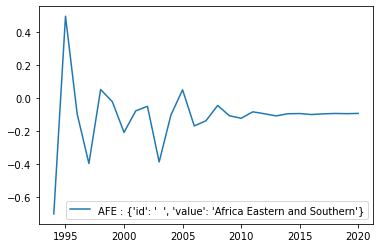

Country:  AFG


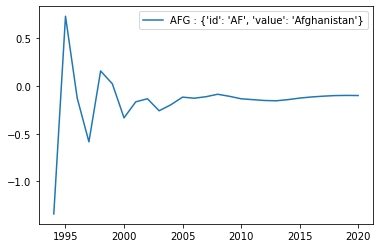

Country:  AGO


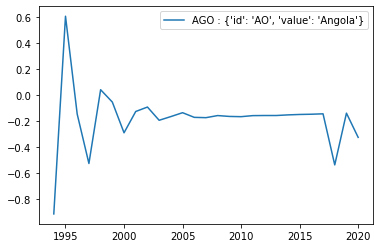

Country:  ALB


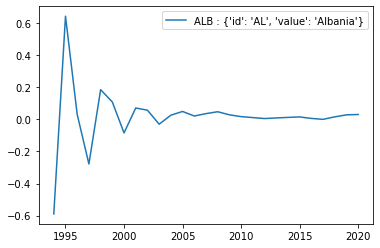

Country:  AND


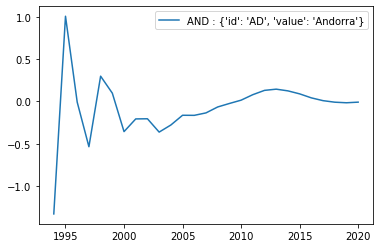

Country:  ARB


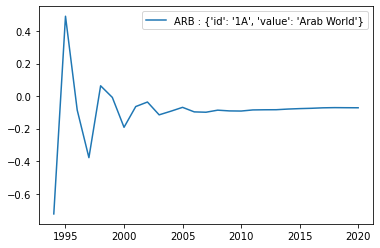

Country:  ARE


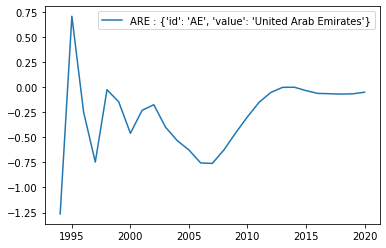

Country:  ARG


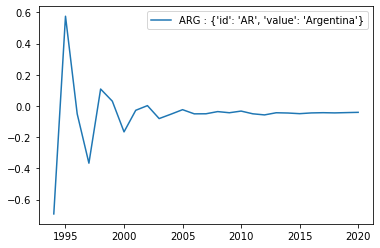

Country:  ARM


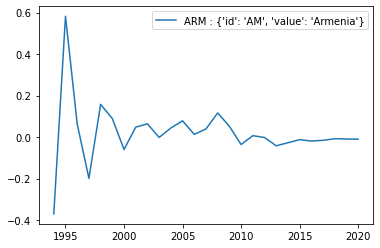

Country:  ASM


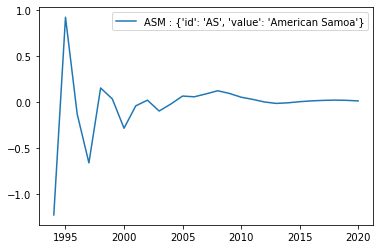

Country:  ATG


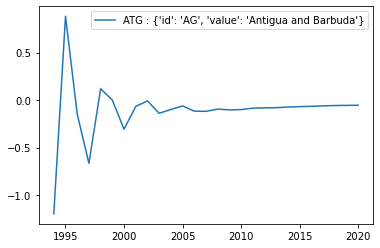

Country:  AUS


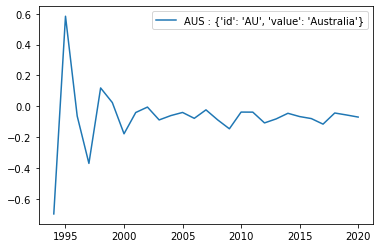

Country:  AUT


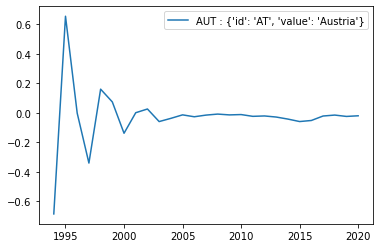

Country:  AZE


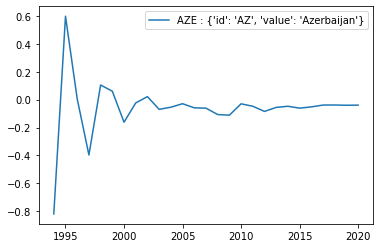

Country:  BDI


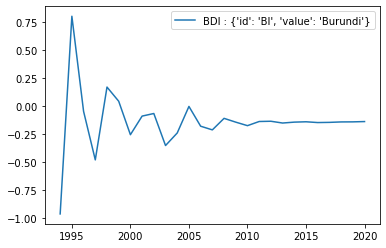

Country:  BEL


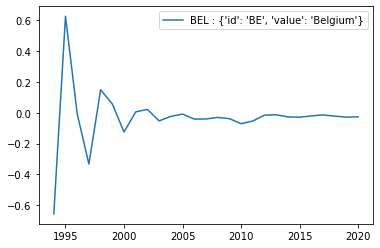

Country:  BEN


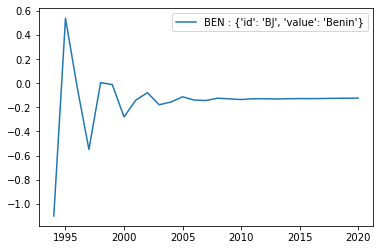

Country:  BFA


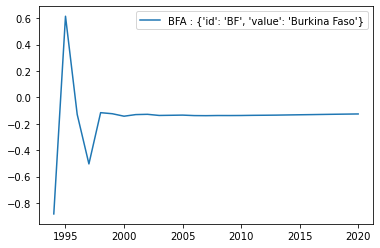

Country:  BGD


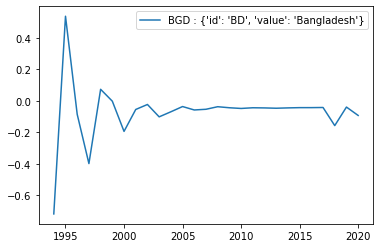

Country:  BGR


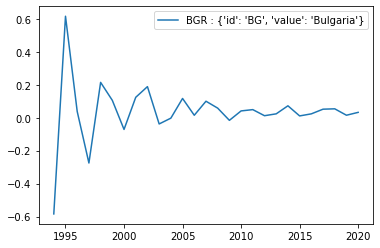

Country:  BHR


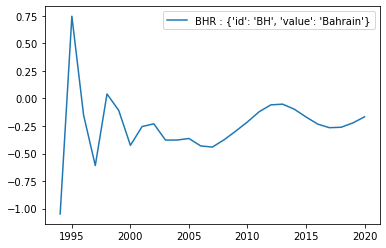

Country:  BHS


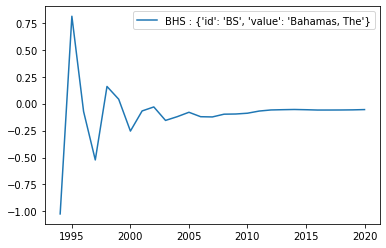

Country:  BIH


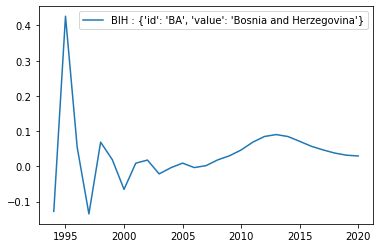

Country:  BLR


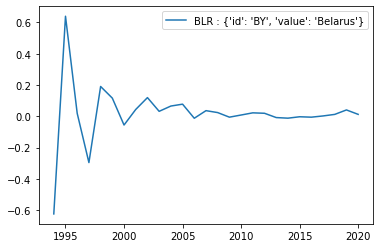

Country:  BLZ


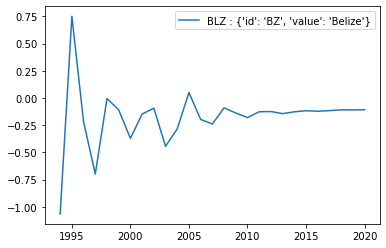

Country:  BMU


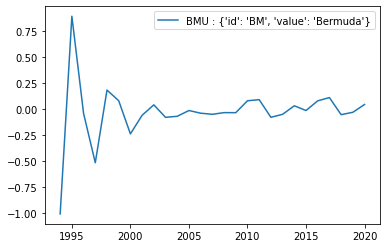

Country:  BOL


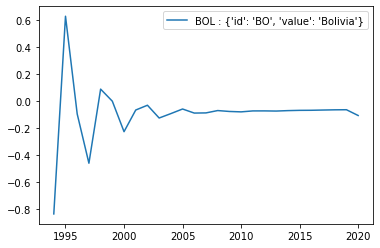

Country:  BRA


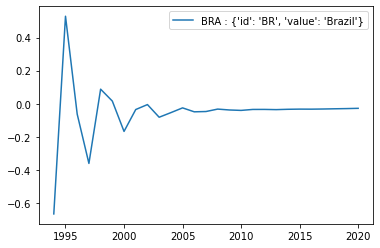

Country:  BRB


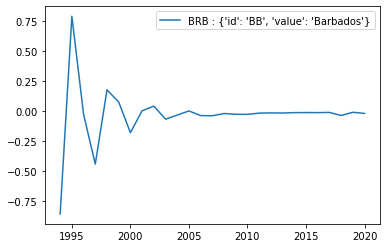

Country:  BRN


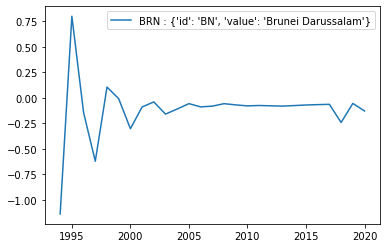

Country:  BTN


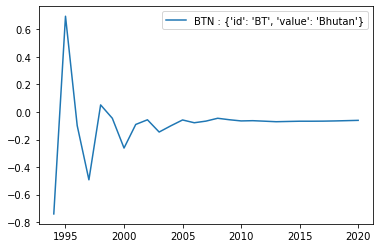

Country:  BWA


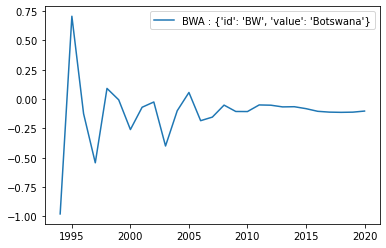

Country:  CAF


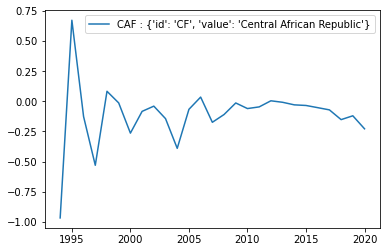

Country:  CAN


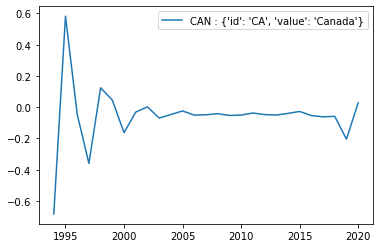

Country:  CEB


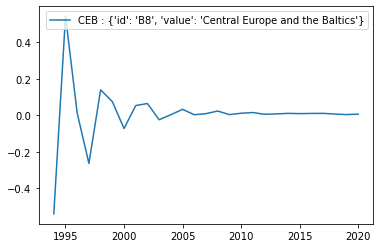

Country:  CHE


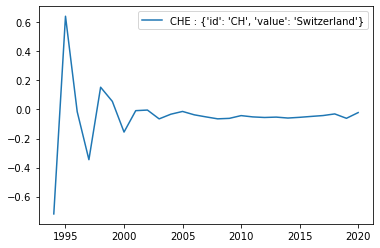

Country:  CHI


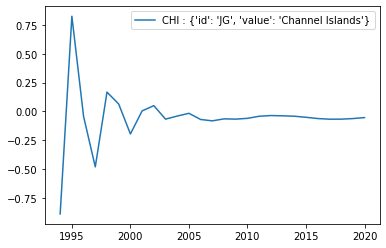

Country:  CHL


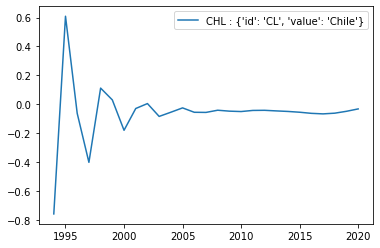

Country:  CHN


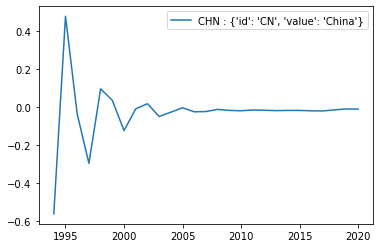

Country:  CIV


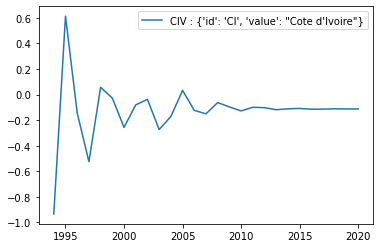

Country:  CMR


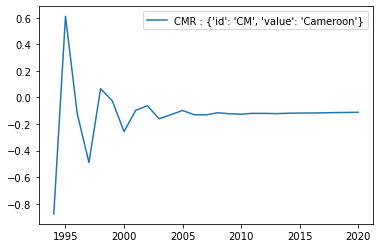

Country:  COD


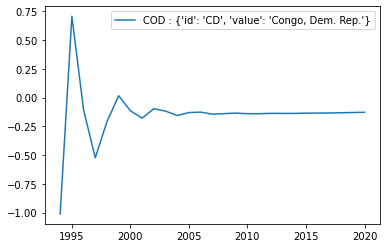

Country:  COG


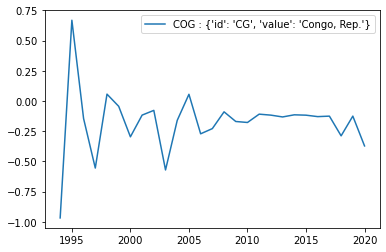

Country:  COL


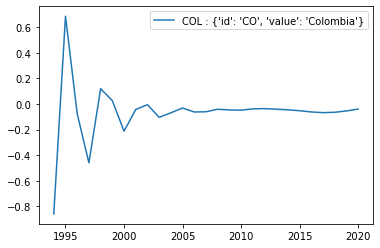

Country:  COM


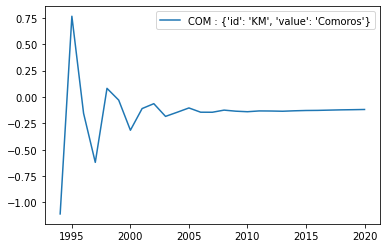

Country:  CPV


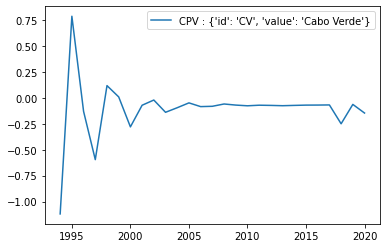

Country:  CRI


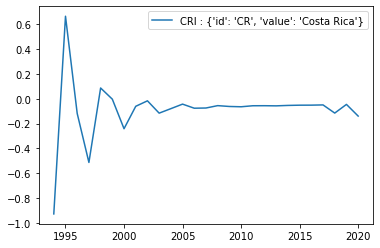

Country:  CSS


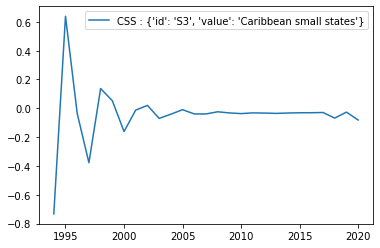

Country:  CUB


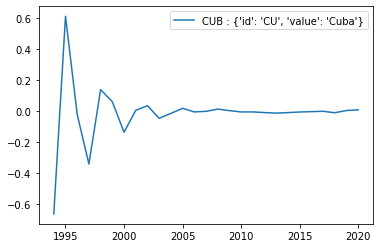

Country:  CUW


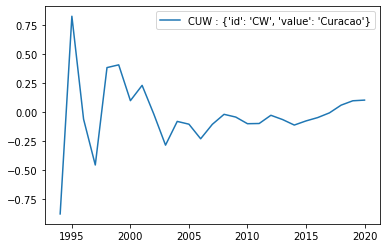

Country:  CYM


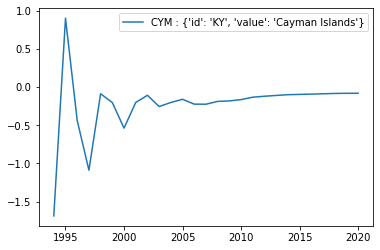

Country:  CYP


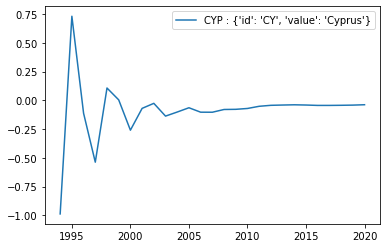

Country:  CZE


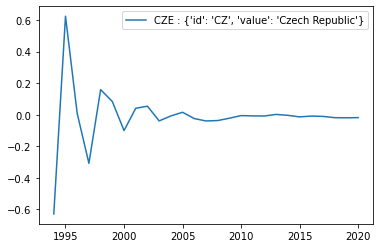

Country:  DEU


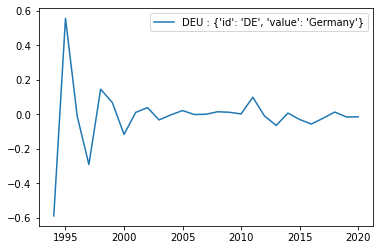

Country:  DJI


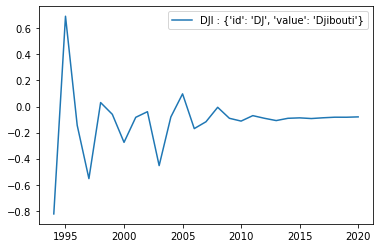

Country:  DMA


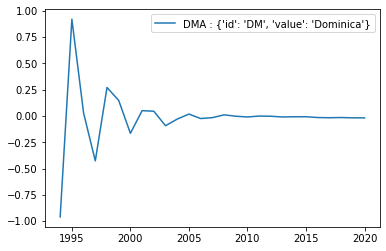

Country:  DNK


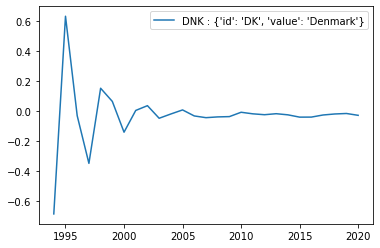

Country:  DOM


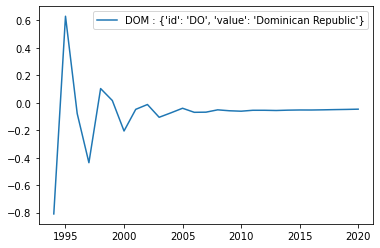

Country:  DZA


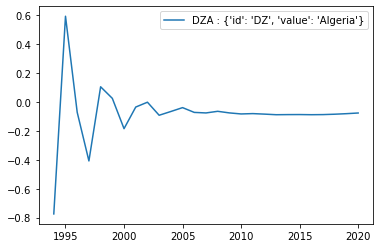

Country:  EAP


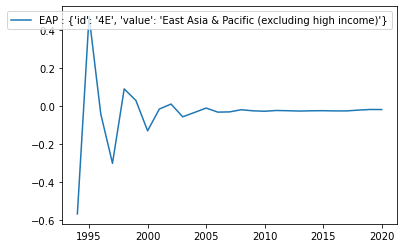

Country:  EAR


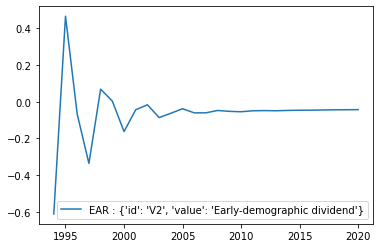

Country:  EAS


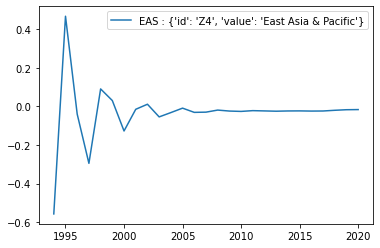

Country:  ECA


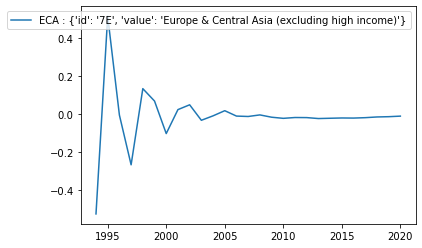

Country:  ECS


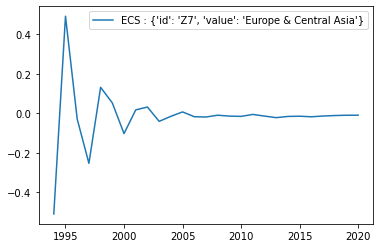

Country:  ECU


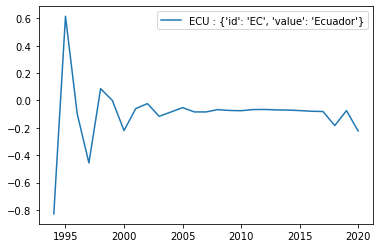

Country:  EGY


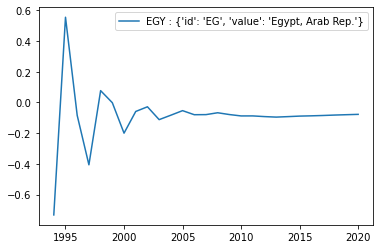

Country:  EMU


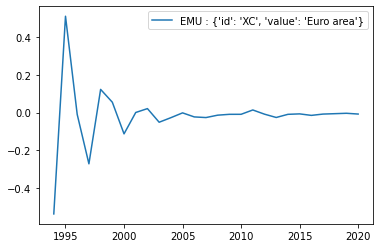

Country:  ERI
Country:  ESP


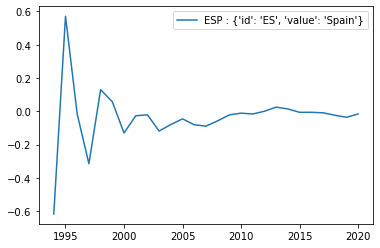

Country:  EST


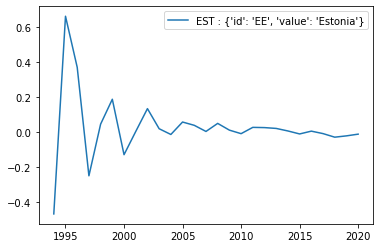

Country:  ETH


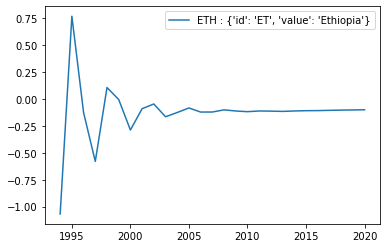

Country:  EUU


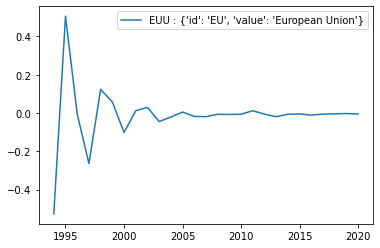

Country:  FCS


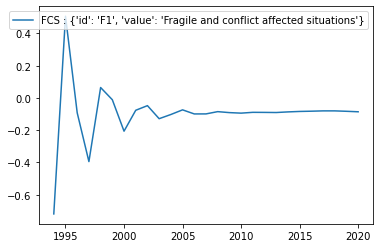

Country:  FIN


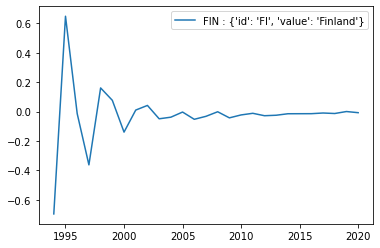

Country:  FJI


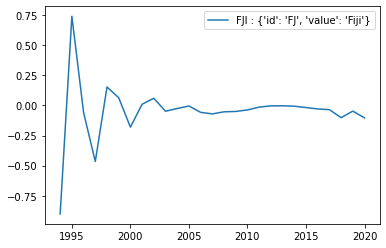

Country:  FRA


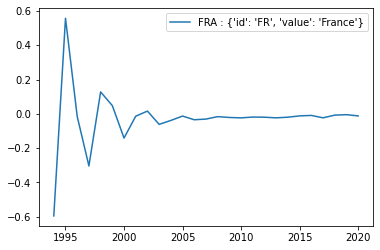

Country:  FRO


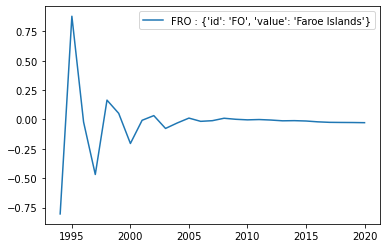

Country:  FSM


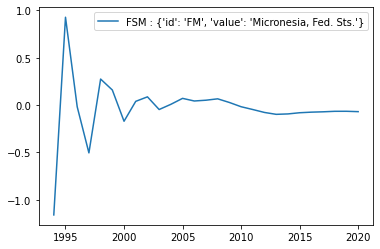

Country:  GAB


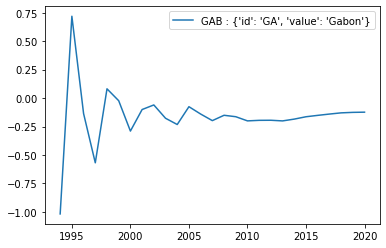

Country:  GBR


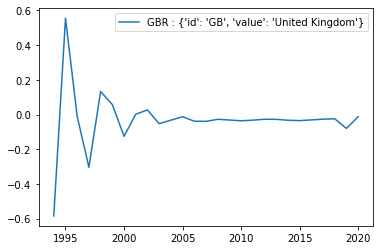

Country:  GEO


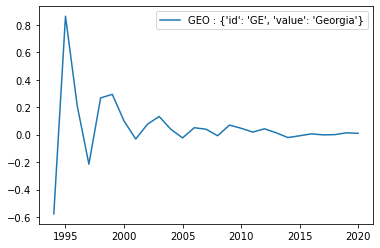

Country:  GHA


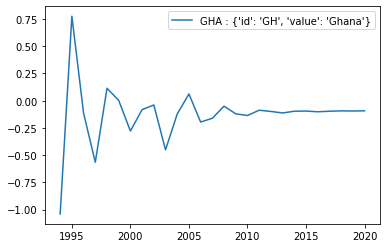

Country:  GIB


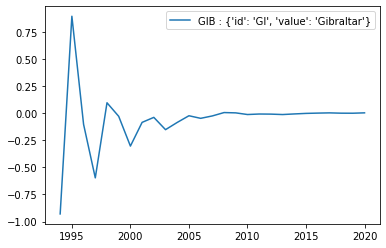

Country:  GIN


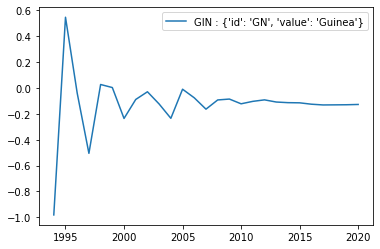

Country:  GMB


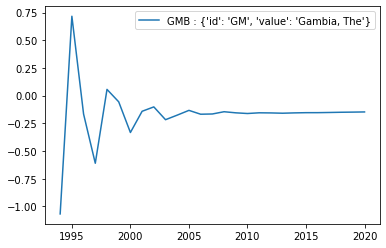

Country:  GNB


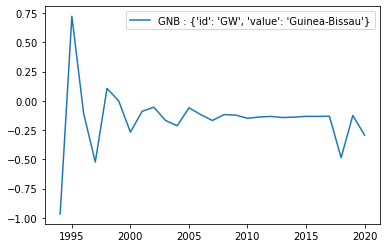

Country:  GNQ


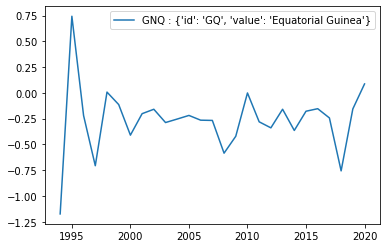

Country:  GRC


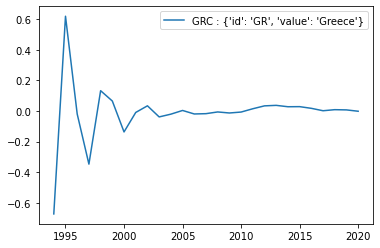

Country:  GRD


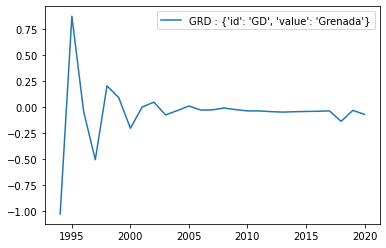

Country:  GRL


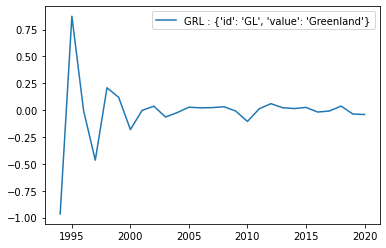

Country:  GTM


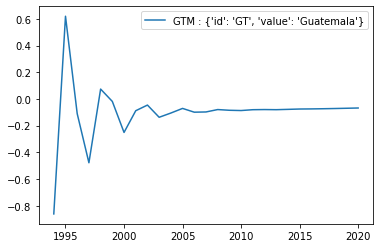

Country:  GUM


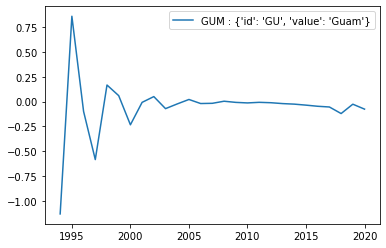

Country:  GUY


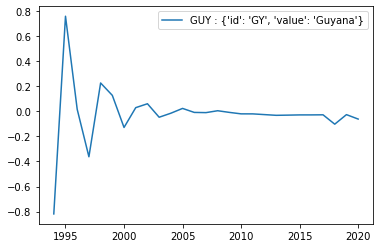

Country:  HKG


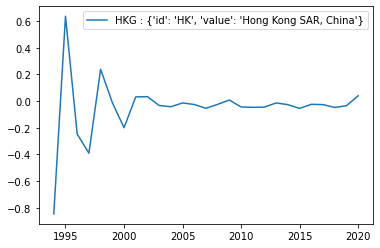

Country:  HND


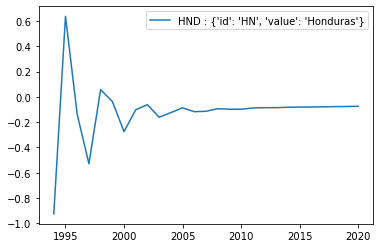

Country:  HPC


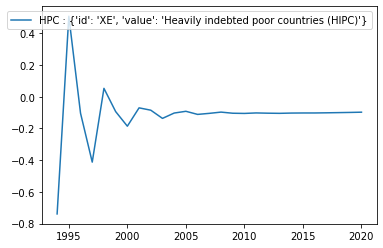

Country:  HRV


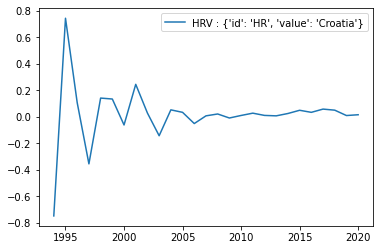

Country:  HTI


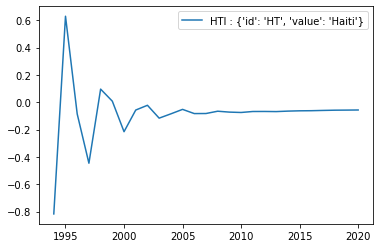

Country:  HUN


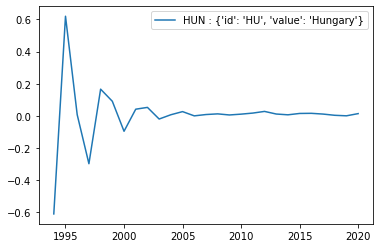

Country:  IBD


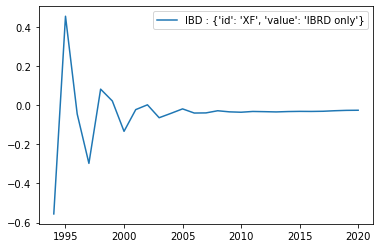

Country:  IBT


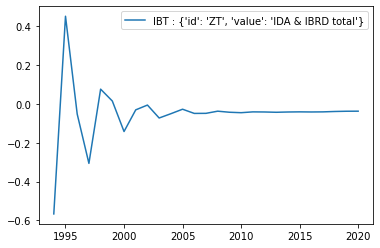

Country:  IDA


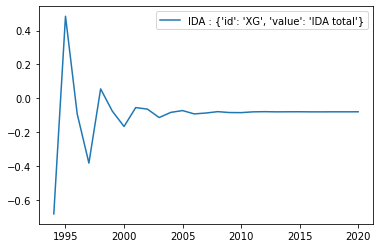

Country:  IDB


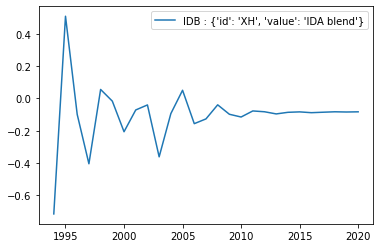

Country:  IDN


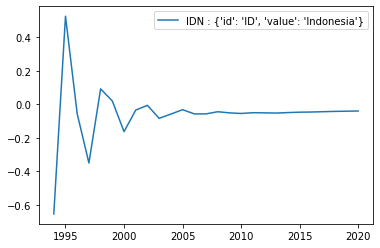

Country:  IDX


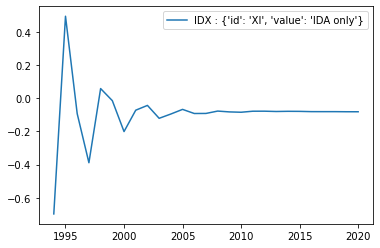

Country:  IMN


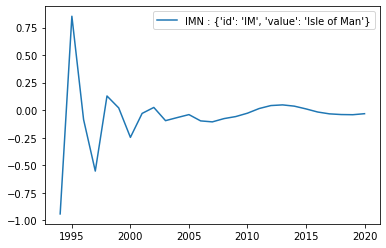

Country:  IND


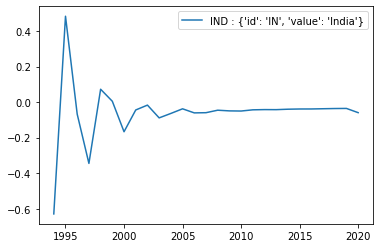

Country:  IRL


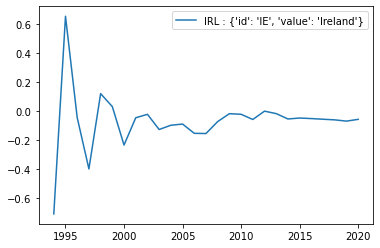

Country:  IRN


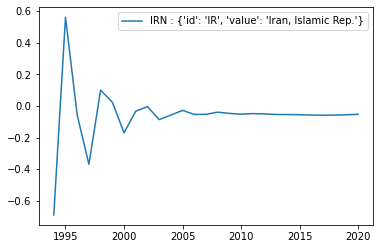

Country:  IRQ


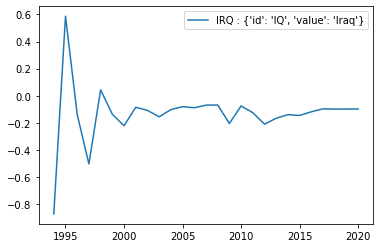

Country:  ISL


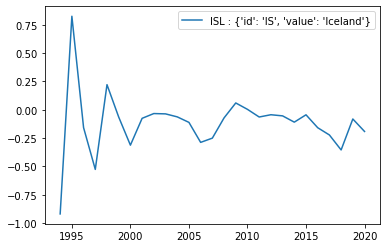

Country:  ISR


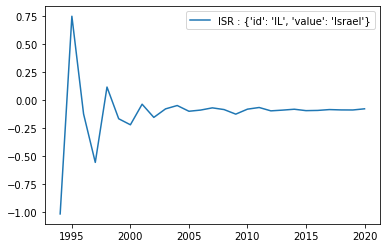

Country:  ITA


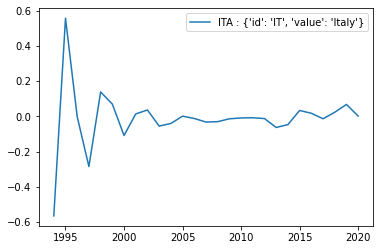

Country:  JAM


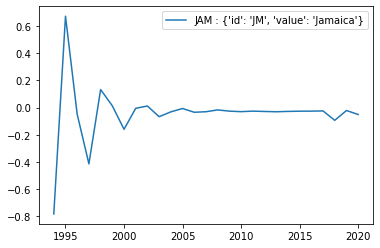

Country:  JOR


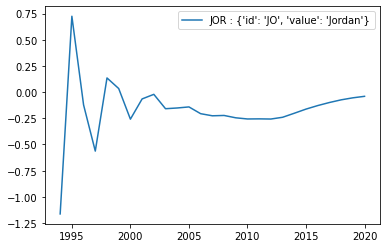

Country:  JPN


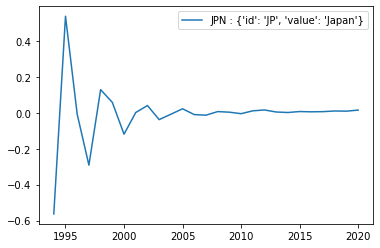

Country:  KAZ


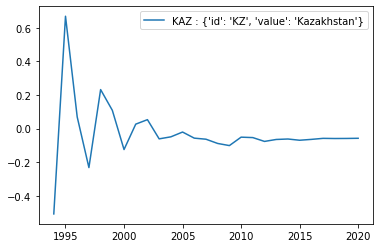

Country:  KEN


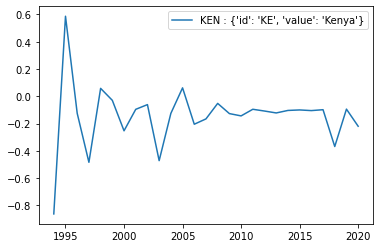

Country:  KGZ


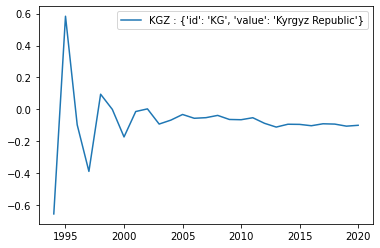

Country:  KHM


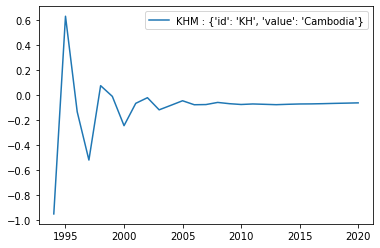

Country:  KIR


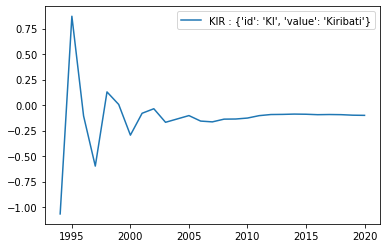

Country:  KNA


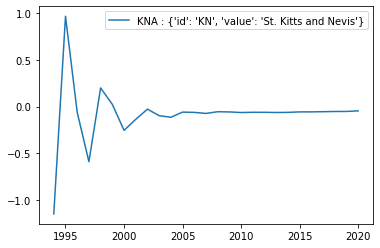

Country:  KOR


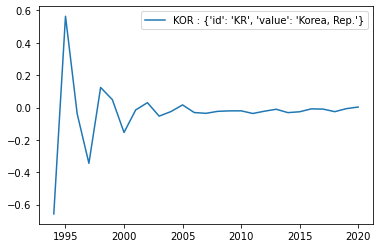

Country:  KWT
Country:  LAC


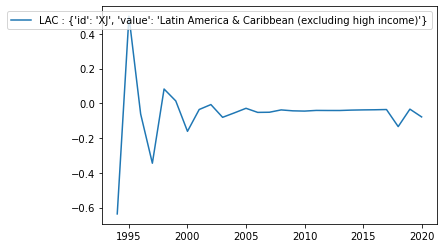

Country:  LAO


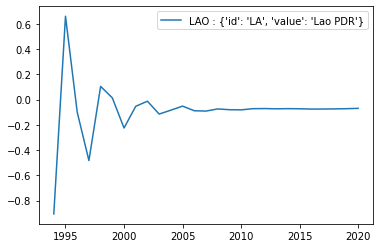

Country:  LBN


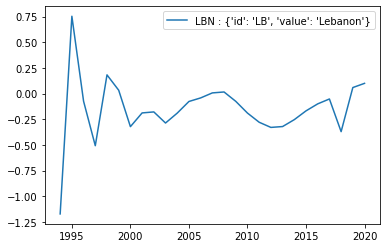

Country:  LBR


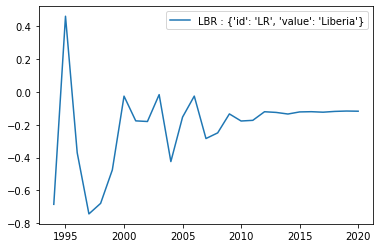

Country:  LBY


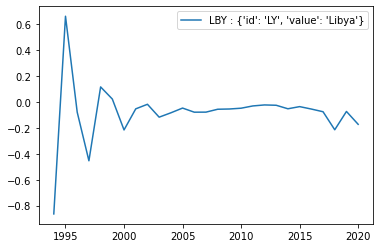

Country:  LCA


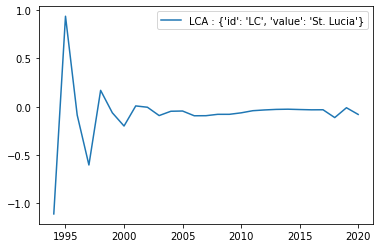

Country:  LCN


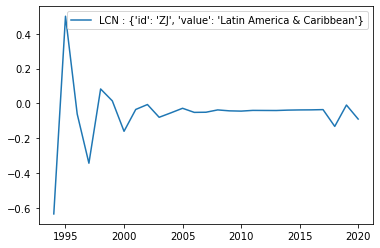

Country:  LDC


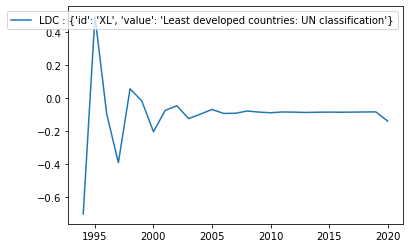

Country:  LIE


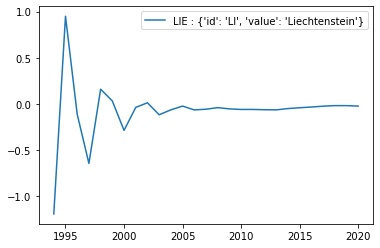

Country:  LKA


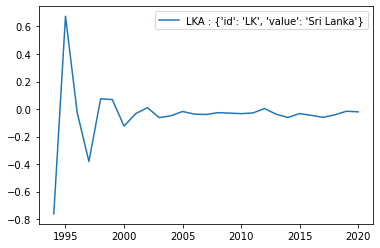

Country:  LMY


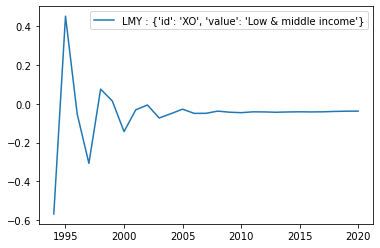

Country:  LSO


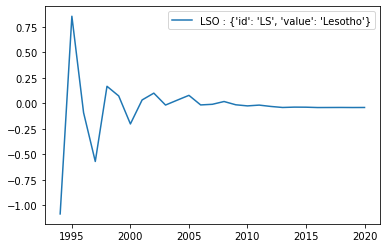

Country:  LTE


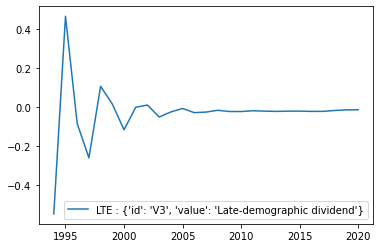

Country:  LTU


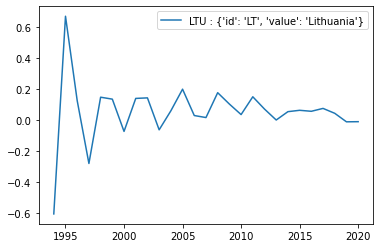

Country:  LUX


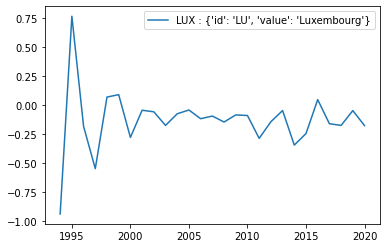

Country:  LVA


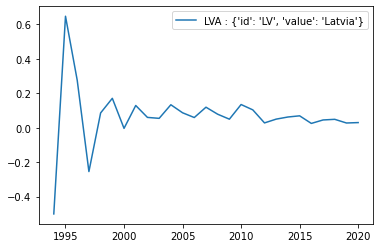

Country:  MAC


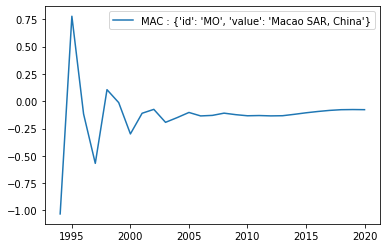

Country:  MAF


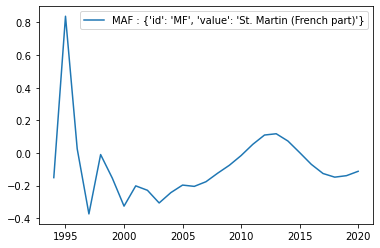

Country:  MAR


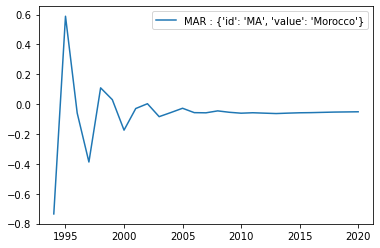

Country:  MCO


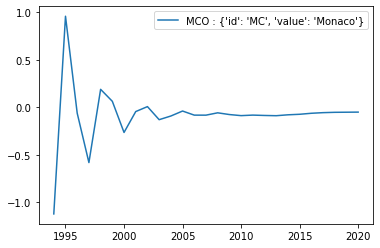

Country:  MDA


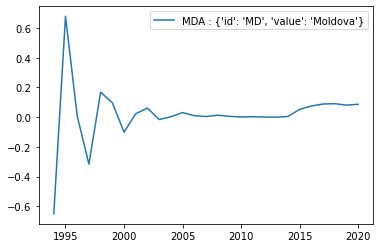

Country:  MDG


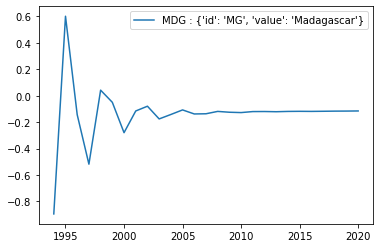

Country:  MDV


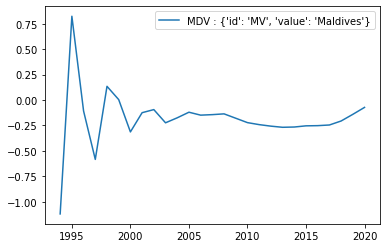

Country:  MEA


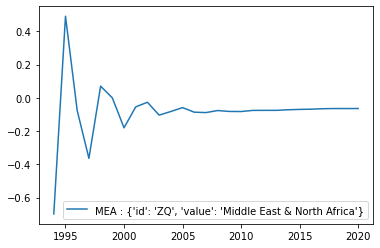

Country:  MEX


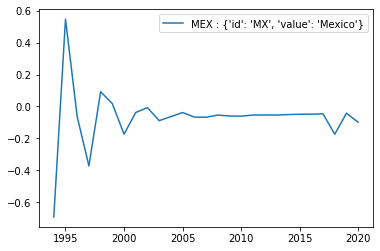

Country:  MHL


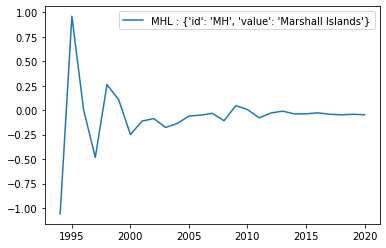

Country:  MIC


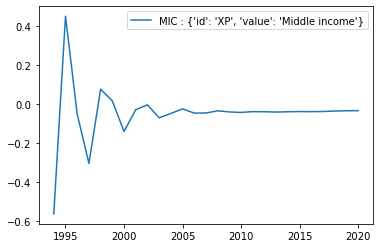

Country:  MKD


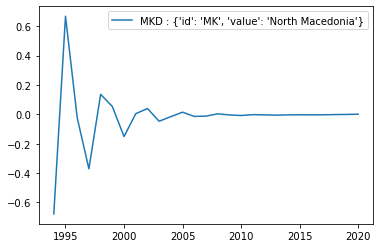

Country:  MLI


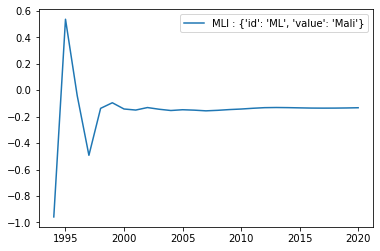

Country:  MLT


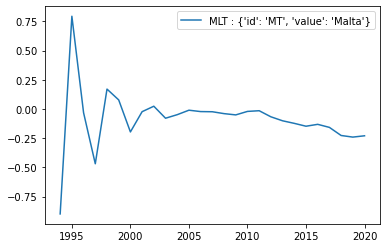

Country:  MMR


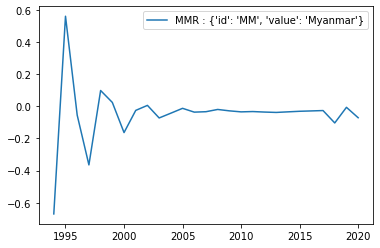

Country:  MNA


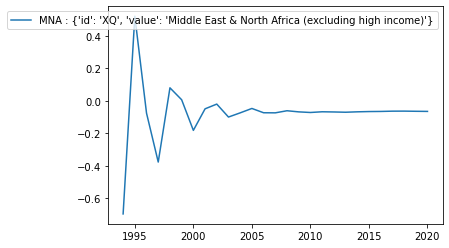

Country:  MNE


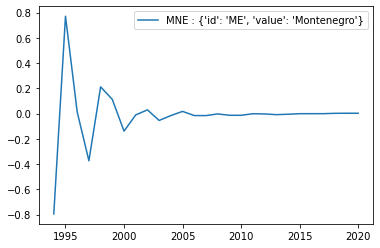

Country:  MNG


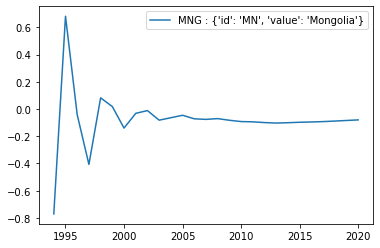

Country:  MNP


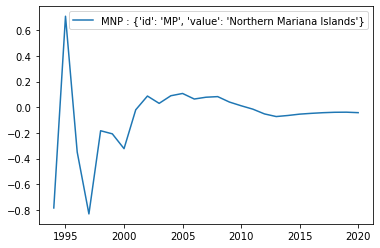

Country:  MOZ


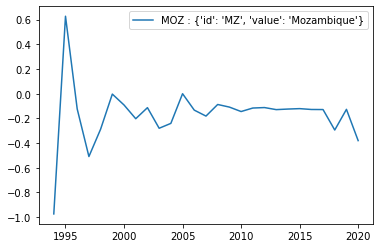

Country:  MRT


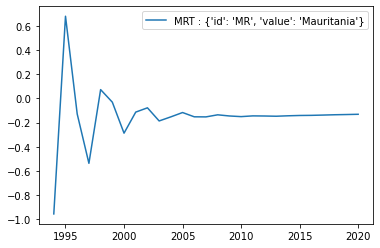

Country:  MUS


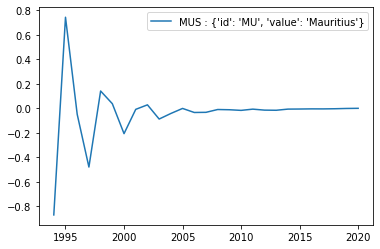

Country:  MWI


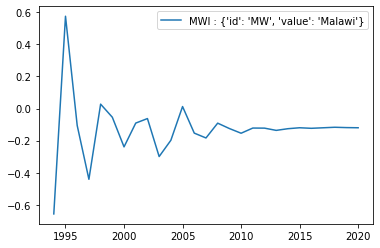

Country:  MYS


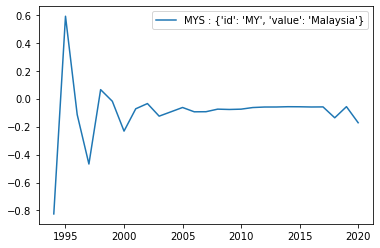

Country:  NAC


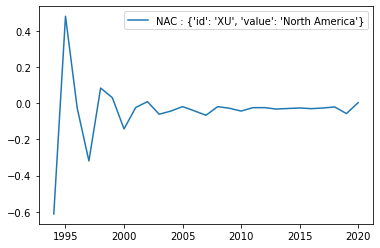

Country:  NAM


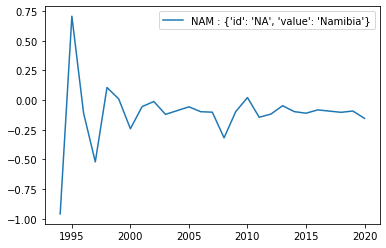

Country:  NCL


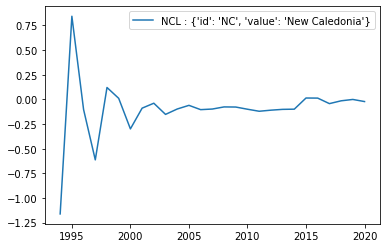

Country:  NER


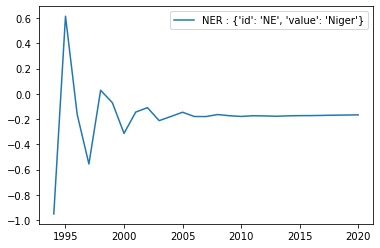

Country:  NGA


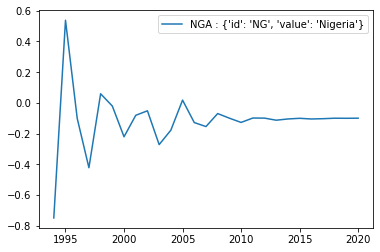

Country:  NIC


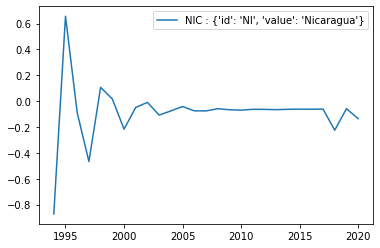

Country:  NLD


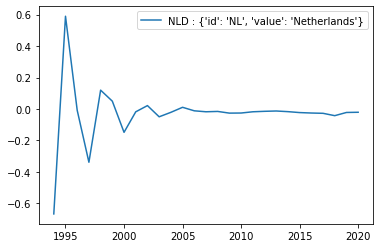

Country:  NOR


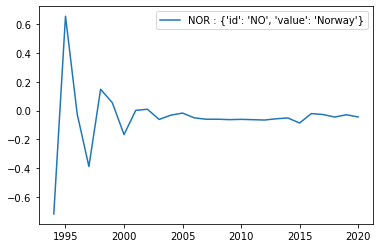

Country:  NPL


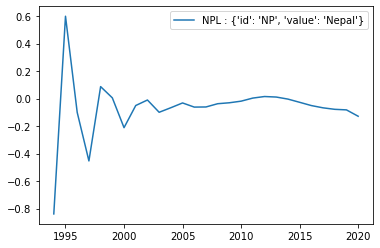

Country:  NRU


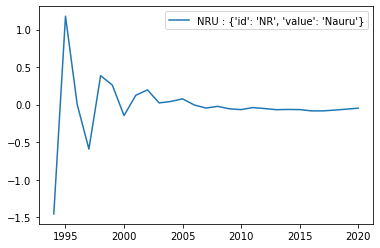

Country:  NZL


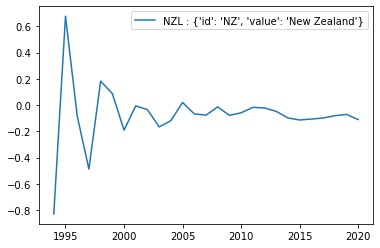

Country:  OED


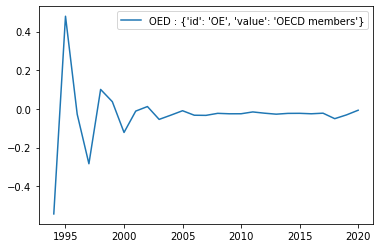

Country:  OMN


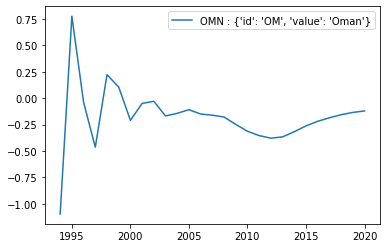

Country:  OSS


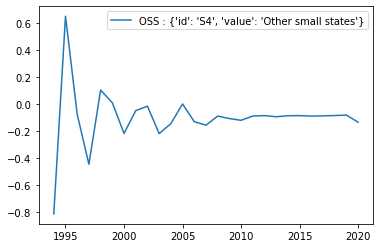

Country:  PAK


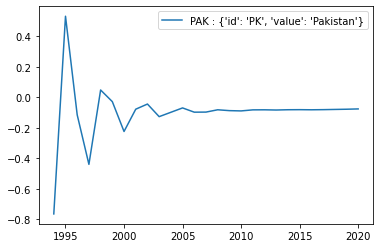

Country:  PAN


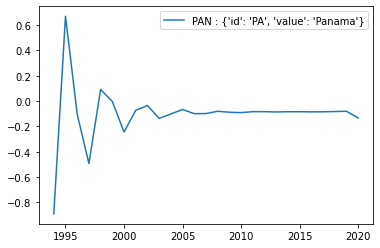

Country:  PER


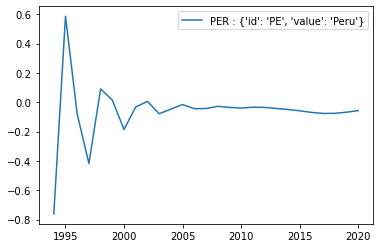

Country:  PHL


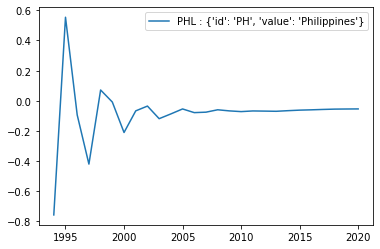

Country:  PLW


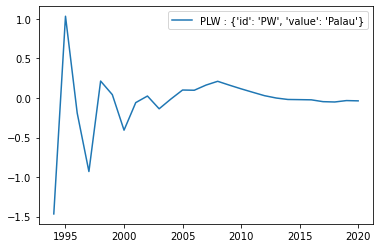

Country:  PNG


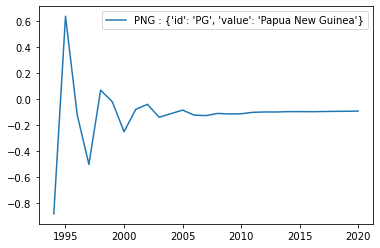

Country:  POL


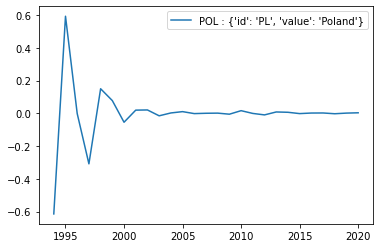

Country:  PRE


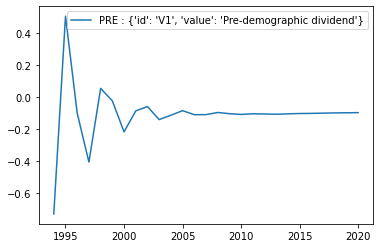

Country:  PRI


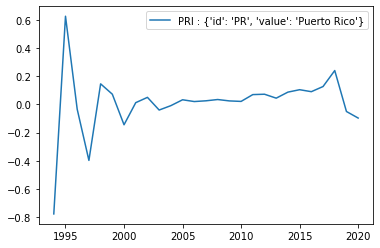

Country:  PRK


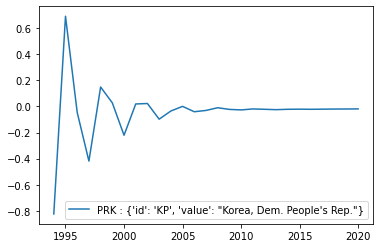

Country:  PRT


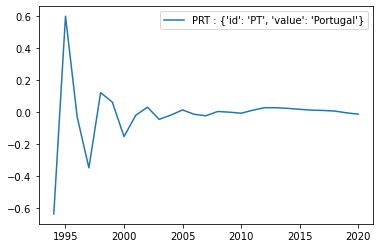

Country:  PRY


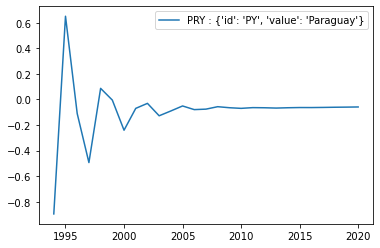

Country:  PSE


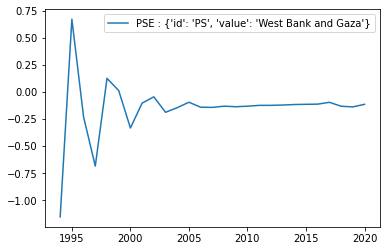

Country:  PSS


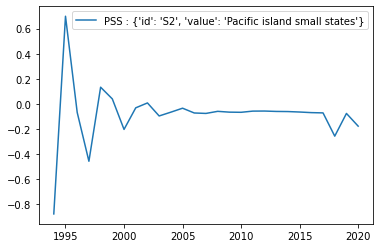

Country:  PST


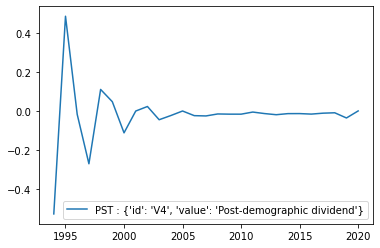

Country:  PYF


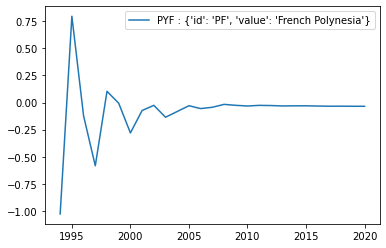

Country:  QAT


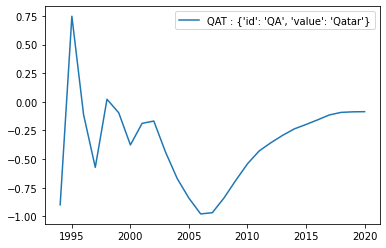

Country:  ROU


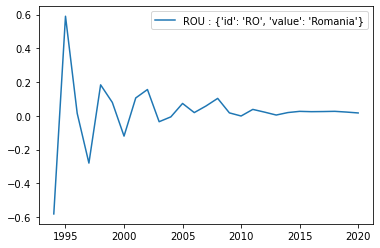

Country:  RUS


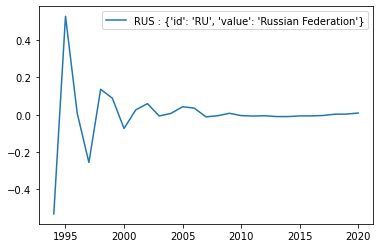

Country:  RWA


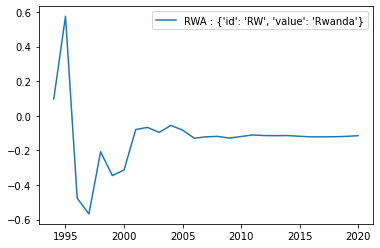

Country:  SAS


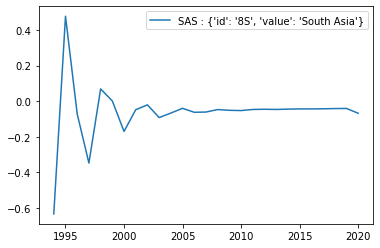

Country:  SAU


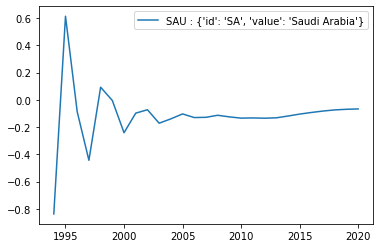

Country:  SDN


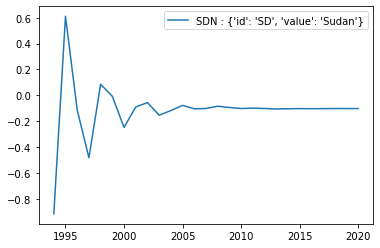

Country:  SEN


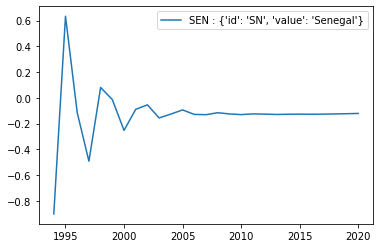

Country:  SGP


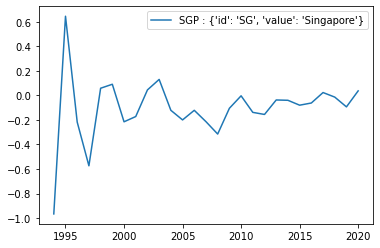

Country:  SLB


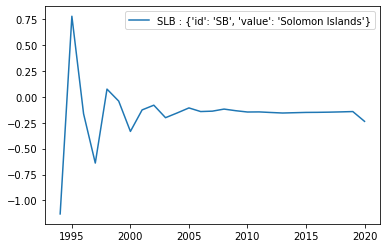

Country:  SLE


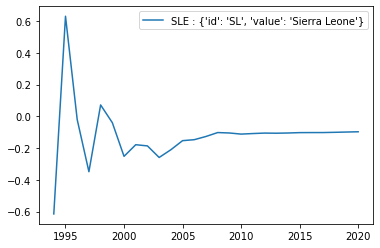

Country:  SLV


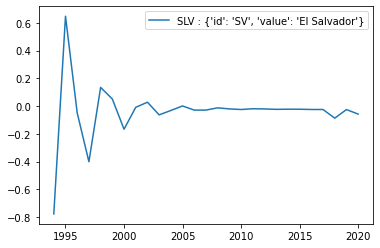

Country:  SMR


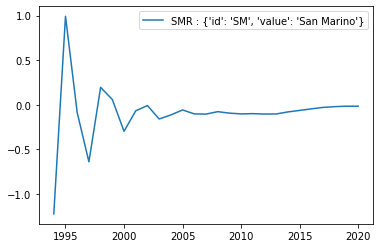

Country:  SOM


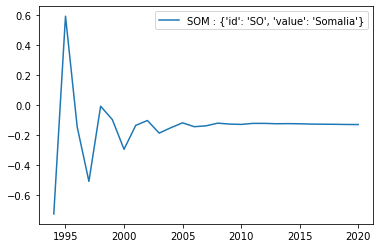

Country:  SRB


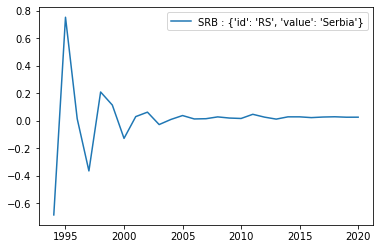

Country:  SSA


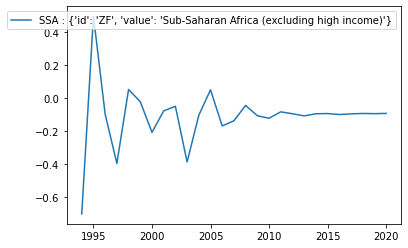

Country:  SSD


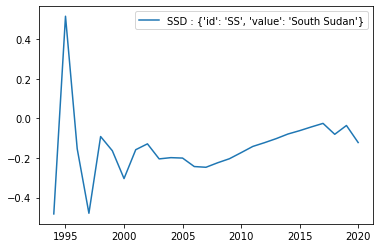

Country:  SSF


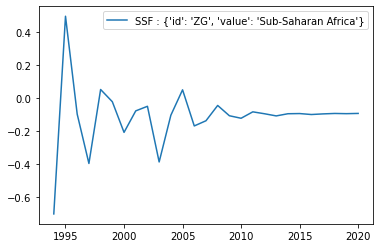

Country:  SST


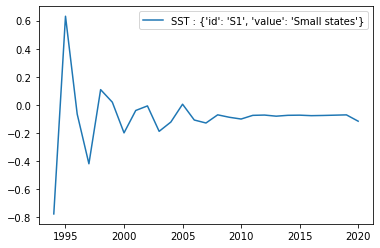

Country:  STP


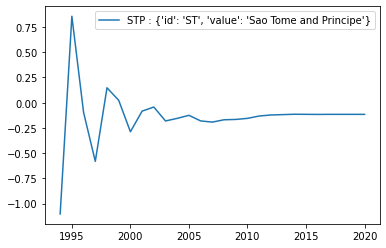

Country:  SUR


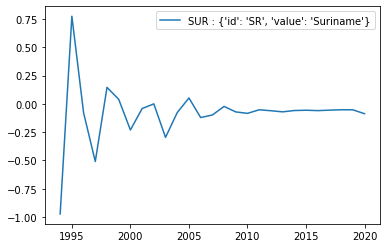

Country:  SVK


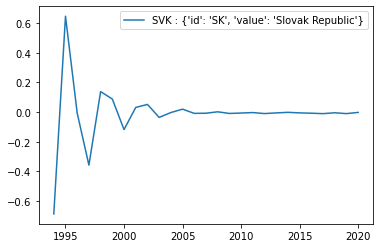

Country:  SVN


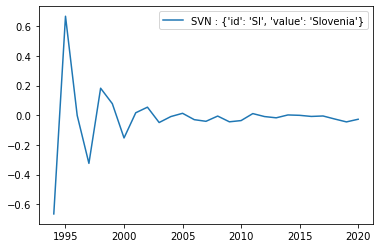

Country:  SWE


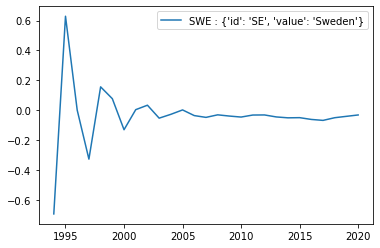

Country:  SWZ


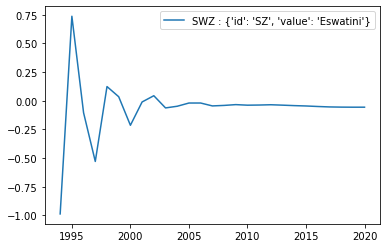

Country:  SXM


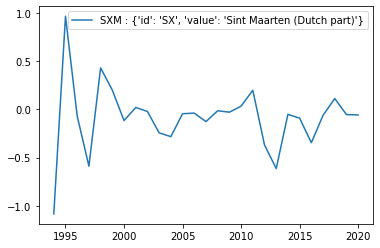

Country:  SYC


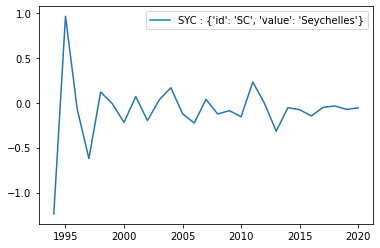

Country:  SYR


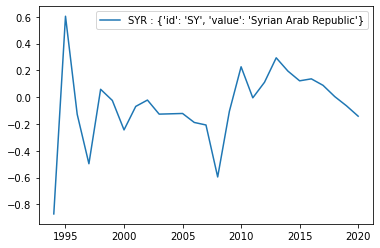

Country:  TCA


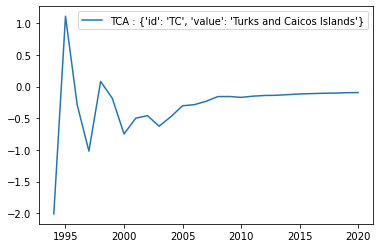

Country:  TCD


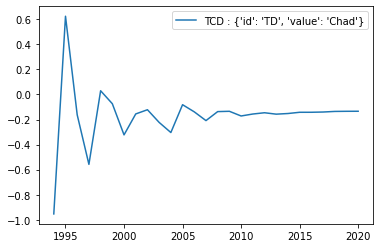

Country:  TEA


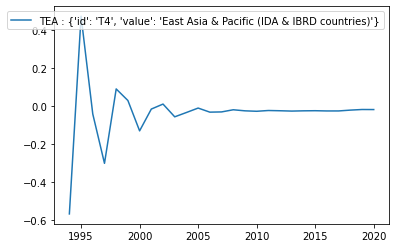

Country:  TEC


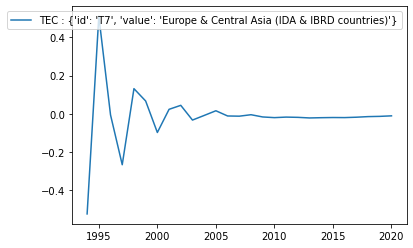

Country:  TGO


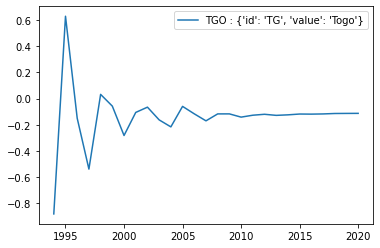

Country:  THA


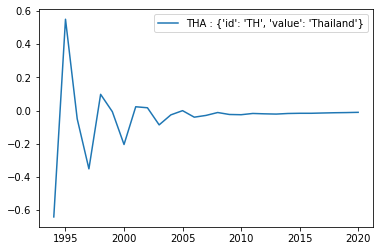

Country:  TJK


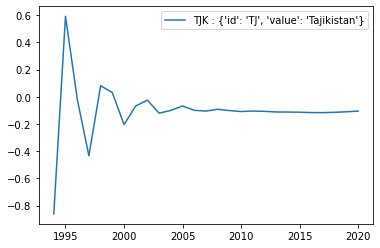

Country:  TKM


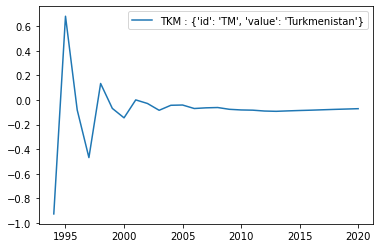

Country:  TLA


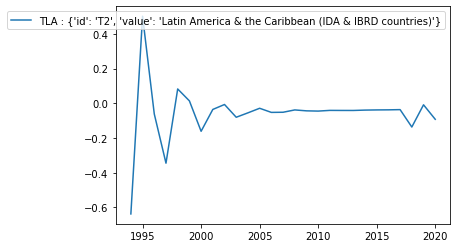

Country:  TLS


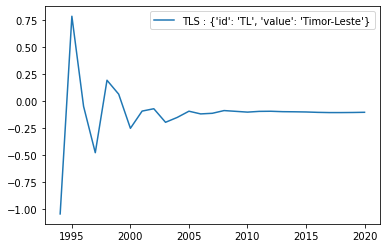

Country:  TMN


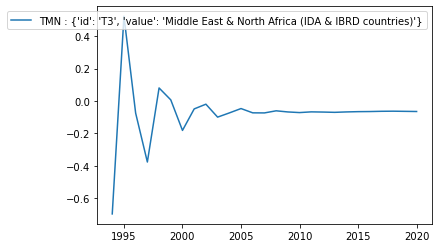

Country:  TON


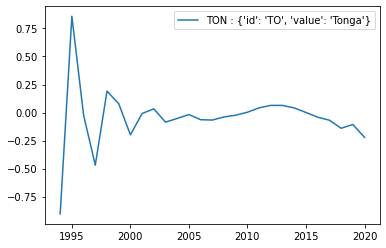

Country:  TSA


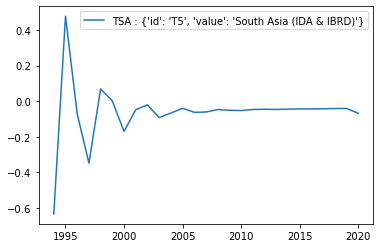

Country:  TSS


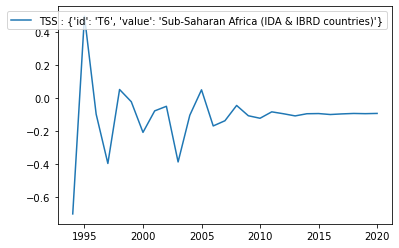

Country:  TTO


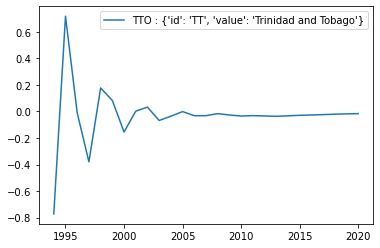

Country:  TUN


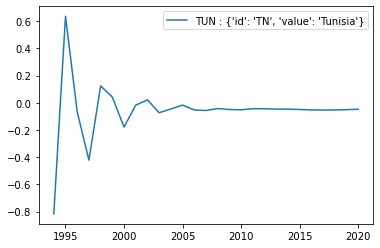

Country:  TUR


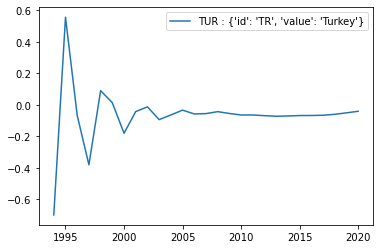

Country:  TUV


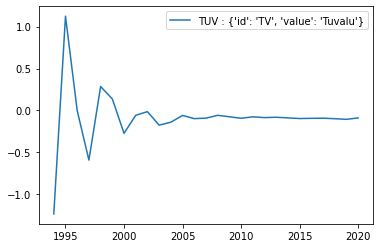

Country:  TZA


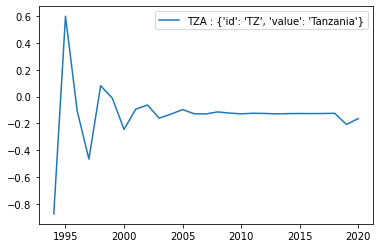

Country:  UGA


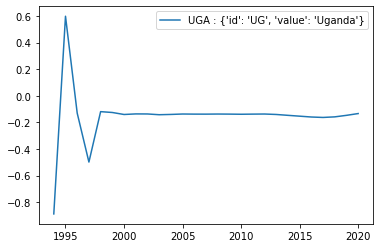

Country:  UKR


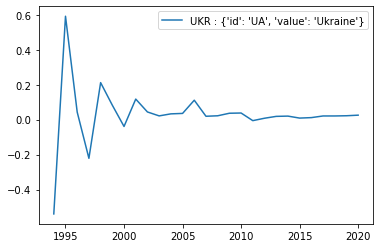

Country:  URY


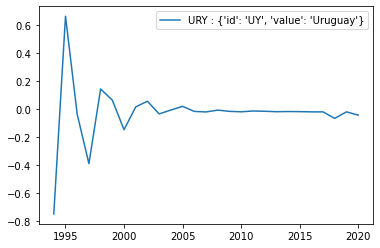

Country:  USA


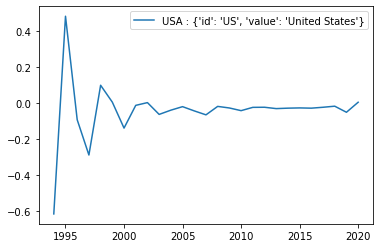

Country:  UZB


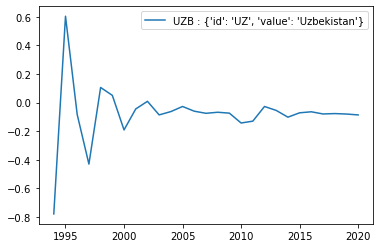

Country:  VCT


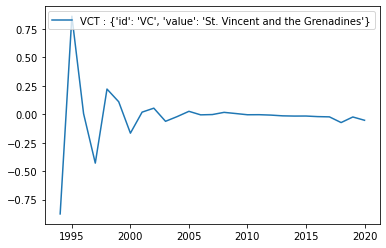

Country:  VEN


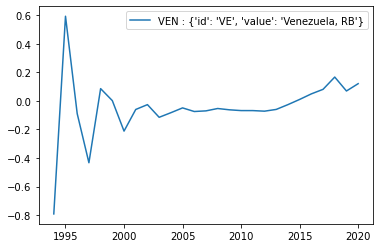

Country:  VGB


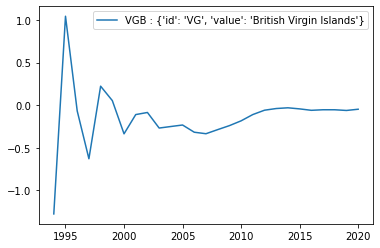

Country:  VIR


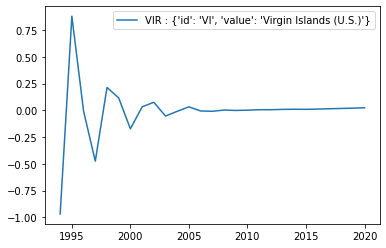

Country:  VNM


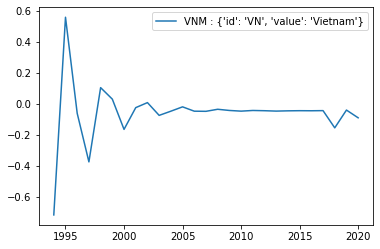

Country:  VUT


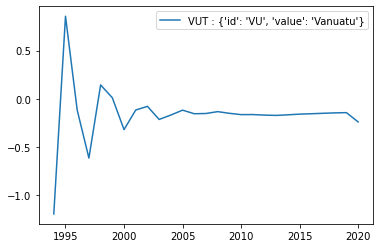

Country:  WLD


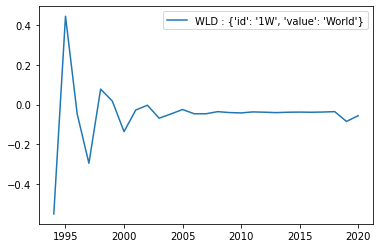

Country:  WSM


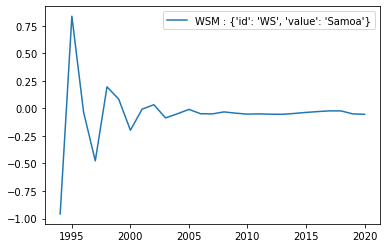

Country:  XKX


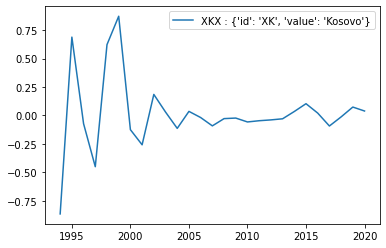

Country:  YEM


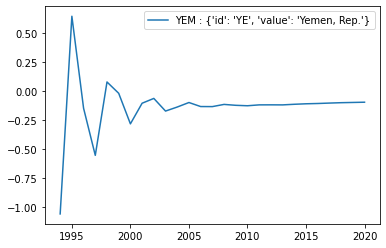

Country:  ZAF


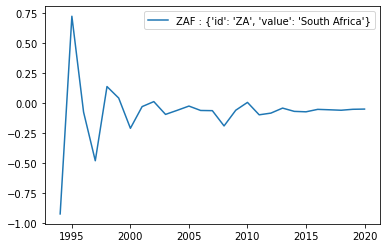

Country:  ZMB


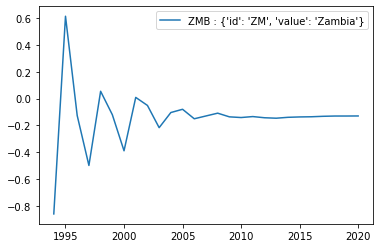

Country:  ZWE


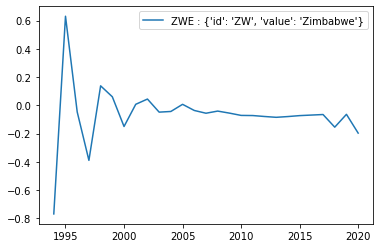

In [126]:
for country in countries: 
    
    x_adjustment = []
    y_adjustment = []
    delta_y_adjustment = []
    delta_y_adjustment_normal = []
    
    print('Country: ', country)
    if country != 'ERI' and country != 'KWT': 
        full_name_country = df[df['countryiso3code']==country]['country'].values[0]
        X = df_all.loc[country][['date', 'value_2', 'value_3', 'value_4']]
        Y = df_all.loc[country]['value_log']
    
    
        for j in range(len(X)-4):
            x1 = X[j:j+4]
            y1 = Y[j:j+4]
            #print('\n\n')
            #print('x1', x1)
            #print(y1)
            neigh = KNeighborsRegressor(n_neighbors=2)
            neigh.fit(x1.values, y1.values)
                   
            if len(delta_y_adjustment) >= 2: 
                adjustment = np.mean(delta_y_adjustment[-2:])
            elif len(delta_y_adjustment) == 1: 
                adjustment = delta_y_adjustment[0]
            else: 
                adjustment = 0.1
           
            X_to_predict = X[j+4:j+5]
            
            Y_to_predict_real = Y[j+4:j+5]
            Y_to_predict_fit = neigh.predict(X_to_predict.values.reshape(1,-1))  - adjustment
            #print()
            #print('X_to_predict: ', X_to_predict)
            #print(Y_to_predict_real) 
            #print(Y_to_predict_fit)
            x_adjustment.append(X[j+4:j+5]['date'])
            y_adjustment.append(Y_to_predict_fit)
            delta_y_adjustment.append(Y_to_predict_fit-Y_to_predict_real)
            delta_y_adjustment_normal.append((Y_to_predict_fit-Y_to_predict_real)*100/Y_to_predict_fit)
        #print(delta_y_adjustment)
        plt.plot(x_adjustment, delta_y_adjustment_normal, label = country + ' : ' + full_name_country)
        #plt.plot(x, y, label = country + ' : ' + full_name_country)
        #plt.yscale("log")
        plt.legend()
        plt.show()

        #plt.plot(x_adjustment, y_adjustment, label = country + ' : predict')
        #plt.plot(x, y, label = country + ' : ' + full_name_country)
        #plt.yscale("log")
        #plt.legend()
        #plt.show()

### Smoth the other features

In [119]:
def fit_funtion(x, parameters):
    return np.exp(parameters[1])*np.exp(x*parameters[0])

def fit_funtion_error(x, parameters):
    return parameters[0]*x*x + parameters[1]*x + parameters[2]

def fit_funtion_error_line(x, parameters):
    return parameters[0]*x + parameters[1]

In [120]:
total_countries_w_errros = []

In [12]:
# Under df_group, df_group_2, df_group_3, df_group_4

countries = df_group_4.index.get_level_values(0).unique()

for country in countries: 
    if country not in total_countries_w_errros: 
        full_name_country = df[df['countryiso3code']==country]['country'].values[0]

        try: 
            x = df_group_4[df_group_4['value']!=0].loc[country].index.tolist()
            y = df_group_4[df_group_4['value']!=0].loc[country].values.tolist()

            if all(v[0] == 0.0 for v in y): 
                print('all zero')
                print(x)
                print(y)
                print('-------------')
                continue

            x_adjustment = []
            y_adjustment = []
            delta_y_adjustment = []
            delta_y_adjustment_normal = []

            for j in range(len(x)-4):

                x1 = [x[i] for i in range(j,j+4)]
                y1 = [y[i] for i in range(j,j+4)]

                parameters, res, _, _, _  = np.polyfit(x1, np.log(y1), 1, full=True)

                if len(delta_y_adjustment) >= 2: 
                    adjustment = np.mean(delta_y_adjustment[-2:])
                elif len(delta_y_adjustment) == 1: 
                    adjustment = delta_y_adjustment[0]
                else: 
                    adjustment = 0.1

                y_predict = fit_funtion(x[j+4], parameters) - adjustment

                # print('x1 values: ', x1)
                # print('ano: ', x[j+4], 'predict: ', y_predict, 'real: ', y[j+4], 'diff: ', y_predict - y[j+4])

                x_adjustment.append(x[j+4])
                y_adjustment.append(y_predict)
                delta_y_adjustment.append(y_predict-y[j+4])
                delta_y_adjustment_normal.append(((y_predict-y[j+4])*100/y_predict)[0])

            #print(delta_y_adjustment)

            #plt.plot(x, y, label = country + ' : ' + full_name_country)
            #plt.yscale("log")



            x_error = x_adjustment[-15:]
            y_error = delta_y_adjustment_normal[-15:]
            parameters_error, res, _, _, _  = np.polyfit(x_error, y_error, 2, full=True)

            y_error_predict = [fit_funtion_error(i, parameters_error) for i in x_error]
            x_error_predict_extra = [float(i) for i in range(int(x_error[-1:][0]+1), 2026)]
            y_error_predict_extra = [fit_funtion_error(i, parameters_error) for i in x_error_predict_extra]

            #print('y_error_predict_extra', y_error_predict_extra)
            if np.abs(y_error_predict_extra[-1]) > 1.5: 
                #print()
                #print('EERRORES MUY ALTOS: ')
                x_error = x_adjustment[-15:]
                y_error = delta_y_adjustment_normal[-15:]
                parameters_error, res, _, _, _  = np.polyfit(x_error, y_error, 1, full=True)

                #print(parameters[1][0])
                #print()
                y_error_predict = [fit_funtion_error_line(i, parameters_error) for i in x_error]
                x_error_predict_extra = [float(i) for i in range(int(x_error[-1:][0]+1), 2026)]
                y_error_predict_extra = [fit_funtion_error_line(i, parameters_error) for i in x_error_predict_extra]



            for x_new in x_error_predict_extra:
                #print('ano new: ', x_new)

                adjustment = np.mean(delta_y_adjustment[-2:])
                y_predict = fit_funtion(x_new, parameters) - adjustment
                y_real = (1-y_error_predict_extra[0]/100)*y_predict
                delta_y_adjustment.append(y_predict-y_real)

                x.append(x_new)
                y.append(y_real)
                df_group_4.loc[(country, x_new), 'value'] = y_real
                x1 = x[-4:]
                y1 = y[-4:]
                parameters, res, _, _, _  = np.polyfit(x1, np.log(y1), 1, full=True)

            '''
            plt.plot(x_adjustment, delta_y_adjustment_normal, label = country + ' : ' + full_name_country)
            plt.plot(x_error, y_error_predict, color='red')
            plt.scatter(x_error_predict_extra, y_error_predict_extra, color='red')
            plt.hlines(-2, x_adjustment[0], x_error_predict_extra[-1], color = 'purple')
            plt.hlines(2, x_adjustment[0], x_error_predict_extra[-1], color = 'purple')
            plt.hlines(-1.5, x_adjustment[0], x_error_predict_extra[-1], color = 'green')
            plt.hlines(1.5, x_adjustment[0], x_error_predict_extra[-1], color = 'green')
            #plt.legend()
            plt.show()


            plt.plot(x, y, label = country + ' : ' + full_name_country, color='red')
            plt.plot(x_adjustment, y_adjustment, label = country + ' : ' + full_name_country)
            plt.legend()
            plt.show()
            '''

        except:
            print("An exception occurred with ", country) 
            total_countries_w_errros.append(country)
        


### El error se va a predecir utilizando líneas rectas (no promedio): MONTE CARLO últios 15 años 

In [492]:
print('Error in df_group_2')
total_countries_w_errros

Error in df_group_2


['AND',
 'ASM',
 'BMU',
 'CYM',
 'DMA',
 'FRO',
 'GIB',
 'GRL',
 'IMN',
 'KNA',
 'LIE',
 'MAF',
 'MCO',
 'MHL',
 'MNP',
 'NRU',
 'PLW',
 'SMR',
 'SXM',
 'TCA',
 'TUV',
 'VGB',
 'XKX']

In [494]:
print('Error in df_group_3')
total_countries_w_errros

Error in df_group_3


['AND',
 'ASM',
 'BMU',
 'CYM',
 'DMA',
 'FRO',
 'GIB',
 'GRL',
 'IMN',
 'KNA',
 'LIE',
 'MAF',
 'MCO',
 'MHL',
 'MNP',
 'NRU',
 'PLW',
 'SMR',
 'SXM',
 'TCA',
 'TUV',
 'VGB',
 'XKX',
 'ISL']

In [496]:
print('Error in df_group_4')
total_countries_w_errros

Error in df_group_4


['AND',
 'ASM',
 'BMU',
 'CYM',
 'DMA',
 'FRO',
 'GIB',
 'GRL',
 'IMN',
 'KNA',
 'LIE',
 'MAF',
 'MCO',
 'MHL',
 'MNP',
 'NRU',
 'PLW',
 'SMR',
 'SXM',
 'TCA',
 'TUV',
 'VGB',
 'XKX',
 'ISL']

In [13]:
df_all = df_group_1.merge(df_group_2, how='outer', 
                            on=['countryiso3code', 'date'], 
                            suffixes=('_1', '_2')
                           ).merge(df_group_3, how='outer', 
                            on=['countryiso3code', 'date']
                                  ).merge(df_group_4, how='outer', 
                                          on=['countryiso3code', 'date'], 
                                          suffixes=('_3', '_4')
                                         ).merge(df_group, how='outer',
                                                 on=['countryiso3code', 'date']
                                                )

df_all.reset_index(level=['date'], inplace=True)
df_all['value_log'] = np.log(df_all['value'])

# Column to save the data 
df_all['value_KNeighbors'] = df_all['value']
df_all.loc[df_all['date']>2020, 'value_KNeighbors'] = 0

/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/pandas/core/arraylike.py:358: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [14]:
df_all

,date,value_1,value_2,value_3,value_4,value,value_log,value_KNeighbors
countryiso3code,,,,,,,,
ABW,1990.0,0.0,143.482,90.078,2.249,6.215200e+04,11.037338,62152.0
ABW,1991.0,0.0,142.729,89.720,2.221,6.462300e+04,11.076326,64623.0
ABW,1992.0,14218.0,141.976,89.361,2.187,6.824000e+04,11.130786,68240.0
ABW,1993.0,0.0,141.725,89.007,2.149,7.249500e+04,11.191273,72495.0
ABW,1994.0,0.0,141.475,88.653,2.108,7.670500e+04,11.247722,76705.0
...,...,...,...,...,...,...,...,...
XKX,2021.0,NaN,NaN,NaN,NaN,1.776328e+06,14.390059,0.0
XKX,2022.0,NaN,NaN,NaN,NaN,1.749740e+06,14.374978,0.0
XKX,2023.0,NaN,NaN,NaN,NaN,1.728863e+06,14.362974,0.0


In [15]:
df_all['value_2_log'] = np.log(df_all['value_2'])
df_all['value_3_log'] = np.log(df_all['value_3'])
df_all['value_4_log'] = np.log(df_all['value_4'])

/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/pandas/core/arraylike.py:358: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [71]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn import linear_model

for country in countries:
    if country not in total_countries_w_errros: 
        if country != 'ERI' and country != 'KWT': 
            X = df_all[(df_all['date']<=2020) & (df_all['date']>=2015)].loc[country][['date', 'value_2', 'value_3', 'value_4']]
            Y = df_all[(df_all['date']<=2020) & (df_all['date']>=2015)].loc[country]['value']
            
            neigh = KNeighborsRegressor(n_neighbors=2)
            neigh = linear_model.Ridge(alpha=.5)
            neigh.fit(X.values, Y.values)
            
            X_to_predict = df_all.loc[country][['date', 'value_2', 'value_3', 'value_4']]
            Y_to_predict_fit = neigh.predict(X_to_predict.values)
            #print( df_all.loc[(df_all.index == country) & (df_all['date']>2020), 'value_KNeighbors'])
            
            #df_all.loc[(df_all.index == country) , 'value_KNeighbors']  = np.exp(Y_to_predict_fit)
            df_all.loc[(df_all.index == country) , 'value_KNeighbors']  = Y_to_predict_fit
            #print(df_all[df_all['date']>2020].loc[country]['value_KNeighbors'])
            #print(np.exp(Y_to_predict_fit).reshape(-1,1))
            
           
        

In [76]:
x_min = 2010
x_max = 2025
diff_porcentual = []
for country in countries:
    if country not in total_countries_w_errros: 
        x = df_all[df_all['date']>x_min]['date'].loc[country].values.tolist()
        y_1 = df_all[df_all['date']>x_min]['value'].loc[country].values.tolist()
        y_2 = df_all[df_all['date']>x_min]['value_KNeighbors'].loc[country].values.tolist()
        full_name_country = df[df['countryiso3code']==country]['country'].values[0]
        
        #plt.plot(x, y_1, label= full_name_country, color='red')
        #plt.plot(x, y_2, label='lineal model', color='blue')
        #plt.legend()
        
        if y_2[-1] != 0:
            if np.abs((y_2[-1]-y_1[-2])*100/y_2[-1]) > 20: 
                diff_porcentual.append((y_2[-1]-y_1[-2])*100/y_2[-1])
        
        #plt.xlim((2010, 2025))  
        #plt.yscale("log")
        #plt.show()

## MOnte Carlo to Incertitues

In [629]:
df = pd.read_csv('data/df.csv')
df_1 = pd.read_csv('data/df_1.csv')
df_2 = pd.read_csv('data/df_2.csv')
df_3 = pd.read_csv('data/df_3.csv')
df_4 = pd.read_csv('data/df_4.csv')

df_group = pd.read_csv('data/df_group.csv', index_col = ['countryiso3code', 'date'])
df_group_1 = pd.read_csv('data/df_group_1.csv', index_col = ['countryiso3code', 'date'])
df_group_2 = pd.read_csv('data/df_group_2.csv', index_col = ['countryiso3code', 'date'])
df_group_3 = pd.read_csv('data/df_group_3.csv', index_col = ['countryiso3code', 'date'])
df_group_4 = pd.read_csv('data/df_group_4.csv', index_col = ['countryiso3code', 'date'])

df_group_min_mean_max = df_group.copy()
df_group_2_min_mean_max = df_group_2.copy()
df_group_3_min_mean_max = df_group_3.copy()
df_group_4_min_mean_max = df_group_4.copy()

In [630]:
def fit_funtion(x, parameters):
    return np.exp(parameters[1])*np.exp(x*parameters[0])

def fit_funtion_error(x, parameters):
    return parameters[0]*x*x + parameters[1]*x + parameters[2]

def fit_funtion_error_line(x, parameters):
    return parameters[0]*x + parameters[1]

In [631]:
total_countries_w_errros = []

In [638]:
# Under df_group, df_group_2, df_group_3, df_group_4

countries = df_group.index.get_level_values(0).unique()

for country in countries: 
    if country not in total_countries_w_errros: 
        full_name_country = df[df['countryiso3code']==country]['country'].values[0]

        try: 
            x = df_group_4[df_group_4['value']!=0].loc[country].index.tolist()
            y = df_group_4[df_group_4['value']!=0].loc[country].values.tolist()
            
            x_min = x.copy()
            x_max = x.copy()
            y_min = y.copy()
            y_max = y.copy()
  
            if all(v[0] == 0.0 for v in y): 
                print('all zero')
                print(x)
                print(y)
                print('-------------')
                continue

            x_adjustment = []
            y_adjustment = []
            delta_y_adjustment = []
            delta_y_adjustment_normal = []

            for j in range(len(x)-4):

                x1 = [x[i] for i in range(j,j+4)]
                y1 = [y[i] for i in range(j,j+4)]

                parameters, res, _, _, _  = np.polyfit(x1, np.log(y1), 1, full=True)

                if len(delta_y_adjustment) >= 2: 
                    adjustment = np.mean(delta_y_adjustment[-2:])
                elif len(delta_y_adjustment) == 1: 
                    adjustment = delta_y_adjustment[0]
                else: 
                    adjustment = 0.1

                y_predict = fit_funtion(x[j+4], parameters) - adjustment

                # print('x1 values: ', x1)
                # print('ano: ', x[j+4], 'predict: ', y_predict, 'real: ', y[j+4], 'diff: ', y_predict - y[j+4])

                x_adjustment.append(x[j+4])
                y_adjustment.append(y_predict)
                delta_y_adjustment.append(y_predict-y[j+4])
                delta_y_adjustment_normal.append(((y_predict-y[j+4])*100/y_predict)[0])

            x_error_predict_extra = [float(i) for i in range(int(x_adjustment[-1]+1), 2026)]
            MonteCarlo = pd.DataFrame([], columns = x_error_predict_extra)
            
            total_range = [i for i in range(-20,-1)]
            
            for monteCarlo in range(100):
                random_index = np.sort(np.unique(random.sample(total_range,6)+[-1, -2]))

                x_error = [x_adjustment[i] for i in random_index]
                y_error = [delta_y_adjustment_normal[i] for i in random_index]
                parameters_error, res, _, _, _  = np.polyfit(x_error, y_error, 2, full=True)

                y_error_predict = [fit_funtion_error(i, parameters_error) for i in x_error]
                x_error_predict_extra = [float(i) for i in range(int(x_error[-1:][0]+1), 2026)]
                y_error_predict_extra = [fit_funtion_error(i, parameters_error) for i in x_error_predict_extra]

                #print('y_error_predict_extra', y_error_predict_extra)
                if np.abs(y_error_predict_extra[-1]) > 1.5: 

                    x_error = [x_adjustment[i] for i in random_index]
                    y_error = [delta_y_adjustment_normal[i] for i in random_index]
                    parameters_error, res, _, _, _  = np.polyfit(x_error, y_error, 1, full=True)
                    y_error_predict = [fit_funtion_error_line(i, parameters_error) for i in x_error]
                    x_error_predict_extra = [float(i) for i in range(int(x_error[-1:][0]+1), 2026)]
                    y_error_predict_extra = [fit_funtion_error_line(i, parameters_error) for i in x_error_predict_extra]
                
                MonteCarlo = MonteCarlo.append(pd.DataFrame(np.array(y_error_predict_extra).reshape(-1,len(y_error_predict_extra)), 
                                                            columns = x_error_predict_extra))
                # plt.scatter(x_error_predict_extra, y_error_predict_extra, color='red', alpha = 0.004 )
            '''
            plt.plot(x_adjustment, delta_y_adjustment_normal, label = country + ' : ' + full_name_country)
            plt.plot(x_error, y_error_predict, color='red')  
            plt.hlines(-2, x_adjustment[0], x_error_predict_extra[-1], color = 'purple')
            plt.hlines(2, x_adjustment[0], x_error_predict_extra[-1], color = 'purple')
            plt.hlines(-1.5, x_adjustment[0], x_error_predict_extra[-1], color = 'green')
            plt.hlines(1.5, x_adjustment[0], x_error_predict_extra[-1], color = 'green')
            plt.show()
            '''
            delta_y_adjustment_max = delta_y_adjustment.copy()
            delta_y_adjustment_min = delta_y_adjustment.copy()
            parameters_min = parameters.copy()
            parameters_max = parameters.copy()
            for j, x_new in enumerate(x_error_predict_extra):

                MonteCarloMin = MonteCarlo[x_new].min()
                
                adjustment_min = np.mean(delta_y_adjustment_min[-2:])
                y_predict_min = fit_funtion(x_new, parameters_min) - adjustment_min
                y_real_min = (1-MonteCarloMin/100)*y_predict_min
                delta_y_adjustment_min.append(y_predict_min-y_real_min)
                x_min.append(x_new)
                y_min.append(y_real_min)
                df_group_4_min_mean_max.loc[(country, x_new), 'value_min'] = y_real_min
                x1_min = x_min[-4:]
                y1_min = y_min[-4:]
                parameters_min, res, _, _, _  = np.polyfit(x1_min, np.log(y1_min), 1, full=True)
                
                
                MonteCarloMean = MonteCarlo[x_new].mean()
                
                adjustment = np.mean(delta_y_adjustment[-2:])
                y_predict = fit_funtion(x_new, parameters) - adjustment
                y_real = (1-MonteCarloMean/100)*y_predict
                delta_y_adjustment.append(y_predict-y_real)
                
                x.append(x_new)
                y.append(y_real)
                df_group_4.loc[(country, x_new), 'value'] = y_real
                df_group_4_min_mean_max.loc[(country, x_new), 'value'] = y_real
                
                x1 = x[-4:]
                y1 = y[-4:]
                parameters, res, _, _, _  = np.polyfit(x1, np.log(y1), 1, full=True)
                
                
                MonteCarloMax = MonteCarlo[x_new].max()
                
                adjustment_max = np.mean(delta_y_adjustment_max[-2:])
                y_predict_max = fit_funtion(x_new, parameters_max) - adjustment_max
                y_real_max = (1-MonteCarloMax/100)*y_predict_max
                delta_y_adjustment_max.append(y_predict_max-y_real_max)
                x_max.append(x_new)
                y_max.append(y_real_max)
                df_group_4_min_mean_max.loc[(country, x_new), 'value_max'] = y_real_max
                x1_max = x_max[-4:]
                y1_max = y_max[-4:]
                parameters_max, res, _, _, _  = np.polyfit(x1_max, np.log(y1_max), 1, full=True)
                
                
            '''
            plt.plot(x, y, label = country + ' : ' + full_name_country, color='red')
            plt.plot(x_min, y_min, label = country + ' : ' + full_name_country, color='red', linestyle='dashed', alpha = 0.6)
            plt.plot(x_max, y_max, label = country + ' : ' + full_name_country, color='red', linestyle='dashed', alpha = 0.6)
            plt.plot(x_adjustment, y_adjustment, label = country + ' : ' + full_name_country)
            plt.legend()
            plt.show()
            '''
        except:
            print("An exception occurred with ", country) 
            total_countries_w_errros.append(country)
        



An exception occurred with  CUW


<ipython-input-630-b9ef55146f98>:2: RuntimeWarning: overflow encountered in exp
  return np.exp(parameters[1])*np.exp(x*parameters[0])
<ipython-input-630-b9ef55146f98>:2: RuntimeWarning: invalid value encountered in multiply
  return np.exp(parameters[1])*np.exp(x*parameters[0])


An exception occurred with  MLT


<ipython-input-630-b9ef55146f98>:2: RuntimeWarning: overflow encountered in exp
  return np.exp(parameters[1])*np.exp(x*parameters[0])
<ipython-input-630-b9ef55146f98>:2: RuntimeWarning: invalid value encountered in multiply
  return np.exp(parameters[1])*np.exp(x*parameters[0])


An exception occurred with  POL
An exception occurred with  SRB


In [635]:
len(total_countries_w_errros) # Due _2

37

In [637]:
len(total_countries_w_errros) # Due _3 

42

In [639]:
len(total_countries_w_errros) # Due _4

46

In [640]:
df_group_min_mean_max.to_csv('data/df_group_min_mean_max.csv', index=True)
df_group_2_min_mean_max.to_csv('data/df_group_min_mean_max_2.csv', index=True)
df_group_3_min_mean_max.to_csv('data/df_group_min_mean_max_3.csv', index=True)
df_group_4_min_mean_max.to_csv('data/df_group_min_mean_max_4.csv', index=True)

## Read CSV

In [2]:
df_group_min_mean_max = pd.read_csv('data/df_group_min_mean_max.csv')
df_group_2_min_mean_max = pd.read_csv('data/df_group_min_mean_max_2.csv')
df_group_3_min_mean_max = pd.read_csv('data/df_group_min_mean_max_3.csv')
df_group_4_min_mean_max = pd.read_csv('data/df_group_min_mean_max_4.csv')

df_group_min_mean_max.loc[df_group_min_mean_max['value_min'].isnull(), 'value_min'] = df_group_min_mean_max.loc[df_group_min_mean_max['value_min'].isnull(), 'value']
df_group_min_mean_max.loc[df_group_min_mean_max['value_max'].isnull(), 'value_max'] = df_group_min_mean_max.loc[df_group_min_mean_max['value_max'].isnull(), 'value']

df_group_2_min_mean_max.loc[df_group_2_min_mean_max['value_min'].isnull(), 'value_min'] = df_group_2_min_mean_max.loc[df_group_2_min_mean_max['value_min'].isnull(), 'value']
df_group_2_min_mean_max.loc[df_group_2_min_mean_max['value_max'].isnull(), 'value_max'] = df_group_2_min_mean_max.loc[df_group_2_min_mean_max['value_max'].isnull(), 'value']

df_group_3_min_mean_max.loc[df_group_3_min_mean_max['value_min'].isnull(), 'value_min'] = df_group_3_min_mean_max.loc[df_group_3_min_mean_max['value_min'].isnull(), 'value']
df_group_3_min_mean_max.loc[df_group_3_min_mean_max['value_max'].isnull(), 'value_max'] = df_group_3_min_mean_max.loc[df_group_3_min_mean_max['value_max'].isnull(), 'value']

df_group_4_min_mean_max.loc[df_group_4_min_mean_max['value_min'].isnull(), 'value_min'] = df_group_4_min_mean_max.loc[df_group_4_min_mean_max['value_min'].isnull(), 'value']
df_group_4_min_mean_max.loc[df_group_4_min_mean_max['value_max'].isnull(), 'value_max'] = df_group_4_min_mean_max.loc[df_group_4_min_mean_max['value_max'].isnull(), 'value']





In [3]:
df_all = df_group_2_min_mean_max.merge(df_group_3_min_mean_max, how='outer', 
                            on=['countryiso3code', 'date'], suffixes=('_2', '_3')
                                  ).merge(df_group_4_min_mean_max, how='outer', 
                                          on=['countryiso3code', 'date']
                                         ).merge(df_group_min_mean_max, how='outer',
                                                 on=['countryiso3code', 'date'], suffixes=('_4', '_0')
                                                )

#df_all.reset_index(level=['date'], inplace=True)
#df_all['value_log'] = np.log(df_all['value'])

# Column to save the data 
#df_all['value_KNeighbors'] = df_all['value']
#df_all.loc[df_all['date']>2020, 'value_KNeighbors'] = 0

In [4]:
df_all['value_2_log'] = np.log(df_all['value_2'])
df_all['value_3_log'] = np.log(df_all['value_3'])
df_all['value_4_log'] = np.log(df_all['value_4'])
df_all['value_0_log'] = np.log(df_all['value_0'])

/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/pandas/core/arraylike.py:358: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [6]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn import linear_model

countries = df_all['countryiso3code'].unique()

df_all['value_KNeighbors'] = df_all['value_0'].copy()
df_all['value_KNeighbors_min'] = df_all['value_0'].copy()
df_all['value_KNeighbors_max'] = df_all['value_0'].copy()

total_countries_w_errros = []

for country in countries:
    try: 
        if country not in total_countries_w_errros: 
            if country != 'ERI' and country != 'KWT' and country != 'CPV' and country != 'GNB': 
                X = df_all[(df_all['date']<=2020) & (df_all['date']>=2015) & (df_all['countryiso3code'] == country)][['date', 'value_2', 'value_3', 'value_4']]
                Y = df_all[(df_all['date']<=2020) & (df_all['date']>=2015) & (df_all['countryiso3code'] == country)]['value_0']

                neigh = KNeighborsRegressor(n_neighbors=2)
                neigh = linear_model.Ridge(alpha=.5)
                neigh.fit(X.values, Y.values)

                X_to_predict = df_all[df_all['countryiso3code'] == country][['date', 'value_2', 'value_3', 'value_4']]
                Y_to_predict_fit = neigh.predict(X_to_predict.values)
                df_all.loc[df_all['countryiso3code'] == country, 'value_KNeighbors'] = Y_to_predict_fit

                X_to_predict = df_all[(df_all['countryiso3code'] == country)][['date', 'value_min_2', 'value_min_3', 'value_min_4']]
                Y_to_predict_fit = neigh.predict(X_to_predict.values)
                df_all.loc[df_all['countryiso3code'] == country, 'value_KNeighbors_min'] = Y_to_predict_fit

                X_to_predict = df_all[(df_all['countryiso3code'] == country) ][['date', 'value_max_2', 'value_max_3', 'value_max_4']]
                Y_to_predict_fit = neigh.predict(X_to_predict.values)
                df_all.loc[df_all['countryiso3code'] == country, 'value_KNeighbors_max'] = Y_to_predict_fit

    except:
            print("An exception occurred with ", country) 
            total_countries_w_errros.append(country)
        
            
            #df_all.loc[(df_all.index == country) , 'value_KNeighbors']  = np.exp(Y_to_predict_fit)
            #df_all.loc[ (df_all['date']==X_to_predict) & (df_all['countryiso3code'] == country), 'value_KNeighbors']  = Y_to_predict_fit
         
            
           
        

An exception occurred with  AND
An exception occurred with  ASM
An exception occurred with  AUT
An exception occurred with  BLR
An exception occurred with  BMU
An exception occurred with  BRN
An exception occurred with  CUW
An exception occurred with  CYM
An exception occurred with  DMA
An exception occurred with  ECS
An exception occurred with  EST
An exception occurred with  FJI
An exception occurred with  FRO
An exception occurred with  GIB
An exception occurred with  GRL
An exception occurred with  IMN
An exception occurred with  IRL
An exception occurred with  ISL
An exception occurred with  ISR
An exception occurred with  KNA
An exception occurred with  LIE
An exception occurred with  LUX
An exception occurred with  LVA
An exception occurred with  MAF
An exception occurred with  MCO
An exception occurred with  MEX
An exception occurred with  MHL
An exception occurred with  MNP
An exception occurred with  NRU
An exception occurred with  NZL
An exception occurred with  PLW
An excep

In [7]:
total_countries_w_errros.append(['CPV', 'GNB'])

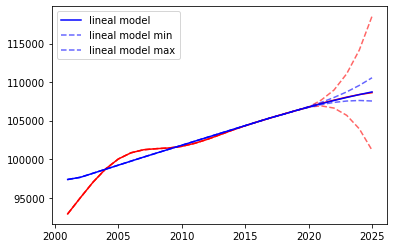

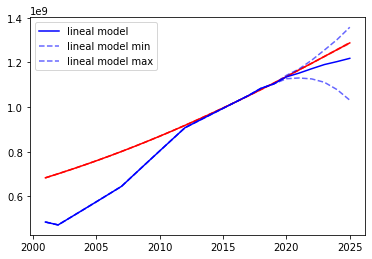

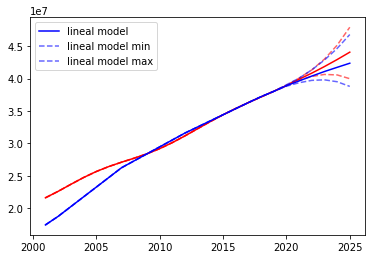

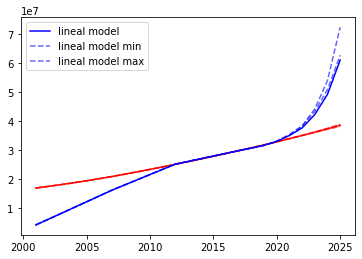

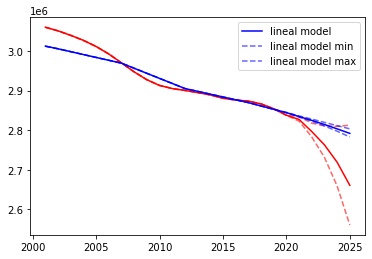

...

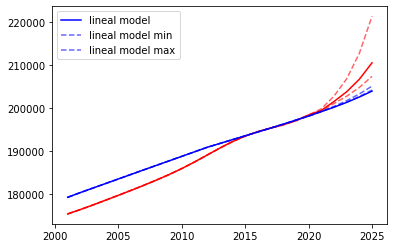

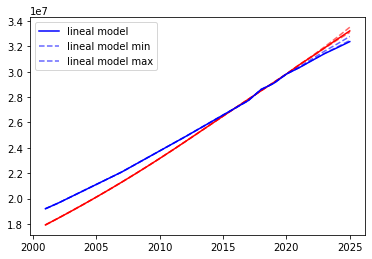

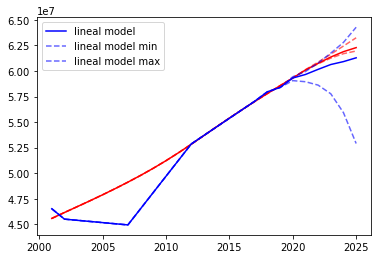

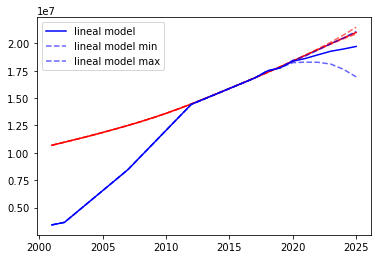

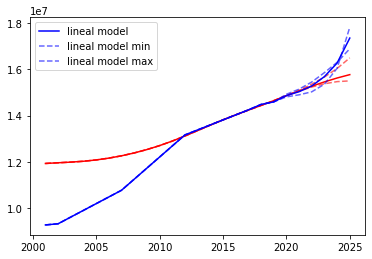

In [10]:
x_min = 2000
x_max = 2025
diff_porcentual = []

for country in countries:
    if country not in total_countries_w_errros: 
        x = df_all[ (df_all['date']>x_min) & (df_all['countryiso3code'] == country) ]['date']
        y_1 = df_all[(df_all['date']>x_min)& (df_all['countryiso3code'] == country)]['value_0']
        y_1_min = df_all[(df_all['date']>x_min)& (df_all['countryiso3code'] == country)]['value_min_0']
        y_1_max = df_all[(df_all['date']>x_min)& (df_all['countryiso3code'] == country)]['value_max_0']
        
        y_2 = df_all[(df_all['date']>x_min) & (df_all['countryiso3code'] == country)]['value_KNeighbors']
        y_2_min = df_all[(df_all['date']>x_min) & (df_all['countryiso3code'] == country)]['value_KNeighbors_min']
        y_2_max = df_all[(df_all['date']>x_min) & (df_all['countryiso3code'] == country)]['value_KNeighbors_max']
        #full_name_country = df[df['countryiso3code']==country]['country'].values[0]
        
        plt.plot(x, y_1, color='red')
        plt.plot(x, y_1_min, color='red', linestyle='dashed', alpha = 0.6)
        plt.plot(x, y_1_max, color='red', linestyle='dashed', alpha = 0.6)
        
        plt.plot(x, y_2, label='lineal model', color='blue')
        plt.plot(x, y_2_min, label='lineal model min', color='blue', linestyle='dashed', alpha = 0.6)
        plt.plot(x, y_2_max, label='lineal model max', color='blue', linestyle='dashed', alpha = 0.6)
        plt.legend()
        plt.show()

        if y_2.values[-1] != 0:
            if np.abs((y_2.values[-1]-y_1.values[-2])*100/y_2.values[-1]) < 20: 
                diff_porcentual.append((y_2.values[-1]-y_1.values[-2])*100/y_2.values[-1])

In [770]:
df_all

,countryiso3code,date,value_2,value_min_2,value_max_2,value_3,value_min_3,value_max_3,value_4,value_min_4,value_max_4,value_0,value_min_0,value_max_0,value_KNeighbors,value_KNeighbors_min,value_KNeighbors_max
0,ABW,1990.0,143.482,143.482,143.482,90.078,90.078,90.078,2.249,2.249,2.249,6.215200e+04,6.215200e+04,6.215200e+04,9.470015e+04,9.470015e+04,9.470015e+04
1,ABW,1991.0,142.729,142.729,142.729,89.720,89.720,89.720,2.221,2.221,2.221,6.462300e+04,6.462300e+04,6.462300e+04,9.498024e+04,9.498024e+04,9.498024e+04
2,ABW,1992.0,141.976,141.976,141.976,89.361,89.361,89.361,2.187,2.187,2.187,6.824000e+04,6.824000e+04,6.824000e+04,9.526044e+04,9.526044e+04,9.526044e+04
3,ABW,1993.0,141.725,141.725,141.725,89.007,89.007,89.007,2.149,2.149,2.149,7.249500e+04,7.249500e+04,7.249500e+04,9.545403e+04,9.545403e+04,9.545403e+04
4,ABW,1994.0,141.475,141.475,141.475,88.653,88.653,88.653,2.108,2.108,2.108,7.670500e+04,7.670500e+04,7.670500e+04,9.564744e+04,9.564744e+04,9.564744e+04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9350,XKX,2021.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.764898e+06,1.789281e+06,1.721299e+06,1.764898e+06,1.764898e+06,1.764898e+06
9351,XKX,2022.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.719663e+06,1.785333e+06,1.608551e+06,1.719663e+06,1.719663e+06,1.719663e+06
9352,XKX,2023.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.666855e+06,1.806286e+06,1.446559e+06,1.666855e+06,1.666855e+06,1.666855e+06
9353,XKX,2024.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.597106e+06,1.841891e+06,1.246414e+06,1.597106e+06,1.597106e+06,1.597106e+06


In [753]:
X_to_predict

,date,value_min_2,value_min_3,value_min_4
1426,1990.0,235.181000,188.320000,5.392000
1427,1991.0,231.542000,184.963000,5.259000
1428,1992.0,227.904000,181.606000,5.102000
1429,1993.0,222.764000,176.931000,4.921000
1430,1994.0,217.623000,172.256000,4.720000
1431,1995.0,212.482000,167.581000,4.505000
1432,1996.0,207.342000,162.906000,4.287000
1433,1997.0,202.201000,158.230000,4.074000
1434,1998.0,194.184000,150.840000,3.876000
1435,1999.0,186.167000,143.449000,3.697000


In [755]:
country

'CPV'

In [723]:
df_group_min_mean_max.loc[df_group_min_mean_max['value_min'].isnull(), 'value']

0          62152.0
1          64623.0
2          68240.0
3          72495.0
4          76705.0
           ...    
8055    14030338.0
8056    14236599.0
8057    14438812.0
8058    14645473.0
8059    14862927.0
Name: value, Length: 8060, dtype: float64

In [758]:
country

'GNB'